In [87]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from nltk.tokenize import RegexpTokenizer
from nltk import FreqDist
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import cross_val_score
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer
from nltk.tokenize import sent_tokenize
import scipy as sp
from sklearn.metrics import plot_confusion_matrix
from sklearn.datasets import make_classification
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import LabelEncoder
from gensim.models import word2vec
from nltk import word_tokenize
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from scipy.sparse import csr_matrix
import json
from collections import Counter
from keras.preprocessing.text import Tokenizer
import pickle
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential
from keras.layers import Dropout, Activation, Bidirectional, GlobalMaxPool1D, Input, Dense, LSTM, Embedding
import lime
import sklearn
import sklearn.ensemble
import sklearn.metrics
from sklearn.pipeline import make_pipeline
import shap
shap.initjs()

In [192]:
labels_nn=['artanddesign', 'australia-news', 'books', 'business', 'culture', 'education', 'environment',
        'film', 'food', 'football', 'lifeandstyle', 'media', 'money', 'music', 'politics', 'science',
        'society', 'sport', 'stage', 'technology', 'tv-and-radio', 'uk-news', 'us-news', 'world']

In [297]:
def make_confusion_matrix(model, X, y, model_type):
    base_predictions = model.predict(X)
    cm = confusion_matrix(y, base_predictions)
    cmp = ConfusionMatrixDisplay(confusion_matrix=cm, 
                              display_labels=labels_nn)
    x_list = labels_nn
    fig, ax = plt.subplots(figsize=(20,20))
    ax.yaxis.set_ticklabels(x_list, fontsize=20);
    ax.xaxis.set_ticklabels(x_list, rotation=45, fontsize=20);
    cmp.plot(ax=ax, xticks_rotation='vertical')
    plt.savefig(f"Viz/{model_type}.png")


In [31]:
def stem_and_tokenize(document):
    tokens = tokenizer.tokenize(document)
    return [stemmer.stem(token) for token in tokens]

In [32]:
def remove_stopwords(token_list):
    stopwords_removed = [token for token in token_list if token not in stopwords_list]
    return stopwords_removed

In [4]:
X250_train = pd.read_csv('data/X250_train_full.csv')

In [117]:
X250_test = pd.read_csv('data/X250_test_full.csv')

In [13]:
y250_train = pd.read_csv('data/y250_train_full.csv')

In [14]:
y250_test = pd.read_csv('data/y250_test_full.csv')

In [2]:
loader = np.load('data/tfidf250_stem_final.npz')
X250_train_vector_final = csr_matrix((loader['data'], loader['indices'], loader['indptr']),
                      shape=loader['shape'])

In [3]:
loader_test = np.load('data/test_stem_final.npz')
X250_test_vector_final = csr_matrix((loader_test['data'], loader_test['indices'], loader_test['indptr']),
                      shape=loader_test['shape'])

# Make tfidf vector/baseline model

In [7]:
tfidf_base = TfidfVectorizer(max_features=1000)
X250_train_vector_base = tfidf_base.fit_transform(X250_train["bodyText"])

# Visually inspect the vectorized data
pd.DataFrame.sparse.from_spmatrix(X250_train_vector_base, columns=tfidf_base.get_feature_names())

,000,10,100,11,12,13,14,15,16,17,...,wrong,wrote,year,years,yes,yet,york,you,young,your
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.034202,0.000000,0.0,0.0,...,0.000000,0.00000,0.016347,0.018123,0.0,0.00000,0.139066,0.050603,0.000000,0.000000
1,0.022295,0.043382,0.000000,0.000000,0.000000,0.0,0.000000,0.027607,0.0,0.0,...,0.000000,0.00000,0.014660,0.032504,0.0,0.00000,0.000000,0.000000,0.100095,0.000000
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,...,0.000000,0.00000,0.000000,0.000000,0.0,0.00000,0.000000,0.321290,0.000000,0.464400
3,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,...,0.000000,0.00000,0.043488,0.000000,0.0,0.00000,0.000000,0.000000,0.000000,0.000000
4,0.000000,0.000000,0.000000,0.034400,0.031699,0.0,0.035825,0.000000,0.0,0.0,...,0.072842,0.00000,0.000000,0.075930,0.0,0.00000,0.000000,0.070673,0.000000,0.025538
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,0.099993,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,...,0.000000,0.00000,0.043834,0.024297,0.0,0.00000,0.000000,0.000000,0.000000,0.000000
199996,0.000000,0.000000,0.000000,0.010885,0.000000,0.0,0.000000,0.000000,0.0,0.0,...,0.011525,0.00000,0.010836,0.018020,0.0,0.02535,0.023047,0.301902,0.000000,0.040405
199997,0.029298,0.057011,0.039851,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,...,0.000000,0.00000,0.000000,0.000000,0.0,0.00000,0.040973,0.059637,0.000000,0.000000
199998,0.000000,0.012502,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,...,0.017972,0.00000,0.016899,0.037468,0.0,0.00000,0.017970,0.078467,0.028845,0.025204


In [22]:
# Instantiate a MultinomialNB classifier
baseline_model = MultinomialNB()


In [ ]:
# Evaluate the classifier on X_train_vectorized and y_train
baseline_cv = cross_val_score(baseline_model, X250_train_vector_base, y250_train['sectionId'])
baseline_cv

# Stopword/stemmed

In [22]:
stopwords_list = stopwords.words('english')

In [23]:
basic_token_pattern = r"(?u)\b\w\w+\b"
tokenizer = RegexpTokenizer(basic_token_pattern)

In [24]:
stemmer = SnowballStemmer(language="english")

In [25]:
stemmed_stopwords = [stemmer.stem(word) for word in stopwords_list]

In [30]:
tfidf250_stem = TfidfVectorizer(
    max_features=1000,
    stop_words=stemmed_stopwords,
    tokenizer=stem_and_tokenize
)

# Fit the vectorizer on X_train["text"] and transform it
X250_train_vector_stem = tfidf250_stem.fit_transform(X250_train["bodyText"])

NameError: name 'stem_and_tokenize' is not defined

In [ ]:
stemmed250_cv = cross_val_score(baseline_model, X250_train_vector_stem, y250_train['sectionId'])
stemmed250_cv

## final model

### Can preload vector and ignore following code

In [74]:
tfidf250_stem_final = TfidfVectorizer(
    max_features=2000,
    stop_words=stemmed_stopwords,
    tokenizer=stem_and_tokenize)

X250_train_vector_stem_final = tfidf250_stem_final.fit_transform(X250_train["bodyText"])

NameError: name 'stemmed_stopwords' is not defined

In [73]:
X250_test_vector_final = tfidf250_stem_final.transform(X250_test["bodyText"])

NameError: name 'tfidf250_stem_final' is not defined

In [ ]:
np.savez('data/tfidf250_stem_final', data=X250_train_vector_stem_final.data, 
         indices=X250_train_vector_stem_final.indices,
         indptr=X250_train_vector_stem_final.indptr, 
         shape=X250_train_vector_stem_final.shape)

In [ ]:
np.savez('data/test_stem_final', data=X250_test_vector_final.data, 
         indices=X250_test_vector_final.indices,
         indptr=X250_test_vector_final.indptr, 
         shape=X250_test_vector_final.shape)

### Make model

In [ ]:
nb_model = MultinomialNB()

In [28]:
sentsize250_final = cross_val_score(nb_model, X250_train_vector_final, y250_train['sectionId'])
sentsize250_final

array([0.725925, 0.7236  , 0.725225, 0.72505 , 0.72655 ])

In [23]:
nb_model = MultinomialNB()
nb_model.fit(X250_train_vector_final, y250_train['sectionId'])
nb_model.score(X250_train_vector_final, y250_train['sectionId'])

0.72873

In [26]:
nb_model.score(X250_test_vector_final, y250_test['sectionId'])

0.72214

<ipython-input-2-979cc80c55c4>:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.xaxis.set_ticklabels(x_list, rotation=45);


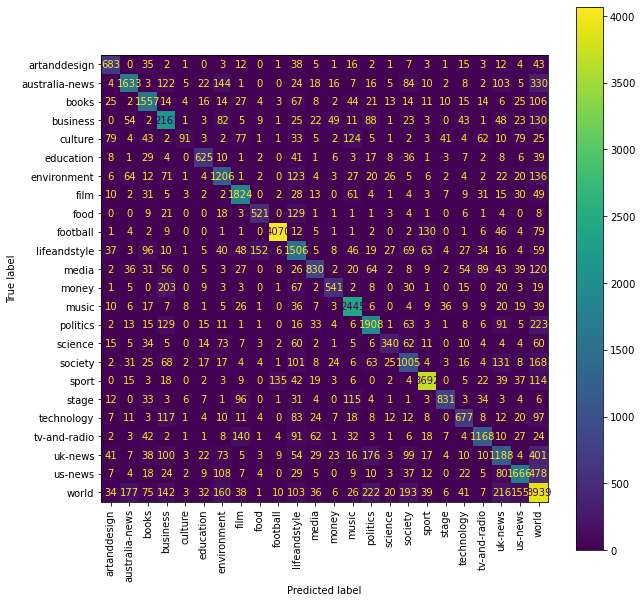

In [27]:
make_confusion_matrix(nb_model, X250_test_vector_final, y250_test['sectionId'])

# Other models

## Logistic

In [6]:
with open('data/lr_model.pkl', 'rb') as inp:
    lr_model = pickle.load(inp)

### Make/fit model

In [60]:
lr_model = LogisticRegression(C=3, solver='liblinear')
lr_model.fit(X250_train_vector_final, y250_train['sectionId'])
lr_model.score(X250_train_vector_final, y250_train['sectionId'])

0.816195

In [61]:
lr_model.score(X250_test_vector_final, y250_test['sectionId'])

0.78934

<ipython-input-297-6689025c27ea>:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.yaxis.set_ticklabels(x_list, fontsize=20);
<ipython-input-297-6689025c27ea>:9: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.xaxis.set_ticklabels(x_list, rotation=45, fontsize=20);


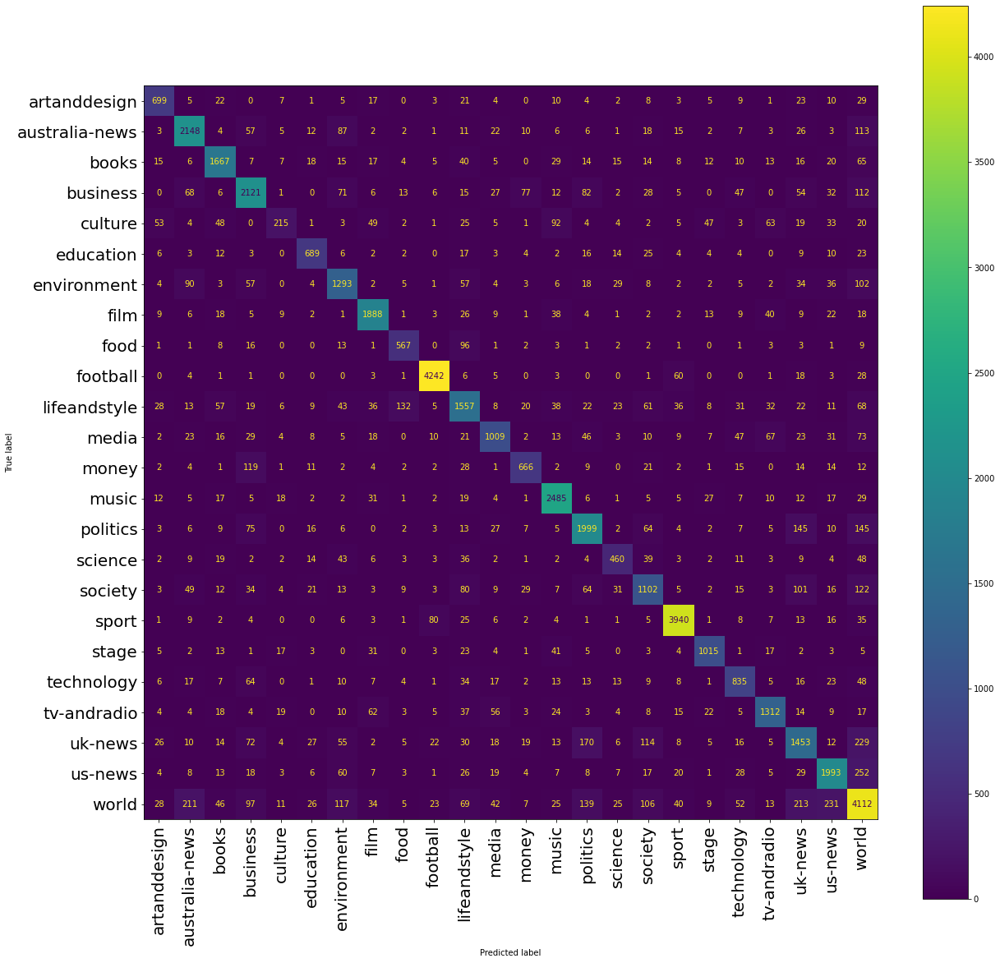

In [298]:
make_confusion_matrix(lr_model, X250_test_vector_final, y250_test['sectionId'], 'log_res')

#### save model

In [121]:
with open('data/lr_model.pkl', 'wb') as file:
    pickle.dump(lr_model, file)


### LIME analysis on individual samples

#### open files and reconstruct vectorizer


In [33]:
with open('data/final_vectorizer.pk', 'rb') as inp:
    vector_lime = pickle.load(inp)

#### Make vectorizer and save

In [29]:
vectorizer = TfidfVectorizer(max_features=2000,
                             stop_words=stemmed_stopwords,
                             tokenizer=stem_and_tokenize)

NameError: name 'stem_and_tokenize' is not defined

In [97]:
vectorizer.fit_transform(X250_train["bodyText"])

<200000x2000 sparse matrix of type '<class 'numpy.float64'>'
	with 37133277 stored elements in Compressed Sparse Row format>

In [287]:
with open('data/final_vectorizer.pk', 'wb') as fin:
    pickle.dump(vectorizer, fin)

#### lime analysis

In [289]:
c = make_pipeline(vector_lime, lr_model)

In [234]:
from lime.lime_text import LimeTextExplainer
explainer = LimeTextExplainer(class_names=labels_nn)

In [235]:
index_list_10 =[25, 7, 5, 2, 17, 30, 34, 63, 1, 0]
lab=[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]
top_ten={'world': 23, 'football': 9, 'sport': 17, 'music': 13, 'australia-news': 1,
         'business': 3, 'politics': 14, 'us-news': 22, 'film': 7, 'books':2}
class_names=labels_nn

In [290]:
for ind in index_list_10:
    exp = explainer.explain_instance(X250_test.loc[ind, 'join_nostop'], c.predict_proba, num_features=6, top_labels=1)
    exp.show_in_notebook(text=False)

### SHAP analysis across many samples

In [ ]:
# open saved final vectorizer
with open('data/final_vectorizer.pk', 'rb') as inp:
    vector_lime = pickle.load(inp)

In [51]:
# get words from idfd vectorizer and sort
cols=sorted(list(vector_lime.vocabulary_.keys()))

['000',
 '10',
 '100',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '18',
 '19',
 '20',
 '200',
 '2007',
 '2008',
 '2009',
 '2010',
 '2011',
 '2012',
 '2013',
 '2014',
 '2015',
 '2016',
 '2017',
 '2018',
 '2019',
 '2020',
 '21',
 '22',
 '23',
 '24',
 '25',
 '26',
 '27',
 '28',
 '29',
 '30',
 '300',
 '31',
 '35',
 '40',
 '45',
 '50',
 '500',
 '60',
 '70',
 '80',
 '90',
 '99',
 'abandon',
 'abbott',
 'abc',
 'abil',
 'abl',
 'absolut',
 'abus',
 'academ',
 'academi',
 'accept',
 'access',
 'accord',
 'account',
 'accus',
 'achiev',
 'acknowledg',
 'across',
 'act',
 'action',
 'activ',
 'activist',
 'actor',
 'actual',
 'ad',
 'adam',
 'adapt',
 'add',
 'addit',
 'address',
 'administr',
 'admit',
 'adopt',
 'adult',
 'advanc',
 'advantag',
 'advertis',
 'advic',
 'advis',
 'affair',
 'affect',
 'afford',
 'africa',
 'african',
 'afternoon',
 'age',
 'agenc',
 'agent',
 'aggress',
 'ago',
 'agre',
 'agreement',
 'ahead',
 'aid',
 'aim',
 'air',
 'airport',
 'al',
 'album',
 'alcohol

In [57]:
# make sparse final vector into pd dataframe with words as col titles
shap_train_df = pd.DataFrame(X250_train_vector_final.toarray(), columns = cols)
shap_test_df = pd.DataFrame(X250_test_vector_final.toarray(), columns = cols)

In [307]:
# make SHAP explainer object  on 10k records in test set
masker_log = shap.maskers.Independent(data=shap_train_df)
explainer_log = shap.LinearExplainer(lr_model, masker=masker_log)
shap_val = explainer_log(shap_test_df[0:10000])

In [308]:
shap_val_3d = shap_val.values

In [311]:
cat_ind_map={}
num_cats_pred = {}
mean_shap_cat = {}
for cat in labels_nn:
    cat_ind_map[cat] = labels_nn.index(cat)
    num_cats_pred[cat] = 0
    mean_shap_cat[cat] = np.zeros(2000)

In [318]:
row_idx=0
for record in shap_val_3d:
    pred_result = lr_model.predict(X250_test_vector_final[row_idx])[0]
    num_cats_pred[pred_result] +=1
    cat_index = cat_ind_map[pred_result]  
    selected_cat = rec[ :, cat_index]
    mean_shap_cat[pred_result] += selected_cat
    row_idx+=1   

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061
2062
2063
2064
2065
2066
2067
2068
2069
2070
2071
2072
2073
2074
2075
2076
2077
2078
2079
2080
2081
2082
2083
2084
2085
2086
2087
2088
2089
2090
2091
2092
2093
2094
2095
2096
2097
2098
2099
2100
2101
2102
2103
2104
2105
2106
2107
2108
2109
2110
2111
2112
2113
2114
2115
2116
2117
2118
2119
2120
2121
2122
2123
2124
2125
2126


3765
3766
3767
3768
3769
3770
3771
3772
3773
3774
3775
3776
3777
3778
3779
3780
3781
3782
3783
3784
3785
3786
3787
3788
3789
3790
3791
3792
3793
3794
3795
3796
3797
3798
3799
3800
3801
3802
3803
3804
3805
3806
3807
3808
3809
3810
3811
3812
3813
3814
3815
3816
3817
3818
3819
3820
3821
3822
3823
3824
3825
3826
3827
3828
3829
3830
3831
3832
3833
3834
3835
3836
3837
3838
3839
3840
3841
3842
3843
3844
3845
3846
3847
3848
3849
3850
3851
3852
3853
3854
3855
3856
3857
3858
3859
3860
3861
3862
3863
3864
3865
3866
3867
3868
3869
3870
3871
3872
3873
3874
3875
3876
3877
3878
3879
3880
3881
3882
3883
3884
3885
3886
3887
3888
3889
3890
3891
3892
3893
3894
3895
3896
3897
3898
3899
3900
3901
3902
3903
3904
3905
3906
3907
3908
3909
3910
3911
3912
3913
3914
3915
3916
3917
3918
3919
3920
3921
3922
3923
3924
3925
3926
3927
3928
3929
3930
3931
3932
3933
3934
3935
3936
3937
3938
3939
3940
3941
3942
3943
3944
3945
3946
3947
3948
3949
3950
3951
3952
3953
3954
3955
3956
3957
3958
3959
3960
3961
3962
3963
3964


5427
5428
5429
5430
5431
5432
5433
5434
5435
5436
5437
5438
5439
5440
5441
5442
5443
5444
5445
5446
5447
5448
5449
5450
5451
5452
5453
5454
5455
5456
5457
5458
5459
5460
5461
5462
5463
5464
5465
5466
5467
5468
5469
5470
5471
5472
5473
5474
5475
5476
5477
5478
5479
5480
5481
5482
5483
5484
5485
5486
5487
5488
5489
5490
5491
5492
5493
5494
5495
5496
5497
5498
5499
5500
5501
5502
5503
5504
5505
5506
5507
5508
5509
5510
5511
5512
5513
5514
5515
5516
5517
5518
5519
5520
5521
5522
5523
5524
5525
5526
5527
5528
5529
5530
5531
5532
5533
5534
5535
5536
5537
5538
5539
5540
5541
5542
5543
5544
5545
5546
5547
5548
5549
5550
5551
5552
5553
5554
5555
5556
5557
5558
5559
5560
5561
5562
5563
5564
5565
5566
5567
5568
5569
5570
5571
5572
5573
5574
5575
5576
5577
5578
5579
5580
5581
5582
5583
5584
5585
5586
5587
5588
5589
5590
5591
5592
5593
5594
5595
5596
5597
5598
5599
5600
5601
5602
5603
5604
5605
5606
5607
5608
5609
5610
5611
5612
5613
5614
5615
5616
5617
5618
5619
5620
5621
5622
5623
5624
5625
5626


7222
7223
7224
7225
7226
7227
7228
7229
7230
7231
7232
7233
7234
7235
7236
7237
7238
7239
7240
7241
7242
7243
7244
7245
7246
7247
7248
7249
7250
7251
7252
7253
7254
7255
7256
7257
7258
7259
7260
7261
7262
7263
7264
7265
7266
7267
7268
7269
7270
7271
7272
7273
7274
7275
7276
7277
7278
7279
7280
7281
7282
7283
7284
7285
7286
7287
7288
7289
7290
7291
7292
7293
7294
7295
7296
7297
7298
7299
7300
7301
7302
7303
7304
7305
7306
7307
7308
7309
7310
7311
7312
7313
7314
7315
7316
7317
7318
7319
7320
7321
7322
7323
7324
7325
7326
7327
7328
7329
7330
7331
7332
7333
7334
7335
7336
7337
7338
7339
7340
7341
7342
7343
7344
7345
7346
7347
7348
7349
7350
7351
7352
7353
7354
7355
7356
7357
7358
7359
7360
7361
7362
7363
7364
7365
7366
7367
7368
7369
7370
7371
7372
7373
7374
7375
7376
7377
7378
7379
7380
7381
7382
7383
7384
7385
7386
7387
7388
7389
7390
7391
7392
7393
7394
7395
7396
7397
7398
7399
7400
7401
7402
7403
7404
7405
7406
7407
7408
7409
7410
7411
7412
7413
7414
7415
7416
7417
7418
7419
7420
7421


9003
9004
9005
9006
9007
9008
9009
9010
9011
9012
9013
9014
9015
9016
9017
9018
9019
9020
9021
9022
9023
9024
9025
9026
9027
9028
9029
9030
9031
9032
9033
9034
9035
9036
9037
9038
9039
9040
9041
9042
9043
9044
9045
9046
9047
9048
9049
9050
9051
9052
9053
9054
9055
9056
9057
9058
9059
9060
9061
9062
9063
9064
9065
9066
9067
9068
9069
9070
9071
9072
9073
9074
9075
9076
9077
9078
9079
9080
9081
9082
9083
9084
9085
9086
9087
9088
9089
9090
9091
9092
9093
9094
9095
9096
9097
9098
9099
9100
9101
9102
9103
9104
9105
9106
9107
9108
9109
9110
9111
9112
9113
9114
9115
9116
9117
9118
9119
9120
9121
9122
9123
9124
9125
9126
9127
9128
9129
9130
9131
9132
9133
9134
9135
9136
9137
9138
9139
9140
9141
9142
9143
9144
9145
9146
9147
9148
9149
9150
9151
9152
9153
9154
9155
9156
9157
9158
9159
9160
9161
9162
9163
9164
9165
9166
9167
9168
9169
9170
9171
9172
9173
9174
9175
9176
9177
9178
9179
9180
9181
9182
9183
9184
9185
9186
9187
9188
9189
9190
9191
9192
9193
9194
9195
9196
9197
9198
9199
9200
9201
9202


In [313]:
for pred_label in mean_shap_cat:
    mean_shap_cat[pred_label] /= num_cats_pred[pred_label]

In [314]:
shap_dic_sorted = {}

In [315]:
for cat in labels_nn:
    internal_dic = {}
    idx_w=0
    for word in mean_shap_cat[cat]:
        text_word = cols[idx_w]
        internal_dic[text_word] = word
        idx_w += 1
    sortlist = sorted(internal_dic.items(), key=lambda x:x[1], reverse=True)
    sortdict = dict(sortlist)
    shap_dic_sorted[cat] = sortdict

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


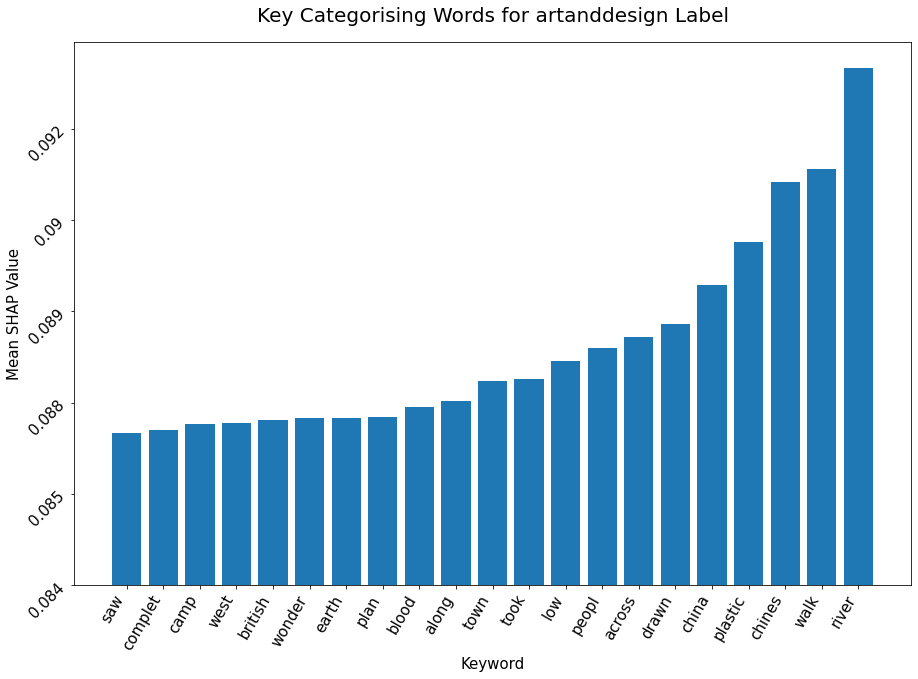

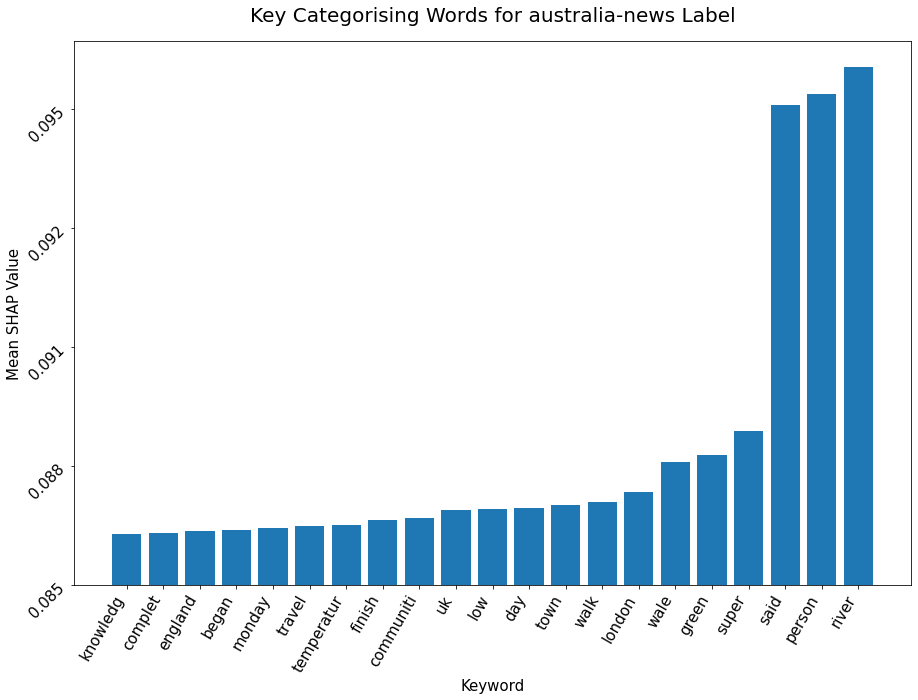

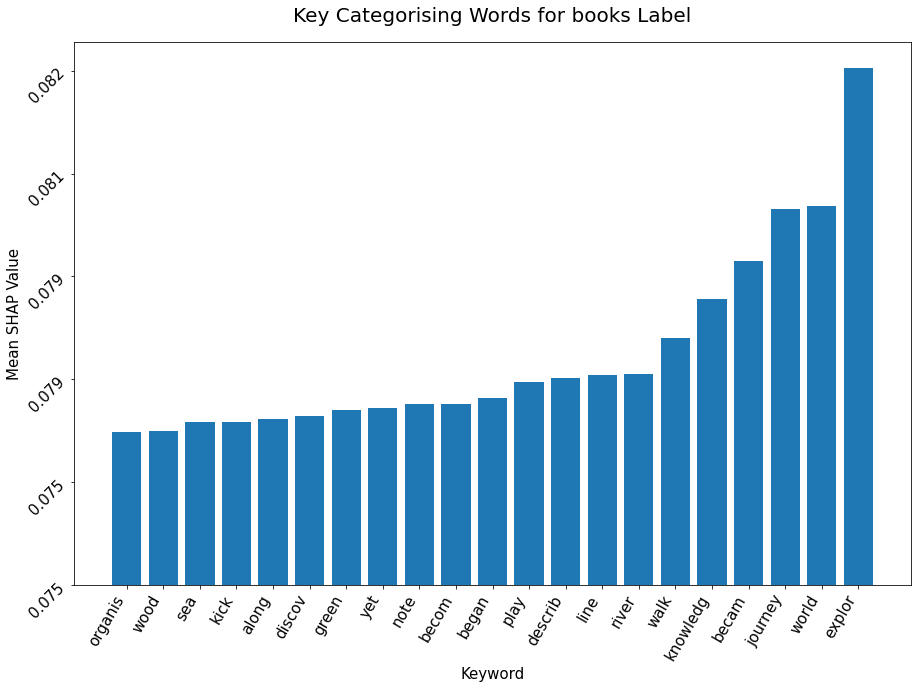

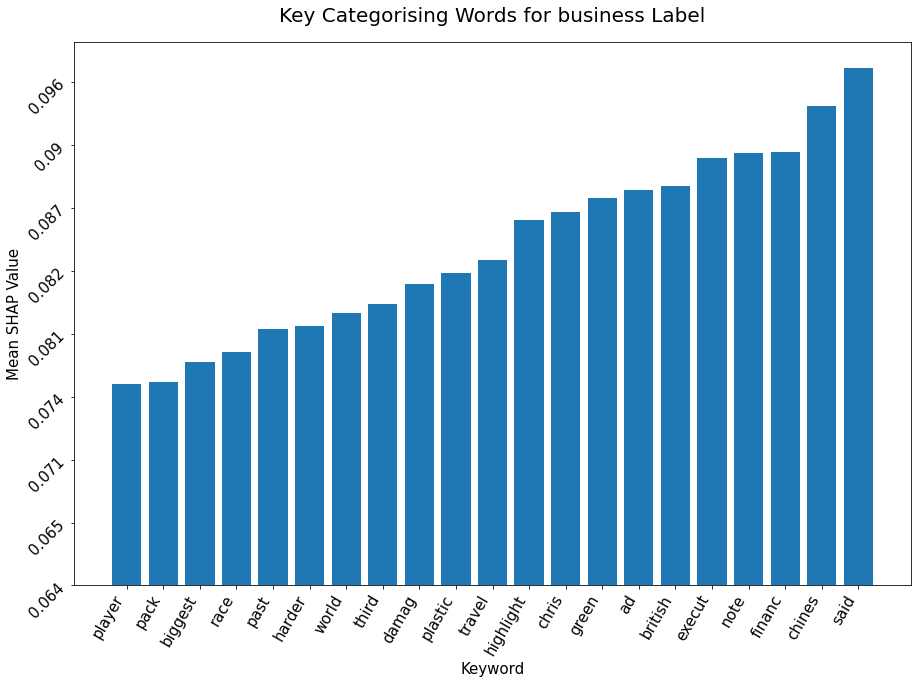

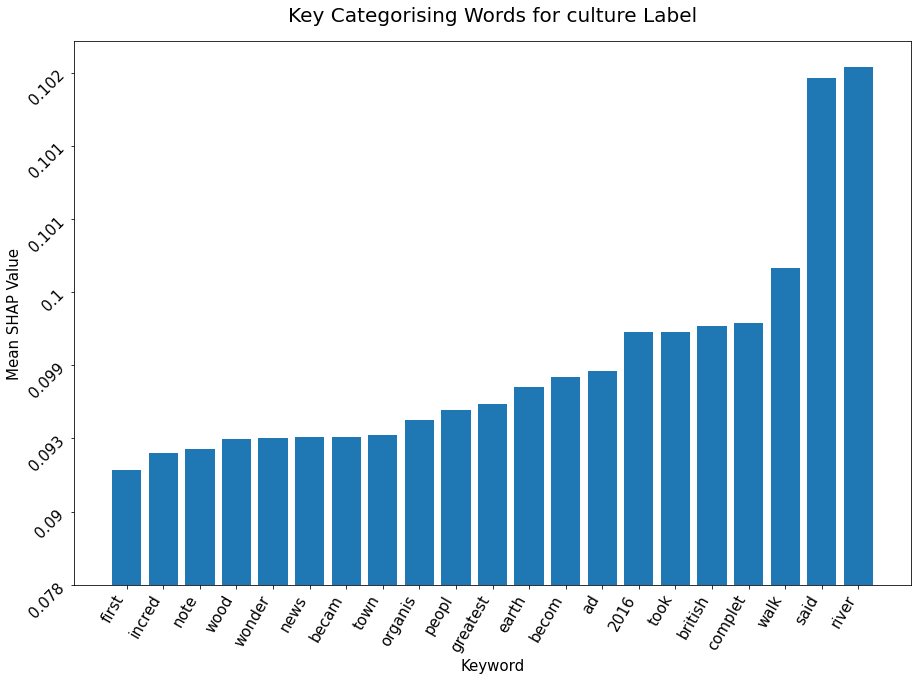

...

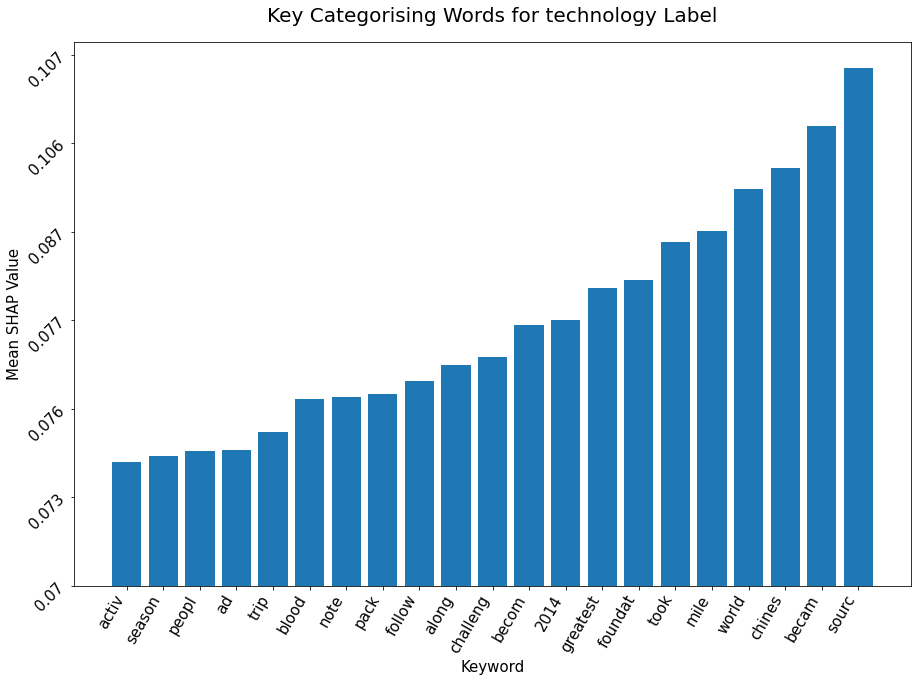

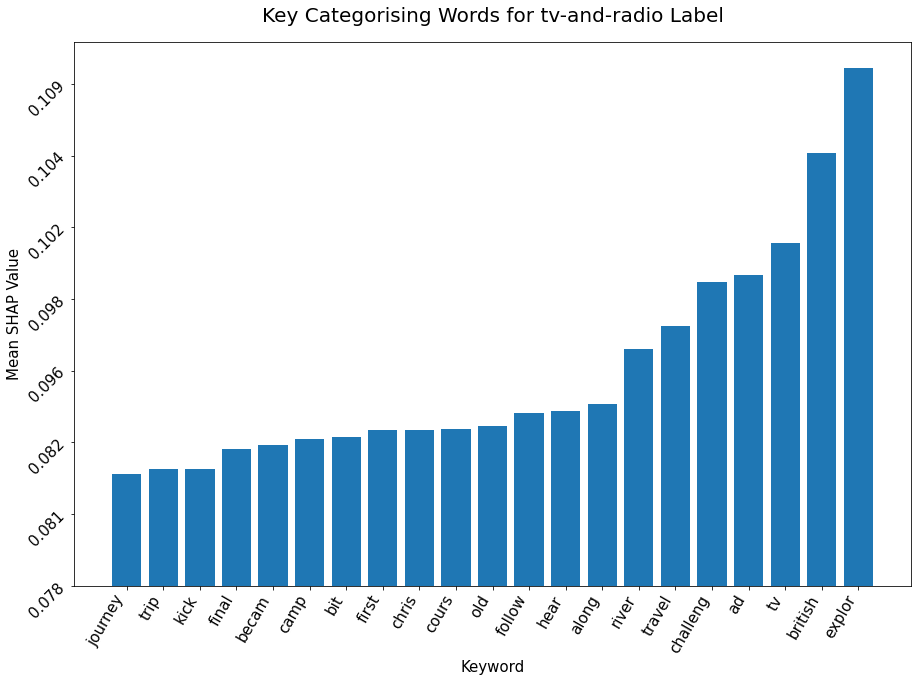

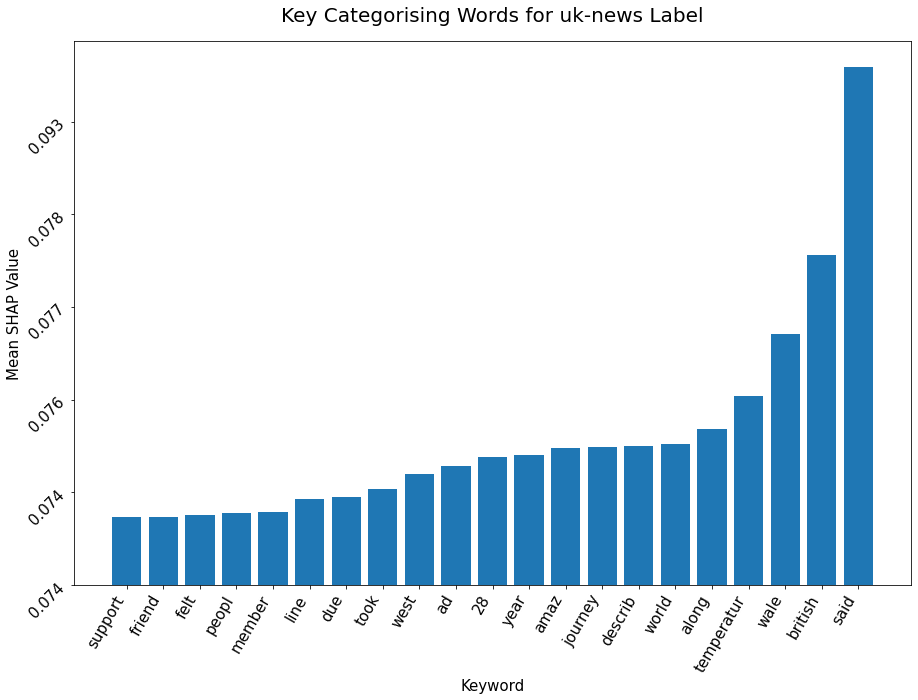

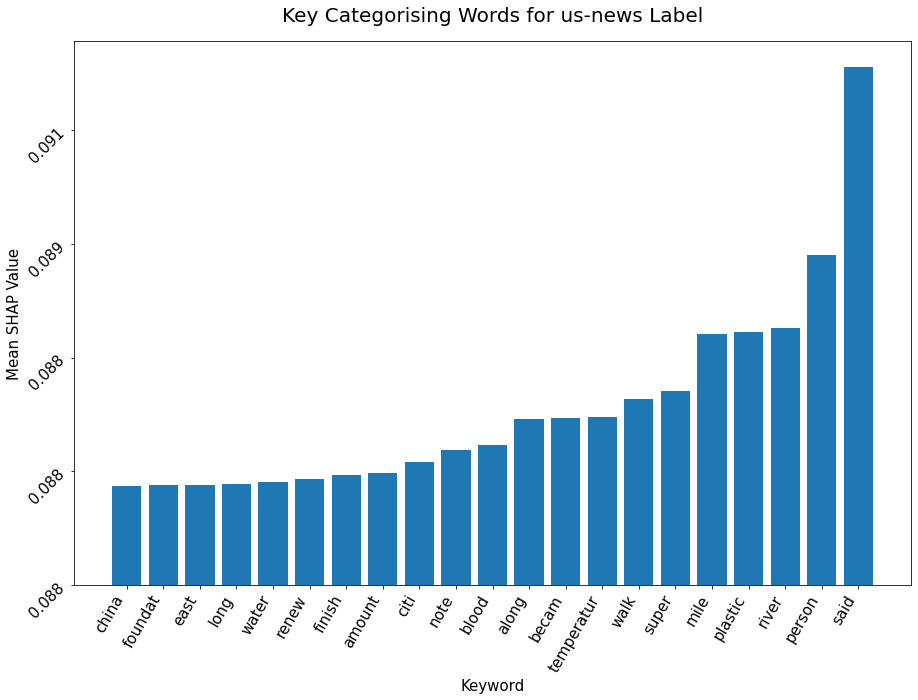

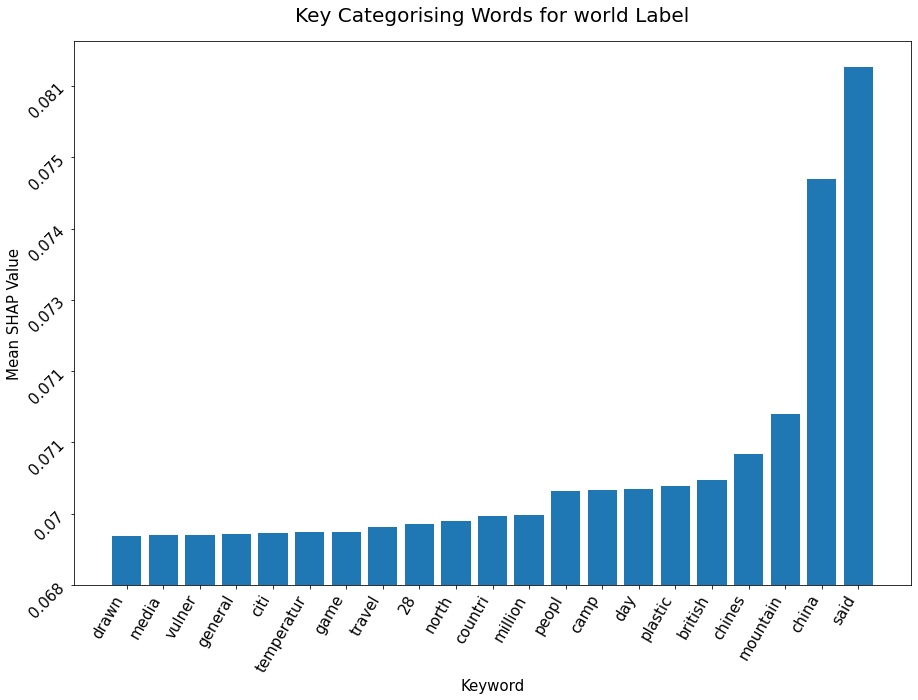

In [316]:
for dic in shap_dic_sorted:  
    ll = sorted(shap_dic_sorted[dic].items(), key=lambda x:x[1], reverse=True)[:21]
    ll_dic = dict(ll)
    l = sorted(ll_dic.items(), key=lambda x:x[1])
    graph_dic = dict(l)
        # Set up plot and plot data
    fig, ax = plt.subplots(figsize=(15, 10))
    ax.bar(list(graph_dic.keys()), list(graph_dic.values()))

    # Customize plot appearance
    y_val=[round(gd, 3) for gd in graph_dic.values()][:-1]
    x_val = list(graph_dic.keys())
    ax.set_title(f'Key Categorising Words for {dic} Label', fontsize=20, pad = 20)
    ax.set_ylabel("Mean SHAP Value", fontsize=15)
    ax.set_xlabel("Keyword", fontsize=15)
    ax.yaxis.set_ticklabels(y_val, rotation= 45, fontsize=15)
    ax.xaxis.set_ticklabels(x_val, rotation=60, fontsize=15, ha='right')
    plt.savefig(f"Viz/{dic}_shap.png")
    plt.show();

In [319]:
overall_array=np.zeros(2000)
overall_dic = {}
for cat in mean_shap_cat:
    overall_array += mean_shap_cat[cat]
overall_array /= 24
ow_idx=0
for word in overall_array:
    word_text = cols[ow_idx]
    overall_dic[word_text] = word
    ow_idx+=1

o_sortlist = sorted(overall_dic.items(), key=lambda x:x[1], reverse=True)[:25]
overall_dic_sorted = dict(o_sortlist)
    

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


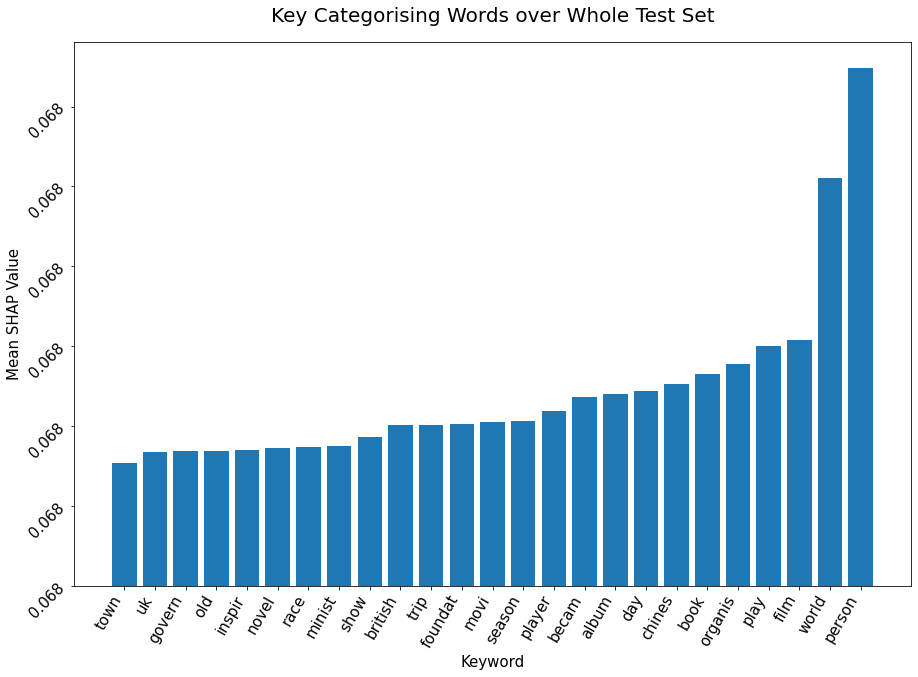

In [320]:
oall = sorted(overall_dic_sorted.items(), key=lambda x:x[1])
oall_dic = dict(oall)
fig, ax = plt.subplots(figsize=(15, 10))
ax.bar(list(oall_dic.keys()), list(oall_dic.values()))

# Customize plot appearance
y_val=[round(gd, 3) for od in oall_dic.values()]
x_val = list(oall_dic.keys())
ax.set_title(f'Key Categorising Words over Whole Test Set', fontsize=20, pad = 20)
ax.set_ylabel("Mean SHAP Value", fontsize=15)
ax.set_xlabel("Keyword", fontsize=15)
ax.yaxis.set_ticklabels(y_val, rotation= 45, fontsize=15)
ax.xaxis.set_ticklabels(x_val, rotation=60, fontsize=15, ha='right')
plt.savefig("Viz/ovall_shap.png")
plt.show();

In [310]:
with open('data/shap_val.pkl', 'wb') as inp:
    pickle.dump(shap_val_3d, inp)

## XGB

In [63]:
xgb_model = XGBClassifier(max_depth=2)
xgb_model.fit(X250_train_vector_final, y250_train['sectionId'])
xgb_model.score(X250_train_vector_final, y250_train['sectionId'])

C:\Users\james\anaconda3\envs\learn-env\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[16:29:37] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


0.77272

In [64]:
xgb_model.score(X250_test_vector_final, y250_test['sectionId'])

0.75312

<ipython-input-56-8f95ca1200d7>:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.xaxis.set_ticklabels(x_list, rotation=45);


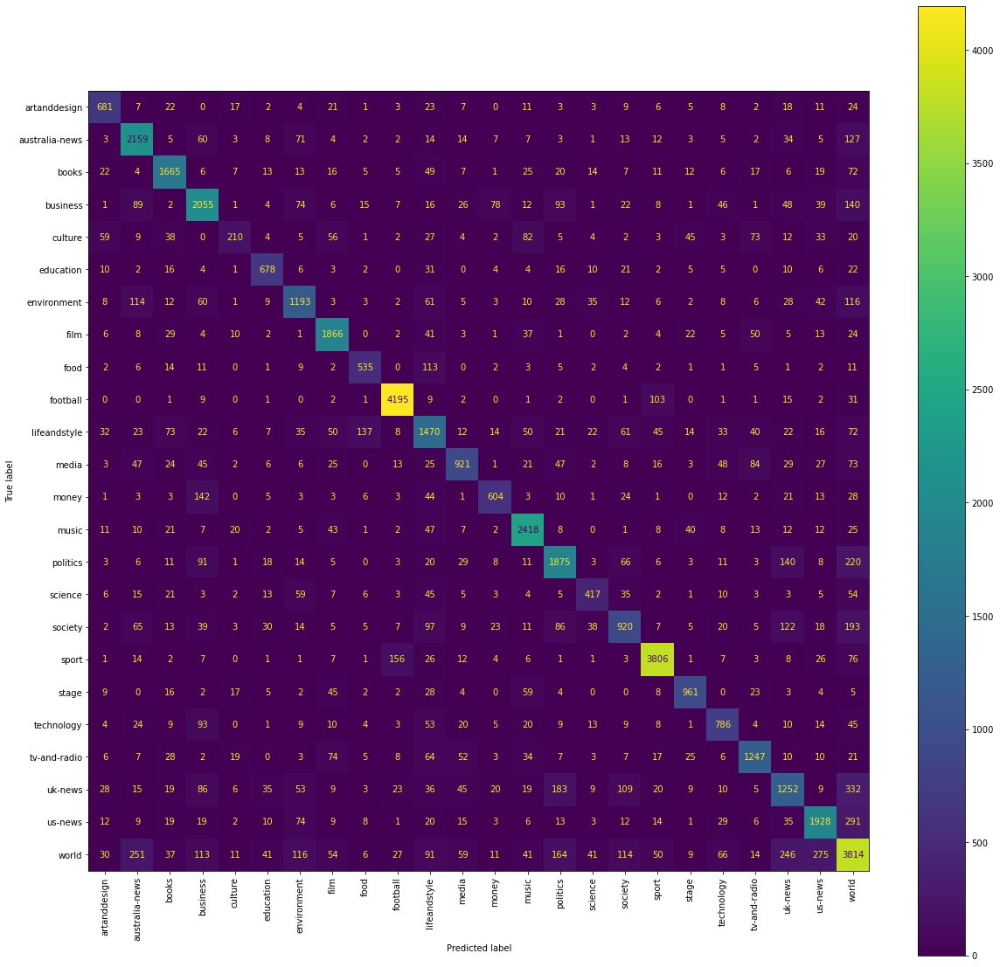

In [65]:
make_confusion_matrix(xgb_model, X250_test_vector_final, y250_test['sectionId'])

## Random Forest

In [35]:
rf_model=RandomForestClassifier(n_estimators=100, verbose=True)
rf_model.fit(X250_train_vector_final, y250_train['sectionId'])
rf_model.score(X250_train_vector_final, y250_train['sectionId'])

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed: 67.3min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:   15.9s finished


1.0

In [36]:
rf_model.score(X250_test_vector_final, y250_test['sectionId'])

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    3.5s finished


0.73804

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    3.5s finished
<ipython-input-2-979cc80c55c4>:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.xaxis.set_ticklabels(x_list, rotation=45);


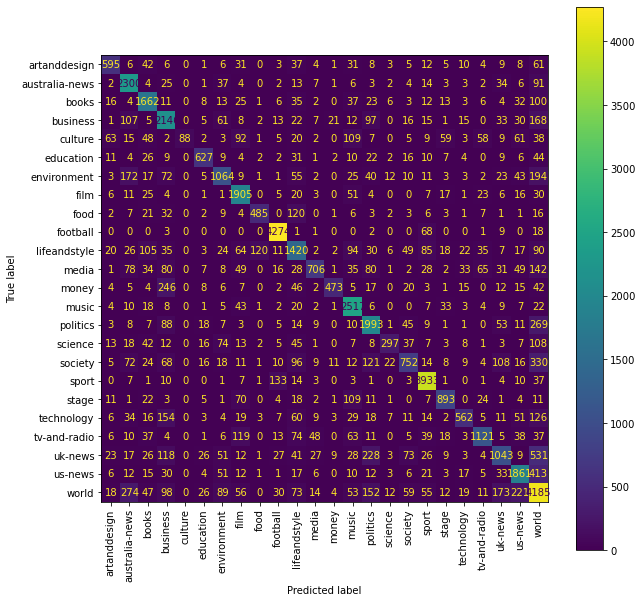

In [37]:
make_confusion_matrix(rf_model, X250_test_vector_final, y250_test['sectionId'])

# Word Embeddings Models, not NNs

In [ ]:
with open("data/data_words", "r") as fp:
    data = json.load(fp)

In [18]:
total_vocabulary = set(word for sublist in data for word in sublist)

## Make list of lists of all words in X_train, saved so can skip

In [14]:
data = X250_train['join_nostop'].map(word_tokenize).values

In [17]:
data=list(data)
with open("data/data_words", "w") as fp:
    json.dump(data, fp)

## Make vector

In [42]:
glove = {}
with open('data/glove.6B.50d.txt', 'rb') as f:
    for line in f:
        parts = line.split()
        word = parts[0].decode('utf-8')
        if word in total_vocabulary:
            vector = np.array(parts[1:], dtype=np.float32)
            glove[word] = vector

In [56]:
class W2vVectorizer(object):
    
    def __init__(self, w2v):
        self.w2v = w2v
        if len(w2v) == 0:
            self.dimensions = 0
        else:
            self.dimensions = len(w2v[next(iter(glove))])
    
    def fit(self, X, y):
        return self
            
    def transform(self, X):
        return np.array([
            np.mean([self.w2v[w] for w in words if w in self.w2v]
                   or [np.zeros(self.dimensions)], axis=0) for words in X])

In [46]:
rf =  Pipeline([('Word2Vec Vectorizer', W2vVectorizer(glove)),
              ('Random Forest', RandomForestClassifier(n_estimators=100, verbose=True))])
lr = Pipeline([('Word2Vec Vectorizer', W2vVectorizer(glove)),
              ('Logistic Regression', LogisticRegression())])
xgb = Pipeline([('Word2Vec Vectorizer', W2vVectorizer(glove)),
              ('Grad Boost', XGBClassifier())])

In [47]:
models = [('Random Forest', rf),
          ('Logistic Regression', lr),
          ('Grad Boost', xgb)]

In [57]:
scores = [(name, cross_val_score(model, data, y250_train['sectionId'], cv=2).mean()) for name, model, in models]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:  1.5min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    7.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:  1.5min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    8.8s finished
C:\Users\james\anaconda3\envs\learn-env\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative so

[20:41:59] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:52:12] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [58]:
scores

[('Random Forest', 0.701715),
 ('Logistic Regression', 0.69686),
 ('Grad Boost', 0.71888)]

# Neural nets

In [ ]:
labels_nn=['artanddesign', 'australia-news', 'books', 'business', 'culture', 'education', 'environment',
        'film', 'food', 'football', 'lifeandstyle', 'media', 'money', 'music', 'politics', 'science',
        'society', 'sport', 'stage', 'technology', 'tv-andradio', 'uk-news', 'us-news', 'world']

In [246]:
def makeLoflists(df, total_vocab, chunk_length, count=0):
    data=[]
    raw_data = [x.split() for x in df]
    total_vocabulary = (word for article in raw_data for word in article)
    total_vocab_count = Counter(total_vocabulary)
    k2_vocab = [x[0] for x in total_vocab_count.most_common(total_vocab)]
    data_long =[]
    for sublist in raw_data:
        filt = [x for x in sublist if x in k2_vocab]
        data_long.append(filt)
    for sub in data_long:
        print(count)
        vocab = Counter(sub)
        vocab_200 = [x[0] for x in vocab.most_common(200)]
        data.append(vocab_200)
        count+=1
    return data, k2_vocab

In [251]:
def create_tokenized_padded(tokenizer, data):
    X_NN = tokenizer.texts_to_sequences(data)
    X_NN = pad_sequences(X_NN, maxlen=200)
    return X_NN

In [253]:
def make_tokenized_test(tokenizer, test_df, chunk_length, count=0):
    data=[]
    raw_data = [x.split() for x in test_df]
    data_long = []
    for sublist in raw_data:
        filt = [x for x in sublist if x in vocab2k]
        data_long.append(filt)
    for sub in data_long:
        print(count)
        vocab = Counter(sub)
        vocab_200 = [x[0] for x in vocab.most_common(chunk_length)]
        data.append(vocab_200)
        count+=1
    X_NN = create_tokenized_padded(tokenizer, data)
    return X_NN

## Learned embedding

In [ ]:
le_model = keras.models.load_model('data/le_nn')

### open files to make tensors, ignore of opening model directly

In [237]:
with open('data/token_10k.pkl', 'rb') as inp:
    tokenize_10k = pickle.load(inp)

FileNotFoundError: [Errno 2] No such file or directory: 'data/token_10k.pkl'

In [6]:
with open('data/xle_train', 'rb') as inp:
    Xle_train = pickle.load(inp)

In [7]:
with open('data/xle_test', 'rb') as inp:
    Xle_test = pickle.load(inp)

### Make padded input tensors w 10k vocab and 300 word length/ saved so skip


In [239]:
ytr_ohe = pd.get_dummies(y250_train['cat_column']).values

In [241]:
yte_ohe = pd.get_dummies(y250_test['cat_column']).values

In [247]:
dataLe, vocab10k = makeLoflists(X250_train['join_nostop'], 10000, 300)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

2331
2332
2333
2334
2335
2336
2337
2338
2339
2340
2341
2342
2343
2344
2345
2346
2347
2348
2349
2350
2351
2352
2353
2354
2355
2356
2357
2358
2359
2360
2361
2362
2363
2364
2365
2366
2367
2368
2369
2370
2371
2372
2373
2374
2375
2376
2377
2378
2379
2380
2381
2382
2383
2384
2385
2386
2387
2388
2389
2390
2391
2392
2393
2394
2395
2396
2397
2398
2399
2400
2401
2402
2403
2404
2405
2406
2407
2408
2409
2410
2411
2412
2413
2414
2415
2416
2417
2418
2419
2420
2421
2422
2423
2424
2425
2426
2427
2428
2429
2430
2431
2432
2433
2434
2435
2436
2437
2438
2439
2440
2441
2442
2443
2444
2445
2446
2447
2448
2449
2450
2451
2452
2453
2454
2455
2456
2457
2458
2459
2460
2461
2462
2463
2464
2465
2466
2467
2468
2469
2470
2471
2472
2473
2474
2475
2476
2477
2478
2479
2480
2481
2482
2483
2484
2485
2486
2487
2488
2489
2490
2491
2492
2493
2494
2495
2496
2497
2498
2499
2500
2501
2502
2503
2504
2505
2506
2507
2508
2509
2510
2511
2512
2513
2514
2515
2516
2517
2518
2519
2520
2521
2522
2523
2524
2525
2526
2527
2528
2529
2530


4140
4141
4142
4143
4144
4145
4146
4147
4148
4149
4150
4151
4152
4153
4154
4155
4156
4157
4158
4159
4160
4161
4162
4163
4164
4165
4166
4167
4168
4169
4170
4171
4172
4173
4174
4175
4176
4177
4178
4179
4180
4181
4182
4183
4184
4185
4186
4187
4188
4189
4190
4191
4192
4193
4194
4195
4196
4197
4198
4199
4200
4201
4202
4203
4204
4205
4206
4207
4208
4209
4210
4211
4212
4213
4214
4215
4216
4217
4218
4219
4220
4221
4222
4223
4224
4225
4226
4227
4228
4229
4230
4231
4232
4233
4234
4235
4236
4237
4238
4239
4240
4241
4242
4243
4244
4245
4246
4247
4248
4249
4250
4251
4252
4253
4254
4255
4256
4257
4258
4259
4260
4261
4262
4263
4264
4265
4266
4267
4268
4269
4270
4271
4272
4273
4274
4275
4276
4277
4278
4279
4280
4281
4282
4283
4284
4285
4286
4287
4288
4289
4290
4291
4292
4293
4294
4295
4296
4297
4298
4299
4300
4301
4302
4303
4304
4305
4306
4307
4308
4309
4310
4311
4312
4313
4314
4315
4316
4317
4318
4319
4320
4321
4322
4323
4324
4325
4326
4327
4328
4329
4330
4331
4332
4333
4334
4335
4336
4337
4338
4339


5947
5948
5949
5950
5951
5952
5953
5954
5955
5956
5957
5958
5959
5960
5961
5962
5963
5964
5965
5966
5967
5968
5969
5970
5971
5972
5973
5974
5975
5976
5977
5978
5979
5980
5981
5982
5983
5984
5985
5986
5987
5988
5989
5990
5991
5992
5993
5994
5995
5996
5997
5998
5999
6000
6001
6002
6003
6004
6005
6006
6007
6008
6009
6010
6011
6012
6013
6014
6015
6016
6017
6018
6019
6020
6021
6022
6023
6024
6025
6026
6027
6028
6029
6030
6031
6032
6033
6034
6035
6036
6037
6038
6039
6040
6041
6042
6043
6044
6045
6046
6047
6048
6049
6050
6051
6052
6053
6054
6055
6056
6057
6058
6059
6060
6061
6062
6063
6064
6065
6066
6067
6068
6069
6070
6071
6072
6073
6074
6075
6076
6077
6078
6079
6080
6081
6082
6083
6084
6085
6086
6087
6088
6089
6090
6091
6092
6093
6094
6095
6096
6097
6098
6099
6100
6101
6102
6103
6104
6105
6106
6107
6108
6109
6110
6111
6112
6113
6114
6115
6116
6117
6118
6119
6120
6121
6122
6123
6124
6125
6126
6127
6128
6129
6130
6131
6132
6133
6134
6135
6136
6137
6138
6139
6140
6141
6142
6143
6144
6145
6146


7638
7639
7640
7641
7642
7643
7644
7645
7646
7647
7648
7649
7650
7651
7652
7653
7654
7655
7656
7657
7658
7659
7660
7661
7662
7663
7664
7665
7666
7667
7668
7669
7670
7671
7672
7673
7674
7675
7676
7677
7678
7679
7680
7681
7682
7683
7684
7685
7686
7687
7688
7689
7690
7691
7692
7693
7694
7695
7696
7697
7698
7699
7700
7701
7702
7703
7704
7705
7706
7707
7708
7709
7710
7711
7712
7713
7714
7715
7716
7717
7718
7719
7720
7721
7722
7723
7724
7725
7726
7727
7728
7729
7730
7731
7732
7733
7734
7735
7736
7737
7738
7739
7740
7741
7742
7743
7744
7745
7746
7747
7748
7749
7750
7751
7752
7753
7754
7755
7756
7757
7758
7759
7760
7761
7762
7763
7764
7765
7766
7767
7768
7769
7770
7771
7772
7773
7774
7775
7776
7777
7778
7779
7780
7781
7782
7783
7784
7785
7786
7787
7788
7789
7790
7791
7792
7793
7794
7795
7796
7797
7798
7799
7800
7801
7802
7803
7804
7805
7806
7807
7808
7809
7810
7811
7812
7813
7814
7815
7816
7817
7818
7819
7820
7821
7822
7823
7824
7825
7826
7827
7828
7829
7830
7831
7832
7833
7834
7835
7836
7837


9426
9427
9428
9429
9430
9431
9432
9433
9434
9435
9436
9437
9438
9439
9440
9441
9442
9443
9444
9445
9446
9447
9448
9449
9450
9451
9452
9453
9454
9455
9456
9457
9458
9459
9460
9461
9462
9463
9464
9465
9466
9467
9468
9469
9470
9471
9472
9473
9474
9475
9476
9477
9478
9479
9480
9481
9482
9483
9484
9485
9486
9487
9488
9489
9490
9491
9492
9493
9494
9495
9496
9497
9498
9499
9500
9501
9502
9503
9504
9505
9506
9507
9508
9509
9510
9511
9512
9513
9514
9515
9516
9517
9518
9519
9520
9521
9522
9523
9524
9525
9526
9527
9528
9529
9530
9531
9532
9533
9534
9535
9536
9537
9538
9539
9540
9541
9542
9543
9544
9545
9546
9547
9548
9549
9550
9551
9552
9553
9554
9555
9556
9557
9558
9559
9560
9561
9562
9563
9564
9565
9566
9567
9568
9569
9570
9571
9572
9573
9574
9575
9576
9577
9578
9579
9580
9581
9582
9583
9584
9585
9586
9587
9588
9589
9590
9591
9592
9593
9594
9595
9596
9597
9598
9599
9600
9601
9602
9603
9604
9605
9606
9607
9608
9609
9610
9611
9612
9613
9614
9615
9616
9617
9618
9619
9620
9621
9622
9623
9624
9625


11169
11170
11171
11172
11173
11174
11175
11176
11177
11178
11179
11180
11181
11182
11183
11184
11185
11186
11187
11188
11189
11190
11191
11192
11193
11194
11195
11196
11197
11198
11199
11200
11201
11202
11203
11204
11205
11206
11207
11208
11209
11210
11211
11212
11213
11214
11215
11216
11217
11218
11219
11220
11221
11222
11223
11224
11225
11226
11227
11228
11229
11230
11231
11232
11233
11234
11235
11236
11237
11238
11239
11240
11241
11242
11243
11244
11245
11246
11247
11248
11249
11250
11251
11252
11253
11254
11255
11256
11257
11258
11259
11260
11261
11262
11263
11264
11265
11266
11267
11268
11269
11270
11271
11272
11273
11274
11275
11276
11277
11278
11279
11280
11281
11282
11283
11284
11285
11286
11287
11288
11289
11290
11291
11292
11293
11294
11295
11296
11297
11298
11299
11300
11301
11302
11303
11304
11305
11306
11307
11308
11309
11310
11311
11312
11313
11314
11315
11316
11317
11318
11319
11320
11321
11322
11323
11324
11325
11326
11327
11328
11329
11330
11331
11332
11333
11334
1133

12768
12769
12770
12771
12772
12773
12774
12775
12776
12777
12778
12779
12780
12781
12782
12783
12784
12785
12786
12787
12788
12789
12790
12791
12792
12793
12794
12795
12796
12797
12798
12799
12800
12801
12802
12803
12804
12805
12806
12807
12808
12809
12810
12811
12812
12813
12814
12815
12816
12817
12818
12819
12820
12821
12822
12823
12824
12825
12826
12827
12828
12829
12830
12831
12832
12833
12834
12835
12836
12837
12838
12839
12840
12841
12842
12843
12844
12845
12846
12847
12848
12849
12850
12851
12852
12853
12854
12855
12856
12857
12858
12859
12860
12861
12862
12863
12864
12865
12866
12867
12868
12869
12870
12871
12872
12873
12874
12875
12876
12877
12878
12879
12880
12881
12882
12883
12884
12885
12886
12887
12888
12889
12890
12891
12892
12893
12894
12895
12896
12897
12898
12899
12900
12901
12902
12903
12904
12905
12906
12907
12908
12909
12910
12911
12912
12913
12914
12915
12916
12917
12918
12919
12920
12921
12922
12923
12924
12925
12926
12927
12928
12929
12930
12931
12932
12933
1293

14387
14388
14389
14390
14391
14392
14393
14394
14395
14396
14397
14398
14399
14400
14401
14402
14403
14404
14405
14406
14407
14408
14409
14410
14411
14412
14413
14414
14415
14416
14417
14418
14419
14420
14421
14422
14423
14424
14425
14426
14427
14428
14429
14430
14431
14432
14433
14434
14435
14436
14437
14438
14439
14440
14441
14442
14443
14444
14445
14446
14447
14448
14449
14450
14451
14452
14453
14454
14455
14456
14457
14458
14459
14460
14461
14462
14463
14464
14465
14466
14467
14468
14469
14470
14471
14472
14473
14474
14475
14476
14477
14478
14479
14480
14481
14482
14483
14484
14485
14486
14487
14488
14489
14490
14491
14492
14493
14494
14495
14496
14497
14498
14499
14500
14501
14502
14503
14504
14505
14506
14507
14508
14509
14510
14511
14512
14513
14514
14515
14516
14517
14518
14519
14520
14521
14522
14523
14524
14525
14526
14527
14528
14529
14530
14531
14532
14533
14534
14535
14536
14537
14538
14539
14540
14541
14542
14543
14544
14545
14546
14547
14548
14549
14550
14551
14552
1455

16001
16002
16003
16004
16005
16006
16007
16008
16009
16010
16011
16012
16013
16014
16015
16016
16017
16018
16019
16020
16021
16022
16023
16024
16025
16026
16027
16028
16029
16030
16031
16032
16033
16034
16035
16036
16037
16038
16039
16040
16041
16042
16043
16044
16045
16046
16047
16048
16049
16050
16051
16052
16053
16054
16055
16056
16057
16058
16059
16060
16061
16062
16063
16064
16065
16066
16067
16068
16069
16070
16071
16072
16073
16074
16075
16076
16077
16078
16079
16080
16081
16082
16083
16084
16085
16086
16087
16088
16089
16090
16091
16092
16093
16094
16095
16096
16097
16098
16099
16100
16101
16102
16103
16104
16105
16106
16107
16108
16109
16110
16111
16112
16113
16114
16115
16116
16117
16118
16119
16120
16121
16122
16123
16124
16125
16126
16127
16128
16129
16130
16131
16132
16133
16134
16135
16136
16137
16138
16139
16140
16141
16142
16143
16144
16145
16146
16147
16148
16149
16150
16151
16152
16153
16154
16155
16156
16157
16158
16159
16160
16161
16162
16163
16164
16165
16166
1616

17693
17694
17695
17696
17697
17698
17699
17700
17701
17702
17703
17704
17705
17706
17707
17708
17709
17710
17711
17712
17713
17714
17715
17716
17717
17718
17719
17720
17721
17722
17723
17724
17725
17726
17727
17728
17729
17730
17731
17732
17733
17734
17735
17736
17737
17738
17739
17740
17741
17742
17743
17744
17745
17746
17747
17748
17749
17750
17751
17752
17753
17754
17755
17756
17757
17758
17759
17760
17761
17762
17763
17764
17765
17766
17767
17768
17769
17770
17771
17772
17773
17774
17775
17776
17777
17778
17779
17780
17781
17782
17783
17784
17785
17786
17787
17788
17789
17790
17791
17792
17793
17794
17795
17796
17797
17798
17799
17800
17801
17802
17803
17804
17805
17806
17807
17808
17809
17810
17811
17812
17813
17814
17815
17816
17817
17818
17819
17820
17821
17822
17823
17824
17825
17826
17827
17828
17829
17830
17831
17832
17833
17834
17835
17836
17837
17838
17839
17840
17841
17842
17843
17844
17845
17846
17847
17848
17849
17850
17851
17852
17853
17854
17855
17856
17857
17858
1785

19138
19139
19140
19141
19142
19143
19144
19145
19146
19147
19148
19149
19150
19151
19152
19153
19154
19155
19156
19157
19158
19159
19160
19161
19162
19163
19164
19165
19166
19167
19168
19169
19170
19171
19172
19173
19174
19175
19176
19177
19178
19179
19180
19181
19182
19183
19184
19185
19186
19187
19188
19189
19190
19191
19192
19193
19194
19195
19196
19197
19198
19199
19200
19201
19202
19203
19204
19205
19206
19207
19208
19209
19210
19211
19212
19213
19214
19215
19216
19217
19218
19219
19220
19221
19222
19223
19224
19225
19226
19227
19228
19229
19230
19231
19232
19233
19234
19235
19236
19237
19238
19239
19240
19241
19242
19243
19244
19245
19246
19247
19248
19249
19250
19251
19252
19253
19254
19255
19256
19257
19258
19259
19260
19261
19262
19263
19264
19265
19266
19267
19268
19269
19270
19271
19272
19273
19274
19275
19276
19277
19278
19279
19280
19281
19282
19283
19284
19285
19286
19287
19288
19289
19290
19291
19292
19293
19294
19295
19296
19297
19298
19299
19300
19301
19302
19303
1930

21032
21033
21034
21035
21036
21037
21038
21039
21040
21041
21042
21043
21044
21045
21046
21047
21048
21049
21050
21051
21052
21053
21054
21055
21056
21057
21058
21059
21060
21061
21062
21063
21064
21065
21066
21067
21068
21069
21070
21071
21072
21073
21074
21075
21076
21077
21078
21079
21080
21081
21082
21083
21084
21085
21086
21087
21088
21089
21090
21091
21092
21093
21094
21095
21096
21097
21098
21099
21100
21101
21102
21103
21104
21105
21106
21107
21108
21109
21110
21111
21112
21113
21114
21115
21116
21117
21118
21119
21120
21121
21122
21123
21124
21125
21126
21127
21128
21129
21130
21131
21132
21133
21134
21135
21136
21137
21138
21139
21140
21141
21142
21143
21144
21145
21146
21147
21148
21149
21150
21151
21152
21153
21154
21155
21156
21157
21158
21159
21160
21161
21162
21163
21164
21165
21166
21167
21168
21169
21170
21171
21172
21173
21174
21175
21176
21177
21178
21179
21180
21181
21182
21183
21184
21185
21186
21187
21188
21189
21190
21191
21192
21193
21194
21195
21196
21197
2119

22987
22988
22989
22990
22991
22992
22993
22994
22995
22996
22997
22998
22999
23000
23001
23002
23003
23004
23005
23006
23007
23008
23009
23010
23011
23012
23013
23014
23015
23016
23017
23018
23019
23020
23021
23022
23023
23024
23025
23026
23027
23028
23029
23030
23031
23032
23033
23034
23035
23036
23037
23038
23039
23040
23041
23042
23043
23044
23045
23046
23047
23048
23049
23050
23051
23052
23053
23054
23055
23056
23057
23058
23059
23060
23061
23062
23063
23064
23065
23066
23067
23068
23069
23070
23071
23072
23073
23074
23075
23076
23077
23078
23079
23080
23081
23082
23083
23084
23085
23086
23087
23088
23089
23090
23091
23092
23093
23094
23095
23096
23097
23098
23099
23100
23101
23102
23103
23104
23105
23106
23107
23108
23109
23110
23111
23112
23113
23114
23115
23116
23117
23118
23119
23120
23121
23122
23123
23124
23125
23126
23127
23128
23129
23130
23131
23132
23133
23134
23135
23136
23137
23138
23139
23140
23141
23142
23143
23144
23145
23146
23147
23148
23149
23150
23151
23152
2315

24724
24725
24726
24727
24728
24729
24730
24731
24732
24733
24734
24735
24736
24737
24738
24739
24740
24741
24742
24743
24744
24745
24746
24747
24748
24749
24750
24751
24752
24753
24754
24755
24756
24757
24758
24759
24760
24761
24762
24763
24764
24765
24766
24767
24768
24769
24770
24771
24772
24773
24774
24775
24776
24777
24778
24779
24780
24781
24782
24783
24784
24785
24786
24787
24788
24789
24790
24791
24792
24793
24794
24795
24796
24797
24798
24799
24800
24801
24802
24803
24804
24805
24806
24807
24808
24809
24810
24811
24812
24813
24814
24815
24816
24817
24818
24819
24820
24821
24822
24823
24824
24825
24826
24827
24828
24829
24830
24831
24832
24833
24834
24835
24836
24837
24838
24839
24840
24841
24842
24843
24844
24845
24846
24847
24848
24849
24850
24851
24852
24853
24854
24855
24856
24857
24858
24859
24860
24861
24862
24863
24864
24865
24866
24867
24868
24869
24870
24871
24872
24873
24874
24875
24876
24877
24878
24879
24880
24881
24882
24883
24884
24885
24886
24887
24888
24889
2489

26183
26184
26185
26186
26187
26188
26189
26190
26191
26192
26193
26194
26195
26196
26197
26198
26199
26200
26201
26202
26203
26204
26205
26206
26207
26208
26209
26210
26211
26212
26213
26214
26215
26216
26217
26218
26219
26220
26221
26222
26223
26224
26225
26226
26227
26228
26229
26230
26231
26232
26233
26234
26235
26236
26237
26238
26239
26240
26241
26242
26243
26244
26245
26246
26247
26248
26249
26250
26251
26252
26253
26254
26255
26256
26257
26258
26259
26260
26261
26262
26263
26264
26265
26266
26267
26268
26269
26270
26271
26272
26273
26274
26275
26276
26277
26278
26279
26280
26281
26282
26283
26284
26285
26286
26287
26288
26289
26290
26291
26292
26293
26294
26295
26296
26297
26298
26299
26300
26301
26302
26303
26304
26305
26306
26307
26308
26309
26310
26311
26312
26313
26314
26315
26316
26317
26318
26319
26320
26321
26322
26323
26324
26325
26326
26327
26328
26329
26330
26331
26332
26333
26334
26335
26336
26337
26338
26339
26340
26341
26342
26343
26344
26345
26346
26347
26348
2634

27798
27799
27800
27801
27802
27803
27804
27805
27806
27807
27808
27809
27810
27811
27812
27813
27814
27815
27816
27817
27818
27819
27820
27821
27822
27823
27824
27825
27826
27827
27828
27829
27830
27831
27832
27833
27834
27835
27836
27837
27838
27839
27840
27841
27842
27843
27844
27845
27846
27847
27848
27849
27850
27851
27852
27853
27854
27855
27856
27857
27858
27859
27860
27861
27862
27863
27864
27865
27866
27867
27868
27869
27870
27871
27872
27873
27874
27875
27876
27877
27878
27879
27880
27881
27882
27883
27884
27885
27886
27887
27888
27889
27890
27891
27892
27893
27894
27895
27896
27897
27898
27899
27900
27901
27902
27903
27904
27905
27906
27907
27908
27909
27910
27911
27912
27913
27914
27915
27916
27917
27918
27919
27920
27921
27922
27923
27924
27925
27926
27927
27928
27929
27930
27931
27932
27933
27934
27935
27936
27937
27938
27939
27940
27941
27942
27943
27944
27945
27946
27947
27948
27949
27950
27951
27952
27953
27954
27955
27956
27957
27958
27959
27960
27961
27962
27963
2796

29318
29319
29320
29321
29322
29323
29324
29325
29326
29327
29328
29329
29330
29331
29332
29333
29334
29335
29336
29337
29338
29339
29340
29341
29342
29343
29344
29345
29346
29347
29348
29349
29350
29351
29352
29353
29354
29355
29356
29357
29358
29359
29360
29361
29362
29363
29364
29365
29366
29367
29368
29369
29370
29371
29372
29373
29374
29375
29376
29377
29378
29379
29380
29381
29382
29383
29384
29385
29386
29387
29388
29389
29390
29391
29392
29393
29394
29395
29396
29397
29398
29399
29400
29401
29402
29403
29404
29405
29406
29407
29408
29409
29410
29411
29412
29413
29414
29415
29416
29417
29418
29419
29420
29421
29422
29423
29424
29425
29426
29427
29428
29429
29430
29431
29432
29433
29434
29435
29436
29437
29438
29439
29440
29441
29442
29443
29444
29445
29446
29447
29448
29449
29450
29451
29452
29453
29454
29455
29456
29457
29458
29459
29460
29461
29462
29463
29464
29465
29466
29467
29468
29469
29470
29471
29472
29473
29474
29475
29476
29477
29478
29479
29480
29481
29482
29483
2948

31176
31177
31178
31179
31180
31181
31182
31183
31184
31185
31186
31187
31188
31189
31190
31191
31192
31193
31194
31195
31196
31197
31198
31199
31200
31201
31202
31203
31204
31205
31206
31207
31208
31209
31210
31211
31212
31213
31214
31215
31216
31217
31218
31219
31220
31221
31222
31223
31224
31225
31226
31227
31228
31229
31230
31231
31232
31233
31234
31235
31236
31237
31238
31239
31240
31241
31242
31243
31244
31245
31246
31247
31248
31249
31250
31251
31252
31253
31254
31255
31256
31257
31258
31259
31260
31261
31262
31263
31264
31265
31266
31267
31268
31269
31270
31271
31272
31273
31274
31275
31276
31277
31278
31279
31280
31281
31282
31283
31284
31285
31286
31287
31288
31289
31290
31291
31292
31293
31294
31295
31296
31297
31298
31299
31300
31301
31302
31303
31304
31305
31306
31307
31308
31309
31310
31311
31312
31313
31314
31315
31316
31317
31318
31319
31320
31321
31322
31323
31324
31325
31326
31327
31328
31329
31330
31331
31332
31333
31334
31335
31336
31337
31338
31339
31340
31341
3134

33189
33190
33191
33192
33193
33194
33195
33196
33197
33198
33199
33200
33201
33202
33203
33204
33205
33206
33207
33208
33209
33210
33211
33212
33213
33214
33215
33216
33217
33218
33219
33220
33221
33222
33223
33224
33225
33226
33227
33228
33229
33230
33231
33232
33233
33234
33235
33236
33237
33238
33239
33240
33241
33242
33243
33244
33245
33246
33247
33248
33249
33250
33251
33252
33253
33254
33255
33256
33257
33258
33259
33260
33261
33262
33263
33264
33265
33266
33267
33268
33269
33270
33271
33272
33273
33274
33275
33276
33277
33278
33279
33280
33281
33282
33283
33284
33285
33286
33287
33288
33289
33290
33291
33292
33293
33294
33295
33296
33297
33298
33299
33300
33301
33302
33303
33304
33305
33306
33307
33308
33309
33310
33311
33312
33313
33314
33315
33316
33317
33318
33319
33320
33321
33322
33323
33324
33325
33326
33327
33328
33329
33330
33331
33332
33333
33334
33335
33336
33337
33338
33339
33340
33341
33342
33343
33344
33345
33346
33347
33348
33349
33350
33351
33352
33353
33354
3335

35197
35198
35199
35200
35201
35202
35203
35204
35205
35206
35207
35208
35209
35210
35211
35212
35213
35214
35215
35216
35217
35218
35219
35220
35221
35222
35223
35224
35225
35226
35227
35228
35229
35230
35231
35232
35233
35234
35235
35236
35237
35238
35239
35240
35241
35242
35243
35244
35245
35246
35247
35248
35249
35250
35251
35252
35253
35254
35255
35256
35257
35258
35259
35260
35261
35262
35263
35264
35265
35266
35267
35268
35269
35270
35271
35272
35273
35274
35275
35276
35277
35278
35279
35280
35281
35282
35283
35284
35285
35286
35287
35288
35289
35290
35291
35292
35293
35294
35295
35296
35297
35298
35299
35300
35301
35302
35303
35304
35305
35306
35307
35308
35309
35310
35311
35312
35313
35314
35315
35316
35317
35318
35319
35320
35321
35322
35323
35324
35325
35326
35327
35328
35329
35330
35331
35332
35333
35334
35335
35336
35337
35338
35339
35340
35341
35342
35343
35344
35345
35346
35347
35348
35349
35350
35351
35352
35353
35354
35355
35356
35357
35358
35359
35360
35361
35362
3536

37138
37139
37140
37141
37142
37143
37144
37145
37146
37147
37148
37149
37150
37151
37152
37153
37154
37155
37156
37157
37158
37159
37160
37161
37162
37163
37164
37165
37166
37167
37168
37169
37170
37171
37172
37173
37174
37175
37176
37177
37178
37179
37180
37181
37182
37183
37184
37185
37186
37187
37188
37189
37190
37191
37192
37193
37194
37195
37196
37197
37198
37199
37200
37201
37202
37203
37204
37205
37206
37207
37208
37209
37210
37211
37212
37213
37214
37215
37216
37217
37218
37219
37220
37221
37222
37223
37224
37225
37226
37227
37228
37229
37230
37231
37232
37233
37234
37235
37236
37237
37238
37239
37240
37241
37242
37243
37244
37245
37246
37247
37248
37249
37250
37251
37252
37253
37254
37255
37256
37257
37258
37259
37260
37261
37262
37263
37264
37265
37266
37267
37268
37269
37270
37271
37272
37273
37274
37275
37276
37277
37278
37279
37280
37281
37282
37283
37284
37285
37286
37287
37288
37289
37290
37291
37292
37293
37294
37295
37296
37297
37298
37299
37300
37301
37302
37303
3730

38778
38779
38780
38781
38782
38783
38784
38785
38786
38787
38788
38789
38790
38791
38792
38793
38794
38795
38796
38797
38798
38799
38800
38801
38802
38803
38804
38805
38806
38807
38808
38809
38810
38811
38812
38813
38814
38815
38816
38817
38818
38819
38820
38821
38822
38823
38824
38825
38826
38827
38828
38829
38830
38831
38832
38833
38834
38835
38836
38837
38838
38839
38840
38841
38842
38843
38844
38845
38846
38847
38848
38849
38850
38851
38852
38853
38854
38855
38856
38857
38858
38859
38860
38861
38862
38863
38864
38865
38866
38867
38868
38869
38870
38871
38872
38873
38874
38875
38876
38877
38878
38879
38880
38881
38882
38883
38884
38885
38886
38887
38888
38889
38890
38891
38892
38893
38894
38895
38896
38897
38898
38899
38900
38901
38902
38903
38904
38905
38906
38907
38908
38909
38910
38911
38912
38913
38914
38915
38916
38917
38918
38919
38920
38921
38922
38923
38924
38925
38926
38927
38928
38929
38930
38931
38932
38933
38934
38935
38936
38937
38938
38939
38940
38941
38942
38943
3894

40808
40809
40810
40811
40812
40813
40814
40815
40816
40817
40818
40819
40820
40821
40822
40823
40824
40825
40826
40827
40828
40829
40830
40831
40832
40833
40834
40835
40836
40837
40838
40839
40840
40841
40842
40843
40844
40845
40846
40847
40848
40849
40850
40851
40852
40853
40854
40855
40856
40857
40858
40859
40860
40861
40862
40863
40864
40865
40866
40867
40868
40869
40870
40871
40872
40873
40874
40875
40876
40877
40878
40879
40880
40881
40882
40883
40884
40885
40886
40887
40888
40889
40890
40891
40892
40893
40894
40895
40896
40897
40898
40899
40900
40901
40902
40903
40904
40905
40906
40907
40908
40909
40910
40911
40912
40913
40914
40915
40916
40917
40918
40919
40920
40921
40922
40923
40924
40925
40926
40927
40928
40929
40930
40931
40932
40933
40934
40935
40936
40937
40938
40939
40940
40941
40942
40943
40944
40945
40946
40947
40948
40949
40950
40951
40952
40953
40954
40955
40956
40957
40958
40959
40960
40961
40962
40963
40964
40965
40966
40967
40968
40969
40970
40971
40972
40973
4097

42758
42759
42760
42761
42762
42763
42764
42765
42766
42767
42768
42769
42770
42771
42772
42773
42774
42775
42776
42777
42778
42779
42780
42781
42782
42783
42784
42785
42786
42787
42788
42789
42790
42791
42792
42793
42794
42795
42796
42797
42798
42799
42800
42801
42802
42803
42804
42805
42806
42807
42808
42809
42810
42811
42812
42813
42814
42815
42816
42817
42818
42819
42820
42821
42822
42823
42824
42825
42826
42827
42828
42829
42830
42831
42832
42833
42834
42835
42836
42837
42838
42839
42840
42841
42842
42843
42844
42845
42846
42847
42848
42849
42850
42851
42852
42853
42854
42855
42856
42857
42858
42859
42860
42861
42862
42863
42864
42865
42866
42867
42868
42869
42870
42871
42872
42873
42874
42875
42876
42877
42878
42879
42880
42881
42882
42883
42884
42885
42886
42887
42888
42889
42890
42891
42892
42893
42894
42895
42896
42897
42898
42899
42900
42901
42902
42903
42904
42905
42906
42907
42908
42909
42910
42911
42912
42913
42914
42915
42916
42917
42918
42919
42920
42921
42922
42923
4292

44356
44357
44358
44359
44360
44361
44362
44363
44364
44365
44366
44367
44368
44369
44370
44371
44372
44373
44374
44375
44376
44377
44378
44379
44380
44381
44382
44383
44384
44385
44386
44387
44388
44389
44390
44391
44392
44393
44394
44395
44396
44397
44398
44399
44400
44401
44402
44403
44404
44405
44406
44407
44408
44409
44410
44411
44412
44413
44414
44415
44416
44417
44418
44419
44420
44421
44422
44423
44424
44425
44426
44427
44428
44429
44430
44431
44432
44433
44434
44435
44436
44437
44438
44439
44440
44441
44442
44443
44444
44445
44446
44447
44448
44449
44450
44451
44452
44453
44454
44455
44456
44457
44458
44459
44460
44461
44462
44463
44464
44465
44466
44467
44468
44469
44470
44471
44472
44473
44474
44475
44476
44477
44478
44479
44480
44481
44482
44483
44484
44485
44486
44487
44488
44489
44490
44491
44492
44493
44494
44495
44496
44497
44498
44499
44500
44501
44502
44503
44504
44505
44506
44507
44508
44509
44510
44511
44512
44513
44514
44515
44516
44517
44518
44519
44520
44521
4452

45730
45731
45732
45733
45734
45735
45736
45737
45738
45739
45740
45741
45742
45743
45744
45745
45746
45747
45748
45749
45750
45751
45752
45753
45754
45755
45756
45757
45758
45759
45760
45761
45762
45763
45764
45765
45766
45767
45768
45769
45770
45771
45772
45773
45774
45775
45776
45777
45778
45779
45780
45781
45782
45783
45784
45785
45786
45787
45788
45789
45790
45791
45792
45793
45794
45795
45796
45797
45798
45799
45800
45801
45802
45803
45804
45805
45806
45807
45808
45809
45810
45811
45812
45813
45814
45815
45816
45817
45818
45819
45820
45821
45822
45823
45824
45825
45826
45827
45828
45829
45830
45831
45832
45833
45834
45835
45836
45837
45838
45839
45840
45841
45842
45843
45844
45845
45846
45847
45848
45849
45850
45851
45852
45853
45854
45855
45856
45857
45858
45859
45860
45861
45862
45863
45864
45865
45866
45867
45868
45869
45870
45871
45872
45873
45874
45875
45876
45877
45878
45879
45880
45881
45882
45883
45884
45885
45886
45887
45888
45889
45890
45891
45892
45893
45894
45895
4589

47138
47139
47140
47141
47142
47143
47144
47145
47146
47147
47148
47149
47150
47151
47152
47153
47154
47155
47156
47157
47158
47159
47160
47161
47162
47163
47164
47165
47166
47167
47168
47169
47170
47171
47172
47173
47174
47175
47176
47177
47178
47179
47180
47181
47182
47183
47184
47185
47186
47187
47188
47189
47190
47191
47192
47193
47194
47195
47196
47197
47198
47199
47200
47201
47202
47203
47204
47205
47206
47207
47208
47209
47210
47211
47212
47213
47214
47215
47216
47217
47218
47219
47220
47221
47222
47223
47224
47225
47226
47227
47228
47229
47230
47231
47232
47233
47234
47235
47236
47237
47238
47239
47240
47241
47242
47243
47244
47245
47246
47247
47248
47249
47250
47251
47252
47253
47254
47255
47256
47257
47258
47259
47260
47261
47262
47263
47264
47265
47266
47267
47268
47269
47270
47271
47272
47273
47274
47275
47276
47277
47278
47279
47280
47281
47282
47283
47284
47285
47286
47287
47288
47289
47290
47291
47292
47293
47294
47295
47296
47297
47298
47299
47300
47301
47302
47303
4730

49071
49072
49073
49074
49075
49076
49077
49078
49079
49080
49081
49082
49083
49084
49085
49086
49087
49088
49089
49090
49091
49092
49093
49094
49095
49096
49097
49098
49099
49100
49101
49102
49103
49104
49105
49106
49107
49108
49109
49110
49111
49112
49113
49114
49115
49116
49117
49118
49119
49120
49121
49122
49123
49124
49125
49126
49127
49128
49129
49130
49131
49132
49133
49134
49135
49136
49137
49138
49139
49140
49141
49142
49143
49144
49145
49146
49147
49148
49149
49150
49151
49152
49153
49154
49155
49156
49157
49158
49159
49160
49161
49162
49163
49164
49165
49166
49167
49168
49169
49170
49171
49172
49173
49174
49175
49176
49177
49178
49179
49180
49181
49182
49183
49184
49185
49186
49187
49188
49189
49190
49191
49192
49193
49194
49195
49196
49197
49198
49199
49200
49201
49202
49203
49204
49205
49206
49207
49208
49209
49210
49211
49212
49213
49214
49215
49216
49217
49218
49219
49220
49221
49222
49223
49224
49225
49226
49227
49228
49229
49230
49231
49232
49233
49234
49235
49236
4923

51086
51087
51088
51089
51090
51091
51092
51093
51094
51095
51096
51097
51098
51099
51100
51101
51102
51103
51104
51105
51106
51107
51108
51109
51110
51111
51112
51113
51114
51115
51116
51117
51118
51119
51120
51121
51122
51123
51124
51125
51126
51127
51128
51129
51130
51131
51132
51133
51134
51135
51136
51137
51138
51139
51140
51141
51142
51143
51144
51145
51146
51147
51148
51149
51150
51151
51152
51153
51154
51155
51156
51157
51158
51159
51160
51161
51162
51163
51164
51165
51166
51167
51168
51169
51170
51171
51172
51173
51174
51175
51176
51177
51178
51179
51180
51181
51182
51183
51184
51185
51186
51187
51188
51189
51190
51191
51192
51193
51194
51195
51196
51197
51198
51199
51200
51201
51202
51203
51204
51205
51206
51207
51208
51209
51210
51211
51212
51213
51214
51215
51216
51217
51218
51219
51220
51221
51222
51223
51224
51225
51226
51227
51228
51229
51230
51231
51232
51233
51234
51235
51236
51237
51238
51239
51240
51241
51242
51243
51244
51245
51246
51247
51248
51249
51250
51251
5125

52516
52517
52518
52519
52520
52521
52522
52523
52524
52525
52526
52527
52528
52529
52530
52531
52532
52533
52534
52535
52536
52537
52538
52539
52540
52541
52542
52543
52544
52545
52546
52547
52548
52549
52550
52551
52552
52553
52554
52555
52556
52557
52558
52559
52560
52561
52562
52563
52564
52565
52566
52567
52568
52569
52570
52571
52572
52573
52574
52575
52576
52577
52578
52579
52580
52581
52582
52583
52584
52585
52586
52587
52588
52589
52590
52591
52592
52593
52594
52595
52596
52597
52598
52599
52600
52601
52602
52603
52604
52605
52606
52607
52608
52609
52610
52611
52612
52613
52614
52615
52616
52617
52618
52619
52620
52621
52622
52623
52624
52625
52626
52627
52628
52629
52630
52631
52632
52633
52634
52635
52636
52637
52638
52639
52640
52641
52642
52643
52644
52645
52646
52647
52648
52649
52650
52651
52652
52653
52654
52655
52656
52657
52658
52659
52660
52661
52662
52663
52664
52665
52666
52667
52668
52669
52670
52671
52672
52673
52674
52675
52676
52677
52678
52679
52680
52681
5268

54168
54169
54170
54171
54172
54173
54174
54175
54176
54177
54178
54179
54180
54181
54182
54183
54184
54185
54186
54187
54188
54189
54190
54191
54192
54193
54194
54195
54196
54197
54198
54199
54200
54201
54202
54203
54204
54205
54206
54207
54208
54209
54210
54211
54212
54213
54214
54215
54216
54217
54218
54219
54220
54221
54222
54223
54224
54225
54226
54227
54228
54229
54230
54231
54232
54233
54234
54235
54236
54237
54238
54239
54240
54241
54242
54243
54244
54245
54246
54247
54248
54249
54250
54251
54252
54253
54254
54255
54256
54257
54258
54259
54260
54261
54262
54263
54264
54265
54266
54267
54268
54269
54270
54271
54272
54273
54274
54275
54276
54277
54278
54279
54280
54281
54282
54283
54284
54285
54286
54287
54288
54289
54290
54291
54292
54293
54294
54295
54296
54297
54298
54299
54300
54301
54302
54303
54304
54305
54306
54307
54308
54309
54310
54311
54312
54313
54314
54315
54316
54317
54318
54319
54320
54321
54322
54323
54324
54325
54326
54327
54328
54329
54330
54331
54332
54333
5433

55643
55644
55645
55646
55647
55648
55649
55650
55651
55652
55653
55654
55655
55656
55657
55658
55659
55660
55661
55662
55663
55664
55665
55666
55667
55668
55669
55670
55671
55672
55673
55674
55675
55676
55677
55678
55679
55680
55681
55682
55683
55684
55685
55686
55687
55688
55689
55690
55691
55692
55693
55694
55695
55696
55697
55698
55699
55700
55701
55702
55703
55704
55705
55706
55707
55708
55709
55710
55711
55712
55713
55714
55715
55716
55717
55718
55719
55720
55721
55722
55723
55724
55725
55726
55727
55728
55729
55730
55731
55732
55733
55734
55735
55736
55737
55738
55739
55740
55741
55742
55743
55744
55745
55746
55747
55748
55749
55750
55751
55752
55753
55754
55755
55756
55757
55758
55759
55760
55761
55762
55763
55764
55765
55766
55767
55768
55769
55770
55771
55772
55773
55774
55775
55776
55777
55778
55779
55780
55781
55782
55783
55784
55785
55786
55787
55788
55789
55790
55791
55792
55793
55794
55795
55796
55797
55798
55799
55800
55801
55802
55803
55804
55805
55806
55807
55808
5580

57345
57346
57347
57348
57349
57350
57351
57352
57353
57354
57355
57356
57357
57358
57359
57360
57361
57362
57363
57364
57365
57366
57367
57368
57369
57370
57371
57372
57373
57374
57375
57376
57377
57378
57379
57380
57381
57382
57383
57384
57385
57386
57387
57388
57389
57390
57391
57392
57393
57394
57395
57396
57397
57398
57399
57400
57401
57402
57403
57404
57405
57406
57407
57408
57409
57410
57411
57412
57413
57414
57415
57416
57417
57418
57419
57420
57421
57422
57423
57424
57425
57426
57427
57428
57429
57430
57431
57432
57433
57434
57435
57436
57437
57438
57439
57440
57441
57442
57443
57444
57445
57446
57447
57448
57449
57450
57451
57452
57453
57454
57455
57456
57457
57458
57459
57460
57461
57462
57463
57464
57465
57466
57467
57468
57469
57470
57471
57472
57473
57474
57475
57476
57477
57478
57479
57480
57481
57482
57483
57484
57485
57486
57487
57488
57489
57490
57491
57492
57493
57494
57495
57496
57497
57498
57499
57500
57501
57502
57503
57504
57505
57506
57507
57508
57509
57510
5751

58936
58937
58938
58939
58940
58941
58942
58943
58944
58945
58946
58947
58948
58949
58950
58951
58952
58953
58954
58955
58956
58957
58958
58959
58960
58961
58962
58963
58964
58965
58966
58967
58968
58969
58970
58971
58972
58973
58974
58975
58976
58977
58978
58979
58980
58981
58982
58983
58984
58985
58986
58987
58988
58989
58990
58991
58992
58993
58994
58995
58996
58997
58998
58999
59000
59001
59002
59003
59004
59005
59006
59007
59008
59009
59010
59011
59012
59013
59014
59015
59016
59017
59018
59019
59020
59021
59022
59023
59024
59025
59026
59027
59028
59029
59030
59031
59032
59033
59034
59035
59036
59037
59038
59039
59040
59041
59042
59043
59044
59045
59046
59047
59048
59049
59050
59051
59052
59053
59054
59055
59056
59057
59058
59059
59060
59061
59062
59063
59064
59065
59066
59067
59068
59069
59070
59071
59072
59073
59074
59075
59076
59077
59078
59079
59080
59081
59082
59083
59084
59085
59086
59087
59088
59089
59090
59091
59092
59093
59094
59095
59096
59097
59098
59099
59100
59101
5910

60609
60610
60611
60612
60613
60614
60615
60616
60617
60618
60619
60620
60621
60622
60623
60624
60625
60626
60627
60628
60629
60630
60631
60632
60633
60634
60635
60636
60637
60638
60639
60640
60641
60642
60643
60644
60645
60646
60647
60648
60649
60650
60651
60652
60653
60654
60655
60656
60657
60658
60659
60660
60661
60662
60663
60664
60665
60666
60667
60668
60669
60670
60671
60672
60673
60674
60675
60676
60677
60678
60679
60680
60681
60682
60683
60684
60685
60686
60687
60688
60689
60690
60691
60692
60693
60694
60695
60696
60697
60698
60699
60700
60701
60702
60703
60704
60705
60706
60707
60708
60709
60710
60711
60712
60713
60714
60715
60716
60717
60718
60719
60720
60721
60722
60723
60724
60725
60726
60727
60728
60729
60730
60731
60732
60733
60734
60735
60736
60737
60738
60739
60740
60741
60742
60743
60744
60745
60746
60747
60748
60749
60750
60751
60752
60753
60754
60755
60756
60757
60758
60759
60760
60761
60762
60763
60764
60765
60766
60767
60768
60769
60770
60771
60772
60773
60774
6077

62549
62550
62551
62552
62553
62554
62555
62556
62557
62558
62559
62560
62561
62562
62563
62564
62565
62566
62567
62568
62569
62570
62571
62572
62573
62574
62575
62576
62577
62578
62579
62580
62581
62582
62583
62584
62585
62586
62587
62588
62589
62590
62591
62592
62593
62594
62595
62596
62597
62598
62599
62600
62601
62602
62603
62604
62605
62606
62607
62608
62609
62610
62611
62612
62613
62614
62615
62616
62617
62618
62619
62620
62621
62622
62623
62624
62625
62626
62627
62628
62629
62630
62631
62632
62633
62634
62635
62636
62637
62638
62639
62640
62641
62642
62643
62644
62645
62646
62647
62648
62649
62650
62651
62652
62653
62654
62655
62656
62657
62658
62659
62660
62661
62662
62663
62664
62665
62666
62667
62668
62669
62670
62671
62672
62673
62674
62675
62676
62677
62678
62679
62680
62681
62682
62683
62684
62685
62686
62687
62688
62689
62690
62691
62692
62693
62694
62695
62696
62697
62698
62699
62700
62701
62702
62703
62704
62705
62706
62707
62708
62709
62710
62711
62712
62713
62714
6271

64048
64049
64050
64051
64052
64053
64054
64055
64056
64057
64058
64059
64060
64061
64062
64063
64064
64065
64066
64067
64068
64069
64070
64071
64072
64073
64074
64075
64076
64077
64078
64079
64080
64081
64082
64083
64084
64085
64086
64087
64088
64089
64090
64091
64092
64093
64094
64095
64096
64097
64098
64099
64100
64101
64102
64103
64104
64105
64106
64107
64108
64109
64110
64111
64112
64113
64114
64115
64116
64117
64118
64119
64120
64121
64122
64123
64124
64125
64126
64127
64128
64129
64130
64131
64132
64133
64134
64135
64136
64137
64138
64139
64140
64141
64142
64143
64144
64145
64146
64147
64148
64149
64150
64151
64152
64153
64154
64155
64156
64157
64158
64159
64160
64161
64162
64163
64164
64165
64166
64167
64168
64169
64170
64171
64172
64173
64174
64175
64176
64177
64178
64179
64180
64181
64182
64183
64184
64185
64186
64187
64188
64189
64190
64191
64192
64193
64194
64195
64196
64197
64198
64199
64200
64201
64202
64203
64204
64205
64206
64207
64208
64209
64210
64211
64212
64213
6421

65535
65536
65537
65538
65539
65540
65541
65542
65543
65544
65545
65546
65547
65548
65549
65550
65551
65552
65553
65554
65555
65556
65557
65558
65559
65560
65561
65562
65563
65564
65565
65566
65567
65568
65569
65570
65571
65572
65573
65574
65575
65576
65577
65578
65579
65580
65581
65582
65583
65584
65585
65586
65587
65588
65589
65590
65591
65592
65593
65594
65595
65596
65597
65598
65599
65600
65601
65602
65603
65604
65605
65606
65607
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65628
65629
65630
65631
65632
65633
65634
65635
65636
65637
65638
65639
65640
65641
65642
65643
65644
65645
65646
65647
65648
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65668
65669
65670
65671
65672
65673
65674
65675
65676
65677
65678
65679
65680
65681
65682
65683
65684
65685
65686
65687
65688
65689
65690
65691
65692
65693
65694
65695
65696
65697
65698
65699
65700
6570

67045
67046
67047
67048
67049
67050
67051
67052
67053
67054
67055
67056
67057
67058
67059
67060
67061
67062
67063
67064
67065
67066
67067
67068
67069
67070
67071
67072
67073
67074
67075
67076
67077
67078
67079
67080
67081
67082
67083
67084
67085
67086
67087
67088
67089
67090
67091
67092
67093
67094
67095
67096
67097
67098
67099
67100
67101
67102
67103
67104
67105
67106
67107
67108
67109
67110
67111
67112
67113
67114
67115
67116
67117
67118
67119
67120
67121
67122
67123
67124
67125
67126
67127
67128
67129
67130
67131
67132
67133
67134
67135
67136
67137
67138
67139
67140
67141
67142
67143
67144
67145
67146
67147
67148
67149
67150
67151
67152
67153
67154
67155
67156
67157
67158
67159
67160
67161
67162
67163
67164
67165
67166
67167
67168
67169
67170
67171
67172
67173
67174
67175
67176
67177
67178
67179
67180
67181
67182
67183
67184
67185
67186
67187
67188
67189
67190
67191
67192
67193
67194
67195
67196
67197
67198
67199
67200
67201
67202
67203
67204
67205
67206
67207
67208
67209
67210
6721

68681
68682
68683
68684
68685
68686
68687
68688
68689
68690
68691
68692
68693
68694
68695
68696
68697
68698
68699
68700
68701
68702
68703
68704
68705
68706
68707
68708
68709
68710
68711
68712
68713
68714
68715
68716
68717
68718
68719
68720
68721
68722
68723
68724
68725
68726
68727
68728
68729
68730
68731
68732
68733
68734
68735
68736
68737
68738
68739
68740
68741
68742
68743
68744
68745
68746
68747
68748
68749
68750
68751
68752
68753
68754
68755
68756
68757
68758
68759
68760
68761
68762
68763
68764
68765
68766
68767
68768
68769
68770
68771
68772
68773
68774
68775
68776
68777
68778
68779
68780
68781
68782
68783
68784
68785
68786
68787
68788
68789
68790
68791
68792
68793
68794
68795
68796
68797
68798
68799
68800
68801
68802
68803
68804
68805
68806
68807
68808
68809
68810
68811
68812
68813
68814
68815
68816
68817
68818
68819
68820
68821
68822
68823
68824
68825
68826
68827
68828
68829
68830
68831
68832
68833
68834
68835
68836
68837
68838
68839
68840
68841
68842
68843
68844
68845
68846
6884

70197
70198
70199
70200
70201
70202
70203
70204
70205
70206
70207
70208
70209
70210
70211
70212
70213
70214
70215
70216
70217
70218
70219
70220
70221
70222
70223
70224
70225
70226
70227
70228
70229
70230
70231
70232
70233
70234
70235
70236
70237
70238
70239
70240
70241
70242
70243
70244
70245
70246
70247
70248
70249
70250
70251
70252
70253
70254
70255
70256
70257
70258
70259
70260
70261
70262
70263
70264
70265
70266
70267
70268
70269
70270
70271
70272
70273
70274
70275
70276
70277
70278
70279
70280
70281
70282
70283
70284
70285
70286
70287
70288
70289
70290
70291
70292
70293
70294
70295
70296
70297
70298
70299
70300
70301
70302
70303
70304
70305
70306
70307
70308
70309
70310
70311
70312
70313
70314
70315
70316
70317
70318
70319
70320
70321
70322
70323
70324
70325
70326
70327
70328
70329
70330
70331
70332
70333
70334
70335
70336
70337
70338
70339
70340
70341
70342
70343
70344
70345
70346
70347
70348
70349
70350
70351
70352
70353
70354
70355
70356
70357
70358
70359
70360
70361
70362
7036

71786
71787
71788
71789
71790
71791
71792
71793
71794
71795
71796
71797
71798
71799
71800
71801
71802
71803
71804
71805
71806
71807
71808
71809
71810
71811
71812
71813
71814
71815
71816
71817
71818
71819
71820
71821
71822
71823
71824
71825
71826
71827
71828
71829
71830
71831
71832
71833
71834
71835
71836
71837
71838
71839
71840
71841
71842
71843
71844
71845
71846
71847
71848
71849
71850
71851
71852
71853
71854
71855
71856
71857
71858
71859
71860
71861
71862
71863
71864
71865
71866
71867
71868
71869
71870
71871
71872
71873
71874
71875
71876
71877
71878
71879
71880
71881
71882
71883
71884
71885
71886
71887
71888
71889
71890
71891
71892
71893
71894
71895
71896
71897
71898
71899
71900
71901
71902
71903
71904
71905
71906
71907
71908
71909
71910
71911
71912
71913
71914
71915
71916
71917
71918
71919
71920
71921
71922
71923
71924
71925
71926
71927
71928
71929
71930
71931
71932
71933
71934
71935
71936
71937
71938
71939
71940
71941
71942
71943
71944
71945
71946
71947
71948
71949
71950
71951
7195

73276
73277
73278
73279
73280
73281
73282
73283
73284
73285
73286
73287
73288
73289
73290
73291
73292
73293
73294
73295
73296
73297
73298
73299
73300
73301
73302
73303
73304
73305
73306
73307
73308
73309
73310
73311
73312
73313
73314
73315
73316
73317
73318
73319
73320
73321
73322
73323
73324
73325
73326
73327
73328
73329
73330
73331
73332
73333
73334
73335
73336
73337
73338
73339
73340
73341
73342
73343
73344
73345
73346
73347
73348
73349
73350
73351
73352
73353
73354
73355
73356
73357
73358
73359
73360
73361
73362
73363
73364
73365
73366
73367
73368
73369
73370
73371
73372
73373
73374
73375
73376
73377
73378
73379
73380
73381
73382
73383
73384
73385
73386
73387
73388
73389
73390
73391
73392
73393
73394
73395
73396
73397
73398
73399
73400
73401
73402
73403
73404
73405
73406
73407
73408
73409
73410
73411
73412
73413
73414
73415
73416
73417
73418
73419
73420
73421
73422
73423
73424
73425
73426
73427
73428
73429
73430
73431
73432
73433
73434
73435
73436
73437
73438
73439
73440
73441
7344

74906
74907
74908
74909
74910
74911
74912
74913
74914
74915
74916
74917
74918
74919
74920
74921
74922
74923
74924
74925
74926
74927
74928
74929
74930
74931
74932
74933
74934
74935
74936
74937
74938
74939
74940
74941
74942
74943
74944
74945
74946
74947
74948
74949
74950
74951
74952
74953
74954
74955
74956
74957
74958
74959
74960
74961
74962
74963
74964
74965
74966
74967
74968
74969
74970
74971
74972
74973
74974
74975
74976
74977
74978
74979
74980
74981
74982
74983
74984
74985
74986
74987
74988
74989
74990
74991
74992
74993
74994
74995
74996
74997
74998
74999
75000
75001
75002
75003
75004
75005
75006
75007
75008
75009
75010
75011
75012
75013
75014
75015
75016
75017
75018
75019
75020
75021
75022
75023
75024
75025
75026
75027
75028
75029
75030
75031
75032
75033
75034
75035
75036
75037
75038
75039
75040
75041
75042
75043
75044
75045
75046
75047
75048
75049
75050
75051
75052
75053
75054
75055
75056
75057
75058
75059
75060
75061
75062
75063
75064
75065
75066
75067
75068
75069
75070
75071
7507

76485
76486
76487
76488
76489
76490
76491
76492
76493
76494
76495
76496
76497
76498
76499
76500
76501
76502
76503
76504
76505
76506
76507
76508
76509
76510
76511
76512
76513
76514
76515
76516
76517
76518
76519
76520
76521
76522
76523
76524
76525
76526
76527
76528
76529
76530
76531
76532
76533
76534
76535
76536
76537
76538
76539
76540
76541
76542
76543
76544
76545
76546
76547
76548
76549
76550
76551
76552
76553
76554
76555
76556
76557
76558
76559
76560
76561
76562
76563
76564
76565
76566
76567
76568
76569
76570
76571
76572
76573
76574
76575
76576
76577
76578
76579
76580
76581
76582
76583
76584
76585
76586
76587
76588
76589
76590
76591
76592
76593
76594
76595
76596
76597
76598
76599
76600
76601
76602
76603
76604
76605
76606
76607
76608
76609
76610
76611
76612
76613
76614
76615
76616
76617
76618
76619
76620
76621
76622
76623
76624
76625
76626
76627
76628
76629
76630
76631
76632
76633
76634
76635
76636
76637
76638
76639
76640
76641
76642
76643
76644
76645
76646
76647
76648
76649
76650
7665

77915
77916
77917
77918
77919
77920
77921
77922
77923
77924
77925
77926
77927
77928
77929
77930
77931
77932
77933
77934
77935
77936
77937
77938
77939
77940
77941
77942
77943
77944
77945
77946
77947
77948
77949
77950
77951
77952
77953
77954
77955
77956
77957
77958
77959
77960
77961
77962
77963
77964
77965
77966
77967
77968
77969
77970
77971
77972
77973
77974
77975
77976
77977
77978
77979
77980
77981
77982
77983
77984
77985
77986
77987
77988
77989
77990
77991
77992
77993
77994
77995
77996
77997
77998
77999
78000
78001
78002
78003
78004
78005
78006
78007
78008
78009
78010
78011
78012
78013
78014
78015
78016
78017
78018
78019
78020
78021
78022
78023
78024
78025
78026
78027
78028
78029
78030
78031
78032
78033
78034
78035
78036
78037
78038
78039
78040
78041
78042
78043
78044
78045
78046
78047
78048
78049
78050
78051
78052
78053
78054
78055
78056
78057
78058
78059
78060
78061
78062
78063
78064
78065
78066
78067
78068
78069
78070
78071
78072
78073
78074
78075
78076
78077
78078
78079
78080
7808

79323
79324
79325
79326
79327
79328
79329
79330
79331
79332
79333
79334
79335
79336
79337
79338
79339
79340
79341
79342
79343
79344
79345
79346
79347
79348
79349
79350
79351
79352
79353
79354
79355
79356
79357
79358
79359
79360
79361
79362
79363
79364
79365
79366
79367
79368
79369
79370
79371
79372
79373
79374
79375
79376
79377
79378
79379
79380
79381
79382
79383
79384
79385
79386
79387
79388
79389
79390
79391
79392
79393
79394
79395
79396
79397
79398
79399
79400
79401
79402
79403
79404
79405
79406
79407
79408
79409
79410
79411
79412
79413
79414
79415
79416
79417
79418
79419
79420
79421
79422
79423
79424
79425
79426
79427
79428
79429
79430
79431
79432
79433
79434
79435
79436
79437
79438
79439
79440
79441
79442
79443
79444
79445
79446
79447
79448
79449
79450
79451
79452
79453
79454
79455
79456
79457
79458
79459
79460
79461
79462
79463
79464
79465
79466
79467
79468
79469
79470
79471
79472
79473
79474
79475
79476
79477
79478
79479
79480
79481
79482
79483
79484
79485
79486
79487
79488
7948

80734
80735
80736
80737
80738
80739
80740
80741
80742
80743
80744
80745
80746
80747
80748
80749
80750
80751
80752
80753
80754
80755
80756
80757
80758
80759
80760
80761
80762
80763
80764
80765
80766
80767
80768
80769
80770
80771
80772
80773
80774
80775
80776
80777
80778
80779
80780
80781
80782
80783
80784
80785
80786
80787
80788
80789
80790
80791
80792
80793
80794
80795
80796
80797
80798
80799
80800
80801
80802
80803
80804
80805
80806
80807
80808
80809
80810
80811
80812
80813
80814
80815
80816
80817
80818
80819
80820
80821
80822
80823
80824
80825
80826
80827
80828
80829
80830
80831
80832
80833
80834
80835
80836
80837
80838
80839
80840
80841
80842
80843
80844
80845
80846
80847
80848
80849
80850
80851
80852
80853
80854
80855
80856
80857
80858
80859
80860
80861
80862
80863
80864
80865
80866
80867
80868
80869
80870
80871
80872
80873
80874
80875
80876
80877
80878
80879
80880
80881
80882
80883
80884
80885
80886
80887
80888
80889
80890
80891
80892
80893
80894
80895
80896
80897
80898
80899
8090

82267
82268
82269
82270
82271
82272
82273
82274
82275
82276
82277
82278
82279
82280
82281
82282
82283
82284
82285
82286
82287
82288
82289
82290
82291
82292
82293
82294
82295
82296
82297
82298
82299
82300
82301
82302
82303
82304
82305
82306
82307
82308
82309
82310
82311
82312
82313
82314
82315
82316
82317
82318
82319
82320
82321
82322
82323
82324
82325
82326
82327
82328
82329
82330
82331
82332
82333
82334
82335
82336
82337
82338
82339
82340
82341
82342
82343
82344
82345
82346
82347
82348
82349
82350
82351
82352
82353
82354
82355
82356
82357
82358
82359
82360
82361
82362
82363
82364
82365
82366
82367
82368
82369
82370
82371
82372
82373
82374
82375
82376
82377
82378
82379
82380
82381
82382
82383
82384
82385
82386
82387
82388
82389
82390
82391
82392
82393
82394
82395
82396
82397
82398
82399
82400
82401
82402
82403
82404
82405
82406
82407
82408
82409
82410
82411
82412
82413
82414
82415
82416
82417
82418
82419
82420
82421
82422
82423
82424
82425
82426
82427
82428
82429
82430
82431
82432
8243

83671
83672
83673
83674
83675
83676
83677
83678
83679
83680
83681
83682
83683
83684
83685
83686
83687
83688
83689
83690
83691
83692
83693
83694
83695
83696
83697
83698
83699
83700
83701
83702
83703
83704
83705
83706
83707
83708
83709
83710
83711
83712
83713
83714
83715
83716
83717
83718
83719
83720
83721
83722
83723
83724
83725
83726
83727
83728
83729
83730
83731
83732
83733
83734
83735
83736
83737
83738
83739
83740
83741
83742
83743
83744
83745
83746
83747
83748
83749
83750
83751
83752
83753
83754
83755
83756
83757
83758
83759
83760
83761
83762
83763
83764
83765
83766
83767
83768
83769
83770
83771
83772
83773
83774
83775
83776
83777
83778
83779
83780
83781
83782
83783
83784
83785
83786
83787
83788
83789
83790
83791
83792
83793
83794
83795
83796
83797
83798
83799
83800
83801
83802
83803
83804
83805
83806
83807
83808
83809
83810
83811
83812
83813
83814
83815
83816
83817
83818
83819
83820
83821
83822
83823
83824
83825
83826
83827
83828
83829
83830
83831
83832
83833
83834
83835
83836
8383

85807
85808
85809
85810
85811
85812
85813
85814
85815
85816
85817
85818
85819
85820
85821
85822
85823
85824
85825
85826
85827
85828
85829
85830
85831
85832
85833
85834
85835
85836
85837
85838
85839
85840
85841
85842
85843
85844
85845
85846
85847
85848
85849
85850
85851
85852
85853
85854
85855
85856
85857
85858
85859
85860
85861
85862
85863
85864
85865
85866
85867
85868
85869
85870
85871
85872
85873
85874
85875
85876
85877
85878
85879
85880
85881
85882
85883
85884
85885
85886
85887
85888
85889
85890
85891
85892
85893
85894
85895
85896
85897
85898
85899
85900
85901
85902
85903
85904
85905
85906
85907
85908
85909
85910
85911
85912
85913
85914
85915
85916
85917
85918
85919
85920
85921
85922
85923
85924
85925
85926
85927
85928
85929
85930
85931
85932
85933
85934
85935
85936
85937
85938
85939
85940
85941
85942
85943
85944
85945
85946
85947
85948
85949
85950
85951
85952
85953
85954
85955
85956
85957
85958
85959
85960
85961
85962
85963
85964
85965
85966
85967
85968
85969
85970
85971
85972
8597

87652
87653
87654
87655
87656
87657
87658
87659
87660
87661
87662
87663
87664
87665
87666
87667
87668
87669
87670
87671
87672
87673
87674
87675
87676
87677
87678
87679
87680
87681
87682
87683
87684
87685
87686
87687
87688
87689
87690
87691
87692
87693
87694
87695
87696
87697
87698
87699
87700
87701
87702
87703
87704
87705
87706
87707
87708
87709
87710
87711
87712
87713
87714
87715
87716
87717
87718
87719
87720
87721
87722
87723
87724
87725
87726
87727
87728
87729
87730
87731
87732
87733
87734
87735
87736
87737
87738
87739
87740
87741
87742
87743
87744
87745
87746
87747
87748
87749
87750
87751
87752
87753
87754
87755
87756
87757
87758
87759
87760
87761
87762
87763
87764
87765
87766
87767
87768
87769
87770
87771
87772
87773
87774
87775
87776
87777
87778
87779
87780
87781
87782
87783
87784
87785
87786
87787
87788
87789
87790
87791
87792
87793
87794
87795
87796
87797
87798
87799
87800
87801
87802
87803
87804
87805
87806
87807
87808
87809
87810
87811
87812
87813
87814
87815
87816
87817
8781

89377
89378
89379
89380
89381
89382
89383
89384
89385
89386
89387
89388
89389
89390
89391
89392
89393
89394
89395
89396
89397
89398
89399
89400
89401
89402
89403
89404
89405
89406
89407
89408
89409
89410
89411
89412
89413
89414
89415
89416
89417
89418
89419
89420
89421
89422
89423
89424
89425
89426
89427
89428
89429
89430
89431
89432
89433
89434
89435
89436
89437
89438
89439
89440
89441
89442
89443
89444
89445
89446
89447
89448
89449
89450
89451
89452
89453
89454
89455
89456
89457
89458
89459
89460
89461
89462
89463
89464
89465
89466
89467
89468
89469
89470
89471
89472
89473
89474
89475
89476
89477
89478
89479
89480
89481
89482
89483
89484
89485
89486
89487
89488
89489
89490
89491
89492
89493
89494
89495
89496
89497
89498
89499
89500
89501
89502
89503
89504
89505
89506
89507
89508
89509
89510
89511
89512
89513
89514
89515
89516
89517
89518
89519
89520
89521
89522
89523
89524
89525
89526
89527
89528
89529
89530
89531
89532
89533
89534
89535
89536
89537
89538
89539
89540
89541
89542
8954

90968
90969
90970
90971
90972
90973
90974
90975
90976
90977
90978
90979
90980
90981
90982
90983
90984
90985
90986
90987
90988
90989
90990
90991
90992
90993
90994
90995
90996
90997
90998
90999
91000
91001
91002
91003
91004
91005
91006
91007
91008
91009
91010
91011
91012
91013
91014
91015
91016
91017
91018
91019
91020
91021
91022
91023
91024
91025
91026
91027
91028
91029
91030
91031
91032
91033
91034
91035
91036
91037
91038
91039
91040
91041
91042
91043
91044
91045
91046
91047
91048
91049
91050
91051
91052
91053
91054
91055
91056
91057
91058
91059
91060
91061
91062
91063
91064
91065
91066
91067
91068
91069
91070
91071
91072
91073
91074
91075
91076
91077
91078
91079
91080
91081
91082
91083
91084
91085
91086
91087
91088
91089
91090
91091
91092
91093
91094
91095
91096
91097
91098
91099
91100
91101
91102
91103
91104
91105
91106
91107
91108
91109
91110
91111
91112
91113
91114
91115
91116
91117
91118
91119
91120
91121
91122
91123
91124
91125
91126
91127
91128
91129
91130
91131
91132
91133
9113

92834
92835
92836
92837
92838
92839
92840
92841
92842
92843
92844
92845
92846
92847
92848
92849
92850
92851
92852
92853
92854
92855
92856
92857
92858
92859
92860
92861
92862
92863
92864
92865
92866
92867
92868
92869
92870
92871
92872
92873
92874
92875
92876
92877
92878
92879
92880
92881
92882
92883
92884
92885
92886
92887
92888
92889
92890
92891
92892
92893
92894
92895
92896
92897
92898
92899
92900
92901
92902
92903
92904
92905
92906
92907
92908
92909
92910
92911
92912
92913
92914
92915
92916
92917
92918
92919
92920
92921
92922
92923
92924
92925
92926
92927
92928
92929
92930
92931
92932
92933
92934
92935
92936
92937
92938
92939
92940
92941
92942
92943
92944
92945
92946
92947
92948
92949
92950
92951
92952
92953
92954
92955
92956
92957
92958
92959
92960
92961
92962
92963
92964
92965
92966
92967
92968
92969
92970
92971
92972
92973
92974
92975
92976
92977
92978
92979
92980
92981
92982
92983
92984
92985
92986
92987
92988
92989
92990
92991
92992
92993
92994
92995
92996
92997
92998
92999
9300

94307
94308
94309
94310
94311
94312
94313
94314
94315
94316
94317
94318
94319
94320
94321
94322
94323
94324
94325
94326
94327
94328
94329
94330
94331
94332
94333
94334
94335
94336
94337
94338
94339
94340
94341
94342
94343
94344
94345
94346
94347
94348
94349
94350
94351
94352
94353
94354
94355
94356
94357
94358
94359
94360
94361
94362
94363
94364
94365
94366
94367
94368
94369
94370
94371
94372
94373
94374
94375
94376
94377
94378
94379
94380
94381
94382
94383
94384
94385
94386
94387
94388
94389
94390
94391
94392
94393
94394
94395
94396
94397
94398
94399
94400
94401
94402
94403
94404
94405
94406
94407
94408
94409
94410
94411
94412
94413
94414
94415
94416
94417
94418
94419
94420
94421
94422
94423
94424
94425
94426
94427
94428
94429
94430
94431
94432
94433
94434
94435
94436
94437
94438
94439
94440
94441
94442
94443
94444
94445
94446
94447
94448
94449
94450
94451
94452
94453
94454
94455
94456
94457
94458
94459
94460
94461
94462
94463
94464
94465
94466
94467
94468
94469
94470
94471
94472
9447

95705
95706
95707
95708
95709
95710
95711
95712
95713
95714
95715
95716
95717
95718
95719
95720
95721
95722
95723
95724
95725
95726
95727
95728
95729
95730
95731
95732
95733
95734
95735
95736
95737
95738
95739
95740
95741
95742
95743
95744
95745
95746
95747
95748
95749
95750
95751
95752
95753
95754
95755
95756
95757
95758
95759
95760
95761
95762
95763
95764
95765
95766
95767
95768
95769
95770
95771
95772
95773
95774
95775
95776
95777
95778
95779
95780
95781
95782
95783
95784
95785
95786
95787
95788
95789
95790
95791
95792
95793
95794
95795
95796
95797
95798
95799
95800
95801
95802
95803
95804
95805
95806
95807
95808
95809
95810
95811
95812
95813
95814
95815
95816
95817
95818
95819
95820
95821
95822
95823
95824
95825
95826
95827
95828
95829
95830
95831
95832
95833
95834
95835
95836
95837
95838
95839
95840
95841
95842
95843
95844
95845
95846
95847
95848
95849
95850
95851
95852
95853
95854
95855
95856
95857
95858
95859
95860
95861
95862
95863
95864
95865
95866
95867
95868
95869
95870
9587

97367
97368
97369
97370
97371
97372
97373
97374
97375
97376
97377
97378
97379
97380
97381
97382
97383
97384
97385
97386
97387
97388
97389
97390
97391
97392
97393
97394
97395
97396
97397
97398
97399
97400
97401
97402
97403
97404
97405
97406
97407
97408
97409
97410
97411
97412
97413
97414
97415
97416
97417
97418
97419
97420
97421
97422
97423
97424
97425
97426
97427
97428
97429
97430
97431
97432
97433
97434
97435
97436
97437
97438
97439
97440
97441
97442
97443
97444
97445
97446
97447
97448
97449
97450
97451
97452
97453
97454
97455
97456
97457
97458
97459
97460
97461
97462
97463
97464
97465
97466
97467
97468
97469
97470
97471
97472
97473
97474
97475
97476
97477
97478
97479
97480
97481
97482
97483
97484
97485
97486
97487
97488
97489
97490
97491
97492
97493
97494
97495
97496
97497
97498
97499
97500
97501
97502
97503
97504
97505
97506
97507
97508
97509
97510
97511
97512
97513
97514
97515
97516
97517
97518
97519
97520
97521
97522
97523
97524
97525
97526
97527
97528
97529
97530
97531
97532
9753

98794
98795
98796
98797
98798
98799
98800
98801
98802
98803
98804
98805
98806
98807
98808
98809
98810
98811
98812
98813
98814
98815
98816
98817
98818
98819
98820
98821
98822
98823
98824
98825
98826
98827
98828
98829
98830
98831
98832
98833
98834
98835
98836
98837
98838
98839
98840
98841
98842
98843
98844
98845
98846
98847
98848
98849
98850
98851
98852
98853
98854
98855
98856
98857
98858
98859
98860
98861
98862
98863
98864
98865
98866
98867
98868
98869
98870
98871
98872
98873
98874
98875
98876
98877
98878
98879
98880
98881
98882
98883
98884
98885
98886
98887
98888
98889
98890
98891
98892
98893
98894
98895
98896
98897
98898
98899
98900
98901
98902
98903
98904
98905
98906
98907
98908
98909
98910
98911
98912
98913
98914
98915
98916
98917
98918
98919
98920
98921
98922
98923
98924
98925
98926
98927
98928
98929
98930
98931
98932
98933
98934
98935
98936
98937
98938
98939
98940
98941
98942
98943
98944
98945
98946
98947
98948
98949
98950
98951
98952
98953
98954
98955
98956
98957
98958
98959
9896

100636
100637
100638
100639
100640
100641
100642
100643
100644
100645
100646
100647
100648
100649
100650
100651
100652
100653
100654
100655
100656
100657
100658
100659
100660
100661
100662
100663
100664
100665
100666
100667
100668
100669
100670
100671
100672
100673
100674
100675
100676
100677
100678
100679
100680
100681
100682
100683
100684
100685
100686
100687
100688
100689
100690
100691
100692
100693
100694
100695
100696
100697
100698
100699
100700
100701
100702
100703
100704
100705
100706
100707
100708
100709
100710
100711
100712
100713
100714
100715
100716
100717
100718
100719
100720
100721
100722
100723
100724
100725
100726
100727
100728
100729
100730
100731
100732
100733
100734
100735
100736
100737
100738
100739
100740
100741
100742
100743
100744
100745
100746
100747
100748
100749
100750
100751
100752
100753
100754
100755
100756
100757
100758
100759
100760
100761
100762
100763
100764
100765
100766
100767
100768
100769
100770
100771
100772
100773
100774
100775
100776
100777
100778

101909
101910
101911
101912
101913
101914
101915
101916
101917
101918
101919
101920
101921
101922
101923
101924
101925
101926
101927
101928
101929
101930
101931
101932
101933
101934
101935
101936
101937
101938
101939
101940
101941
101942
101943
101944
101945
101946
101947
101948
101949
101950
101951
101952
101953
101954
101955
101956
101957
101958
101959
101960
101961
101962
101963
101964
101965
101966
101967
101968
101969
101970
101971
101972
101973
101974
101975
101976
101977
101978
101979
101980
101981
101982
101983
101984
101985
101986
101987
101988
101989
101990
101991
101992
101993
101994
101995
101996
101997
101998
101999
102000
102001
102002
102003
102004
102005
102006
102007
102008
102009
102010
102011
102012
102013
102014
102015
102016
102017
102018
102019
102020
102021
102022
102023
102024
102025
102026
102027
102028
102029
102030
102031
102032
102033
102034
102035
102036
102037
102038
102039
102040
102041
102042
102043
102044
102045
102046
102047
102048
102049
102050
102051

103500
103501
103502
103503
103504
103505
103506
103507
103508
103509
103510
103511
103512
103513
103514
103515
103516
103517
103518
103519
103520
103521
103522
103523
103524
103525
103526
103527
103528
103529
103530
103531
103532
103533
103534
103535
103536
103537
103538
103539
103540
103541
103542
103543
103544
103545
103546
103547
103548
103549
103550
103551
103552
103553
103554
103555
103556
103557
103558
103559
103560
103561
103562
103563
103564
103565
103566
103567
103568
103569
103570
103571
103572
103573
103574
103575
103576
103577
103578
103579
103580
103581
103582
103583
103584
103585
103586
103587
103588
103589
103590
103591
103592
103593
103594
103595
103596
103597
103598
103599
103600
103601
103602
103603
103604
103605
103606
103607
103608
103609
103610
103611
103612
103613
103614
103615
103616
103617
103618
103619
103620
103621
103622
103623
103624
103625
103626
103627
103628
103629
103630
103631
103632
103633
103634
103635
103636
103637
103638
103639
103640
103641
103642

104698
104699
104700
104701
104702
104703
104704
104705
104706
104707
104708
104709
104710
104711
104712
104713
104714
104715
104716
104717
104718
104719
104720
104721
104722
104723
104724
104725
104726
104727
104728
104729
104730
104731
104732
104733
104734
104735
104736
104737
104738
104739
104740
104741
104742
104743
104744
104745
104746
104747
104748
104749
104750
104751
104752
104753
104754
104755
104756
104757
104758
104759
104760
104761
104762
104763
104764
104765
104766
104767
104768
104769
104770
104771
104772
104773
104774
104775
104776
104777
104778
104779
104780
104781
104782
104783
104784
104785
104786
104787
104788
104789
104790
104791
104792
104793
104794
104795
104796
104797
104798
104799
104800
104801
104802
104803
104804
104805
104806
104807
104808
104809
104810
104811
104812
104813
104814
104815
104816
104817
104818
104819
104820
104821
104822
104823
104824
104825
104826
104827
104828
104829
104830
104831
104832
104833
104834
104835
104836
104837
104838
104839
104840

106671
106672
106673
106674
106675
106676
106677
106678
106679
106680
106681
106682
106683
106684
106685
106686
106687
106688
106689
106690
106691
106692
106693
106694
106695
106696
106697
106698
106699
106700
106701
106702
106703
106704
106705
106706
106707
106708
106709
106710
106711
106712
106713
106714
106715
106716
106717
106718
106719
106720
106721
106722
106723
106724
106725
106726
106727
106728
106729
106730
106731
106732
106733
106734
106735
106736
106737
106738
106739
106740
106741
106742
106743
106744
106745
106746
106747
106748
106749
106750
106751
106752
106753
106754
106755
106756
106757
106758
106759
106760
106761
106762
106763
106764
106765
106766
106767
106768
106769
106770
106771
106772
106773
106774
106775
106776
106777
106778
106779
106780
106781
106782
106783
106784
106785
106786
106787
106788
106789
106790
106791
106792
106793
106794
106795
106796
106797
106798
106799
106800
106801
106802
106803
106804
106805
106806
106807
106808
106809
106810
106811
106812
106813

108177
108178
108179
108180
108181
108182
108183
108184
108185
108186
108187
108188
108189
108190
108191
108192
108193
108194
108195
108196
108197
108198
108199
108200
108201
108202
108203
108204
108205
108206
108207
108208
108209
108210
108211
108212
108213
108214
108215
108216
108217
108218
108219
108220
108221
108222
108223
108224
108225
108226
108227
108228
108229
108230
108231
108232
108233
108234
108235
108236
108237
108238
108239
108240
108241
108242
108243
108244
108245
108246
108247
108248
108249
108250
108251
108252
108253
108254
108255
108256
108257
108258
108259
108260
108261
108262
108263
108264
108265
108266
108267
108268
108269
108270
108271
108272
108273
108274
108275
108276
108277
108278
108279
108280
108281
108282
108283
108284
108285
108286
108287
108288
108289
108290
108291
108292
108293
108294
108295
108296
108297
108298
108299
108300
108301
108302
108303
108304
108305
108306
108307
108308
108309
108310
108311
108312
108313
108314
108315
108316
108317
108318
108319

109724
109725
109726
109727
109728
109729
109730
109731
109732
109733
109734
109735
109736
109737
109738
109739
109740
109741
109742
109743
109744
109745
109746
109747
109748
109749
109750
109751
109752
109753
109754
109755
109756
109757
109758
109759
109760
109761
109762
109763
109764
109765
109766
109767
109768
109769
109770
109771
109772
109773
109774
109775
109776
109777
109778
109779
109780
109781
109782
109783
109784
109785
109786
109787
109788
109789
109790
109791
109792
109793
109794
109795
109796
109797
109798
109799
109800
109801
109802
109803
109804
109805
109806
109807
109808
109809
109810
109811
109812
109813
109814
109815
109816
109817
109818
109819
109820
109821
109822
109823
109824
109825
109826
109827
109828
109829
109830
109831
109832
109833
109834
109835
109836
109837
109838
109839
109840
109841
109842
109843
109844
109845
109846
109847
109848
109849
109850
109851
109852
109853
109854
109855
109856
109857
109858
109859
109860
109861
109862
109863
109864
109865
109866

111147
111148
111149
111150
111151
111152
111153
111154
111155
111156
111157
111158
111159
111160
111161
111162
111163
111164
111165
111166
111167
111168
111169
111170
111171
111172
111173
111174
111175
111176
111177
111178
111179
111180
111181
111182
111183
111184
111185
111186
111187
111188
111189
111190
111191
111192
111193
111194
111195
111196
111197
111198
111199
111200
111201
111202
111203
111204
111205
111206
111207
111208
111209
111210
111211
111212
111213
111214
111215
111216
111217
111218
111219
111220
111221
111222
111223
111224
111225
111226
111227
111228
111229
111230
111231
111232
111233
111234
111235
111236
111237
111238
111239
111240
111241
111242
111243
111244
111245
111246
111247
111248
111249
111250
111251
111252
111253
111254
111255
111256
111257
111258
111259
111260
111261
111262
111263
111264
111265
111266
111267
111268
111269
111270
111271
111272
111273
111274
111275
111276
111277
111278
111279
111280
111281
111282
111283
111284
111285
111286
111287
111288
111289

112707
112708
112709
112710
112711
112712
112713
112714
112715
112716
112717
112718
112719
112720
112721
112722
112723
112724
112725
112726
112727
112728
112729
112730
112731
112732
112733
112734
112735
112736
112737
112738
112739
112740
112741
112742
112743
112744
112745
112746
112747
112748
112749
112750
112751
112752
112753
112754
112755
112756
112757
112758
112759
112760
112761
112762
112763
112764
112765
112766
112767
112768
112769
112770
112771
112772
112773
112774
112775
112776
112777
112778
112779
112780
112781
112782
112783
112784
112785
112786
112787
112788
112789
112790
112791
112792
112793
112794
112795
112796
112797
112798
112799
112800
112801
112802
112803
112804
112805
112806
112807
112808
112809
112810
112811
112812
112813
112814
112815
112816
112817
112818
112819
112820
112821
112822
112823
112824
112825
112826
112827
112828
112829
112830
112831
112832
112833
112834
112835
112836
112837
112838
112839
112840
112841
112842
112843
112844
112845
112846
112847
112848
112849

113964
113965
113966
113967
113968
113969
113970
113971
113972
113973
113974
113975
113976
113977
113978
113979
113980
113981
113982
113983
113984
113985
113986
113987
113988
113989
113990
113991
113992
113993
113994
113995
113996
113997
113998
113999
114000
114001
114002
114003
114004
114005
114006
114007
114008
114009
114010
114011
114012
114013
114014
114015
114016
114017
114018
114019
114020
114021
114022
114023
114024
114025
114026
114027
114028
114029
114030
114031
114032
114033
114034
114035
114036
114037
114038
114039
114040
114041
114042
114043
114044
114045
114046
114047
114048
114049
114050
114051
114052
114053
114054
114055
114056
114057
114058
114059
114060
114061
114062
114063
114064
114065
114066
114067
114068
114069
114070
114071
114072
114073
114074
114075
114076
114077
114078
114079
114080
114081
114082
114083
114084
114085
114086
114087
114088
114089
114090
114091
114092
114093
114094
114095
114096
114097
114098
114099
114100
114101
114102
114103
114104
114105
114106

115349
115350
115351
115352
115353
115354
115355
115356
115357
115358
115359
115360
115361
115362
115363
115364
115365
115366
115367
115368
115369
115370
115371
115372
115373
115374
115375
115376
115377
115378
115379
115380
115381
115382
115383
115384
115385
115386
115387
115388
115389
115390
115391
115392
115393
115394
115395
115396
115397
115398
115399
115400
115401
115402
115403
115404
115405
115406
115407
115408
115409
115410
115411
115412
115413
115414
115415
115416
115417
115418
115419
115420
115421
115422
115423
115424
115425
115426
115427
115428
115429
115430
115431
115432
115433
115434
115435
115436
115437
115438
115439
115440
115441
115442
115443
115444
115445
115446
115447
115448
115449
115450
115451
115452
115453
115454
115455
115456
115457
115458
115459
115460
115461
115462
115463
115464
115465
115466
115467
115468
115469
115470
115471
115472
115473
115474
115475
115476
115477
115478
115479
115480
115481
115482
115483
115484
115485
115486
115487
115488
115489
115490
115491

116605
116606
116607
116608
116609
116610
116611
116612
116613
116614
116615
116616
116617
116618
116619
116620
116621
116622
116623
116624
116625
116626
116627
116628
116629
116630
116631
116632
116633
116634
116635
116636
116637
116638
116639
116640
116641
116642
116643
116644
116645
116646
116647
116648
116649
116650
116651
116652
116653
116654
116655
116656
116657
116658
116659
116660
116661
116662
116663
116664
116665
116666
116667
116668
116669
116670
116671
116672
116673
116674
116675
116676
116677
116678
116679
116680
116681
116682
116683
116684
116685
116686
116687
116688
116689
116690
116691
116692
116693
116694
116695
116696
116697
116698
116699
116700
116701
116702
116703
116704
116705
116706
116707
116708
116709
116710
116711
116712
116713
116714
116715
116716
116717
116718
116719
116720
116721
116722
116723
116724
116725
116726
116727
116728
116729
116730
116731
116732
116733
116734
116735
116736
116737
116738
116739
116740
116741
116742
116743
116744
116745
116746
116747

118250
118251
118252
118253
118254
118255
118256
118257
118258
118259
118260
118261
118262
118263
118264
118265
118266
118267
118268
118269
118270
118271
118272
118273
118274
118275
118276
118277
118278
118279
118280
118281
118282
118283
118284
118285
118286
118287
118288
118289
118290
118291
118292
118293
118294
118295
118296
118297
118298
118299
118300
118301
118302
118303
118304
118305
118306
118307
118308
118309
118310
118311
118312
118313
118314
118315
118316
118317
118318
118319
118320
118321
118322
118323
118324
118325
118326
118327
118328
118329
118330
118331
118332
118333
118334
118335
118336
118337
118338
118339
118340
118341
118342
118343
118344
118345
118346
118347
118348
118349
118350
118351
118352
118353
118354
118355
118356
118357
118358
118359
118360
118361
118362
118363
118364
118365
118366
118367
118368
118369
118370
118371
118372
118373
118374
118375
118376
118377
118378
118379
118380
118381
118382
118383
118384
118385
118386
118387
118388
118389
118390
118391
118392

120048
120049
120050
120051
120052
120053
120054
120055
120056
120057
120058
120059
120060
120061
120062
120063
120064
120065
120066
120067
120068
120069
120070
120071
120072
120073
120074
120075
120076
120077
120078
120079
120080
120081
120082
120083
120084
120085
120086
120087
120088
120089
120090
120091
120092
120093
120094
120095
120096
120097
120098
120099
120100
120101
120102
120103
120104
120105
120106
120107
120108
120109
120110
120111
120112
120113
120114
120115
120116
120117
120118
120119
120120
120121
120122
120123
120124
120125
120126
120127
120128
120129
120130
120131
120132
120133
120134
120135
120136
120137
120138
120139
120140
120141
120142
120143
120144
120145
120146
120147
120148
120149
120150
120151
120152
120153
120154
120155
120156
120157
120158
120159
120160
120161
120162
120163
120164
120165
120166
120167
120168
120169
120170
120171
120172
120173
120174
120175
120176
120177
120178
120179
120180
120181
120182
120183
120184
120185
120186
120187
120188
120189
120190

121631
121632
121633
121634
121635
121636
121637
121638
121639
121640
121641
121642
121643
121644
121645
121646
121647
121648
121649
121650
121651
121652
121653
121654
121655
121656
121657
121658
121659
121660
121661
121662
121663
121664
121665
121666
121667
121668
121669
121670
121671
121672
121673
121674
121675
121676
121677
121678
121679
121680
121681
121682
121683
121684
121685
121686
121687
121688
121689
121690
121691
121692
121693
121694
121695
121696
121697
121698
121699
121700
121701
121702
121703
121704
121705
121706
121707
121708
121709
121710
121711
121712
121713
121714
121715
121716
121717
121718
121719
121720
121721
121722
121723
121724
121725
121726
121727
121728
121729
121730
121731
121732
121733
121734
121735
121736
121737
121738
121739
121740
121741
121742
121743
121744
121745
121746
121747
121748
121749
121750
121751
121752
121753
121754
121755
121756
121757
121758
121759
121760
121761
121762
121763
121764
121765
121766
121767
121768
121769
121770
121771
121772
121773

123093
123094
123095
123096
123097
123098
123099
123100
123101
123102
123103
123104
123105
123106
123107
123108
123109
123110
123111
123112
123113
123114
123115
123116
123117
123118
123119
123120
123121
123122
123123
123124
123125
123126
123127
123128
123129
123130
123131
123132
123133
123134
123135
123136
123137
123138
123139
123140
123141
123142
123143
123144
123145
123146
123147
123148
123149
123150
123151
123152
123153
123154
123155
123156
123157
123158
123159
123160
123161
123162
123163
123164
123165
123166
123167
123168
123169
123170
123171
123172
123173
123174
123175
123176
123177
123178
123179
123180
123181
123182
123183
123184
123185
123186
123187
123188
123189
123190
123191
123192
123193
123194
123195
123196
123197
123198
123199
123200
123201
123202
123203
123204
123205
123206
123207
123208
123209
123210
123211
123212
123213
123214
123215
123216
123217
123218
123219
123220
123221
123222
123223
123224
123225
123226
123227
123228
123229
123230
123231
123232
123233
123234
123235

124390
124391
124392
124393
124394
124395
124396
124397
124398
124399
124400
124401
124402
124403
124404
124405
124406
124407
124408
124409
124410
124411
124412
124413
124414
124415
124416
124417
124418
124419
124420
124421
124422
124423
124424
124425
124426
124427
124428
124429
124430
124431
124432
124433
124434
124435
124436
124437
124438
124439
124440
124441
124442
124443
124444
124445
124446
124447
124448
124449
124450
124451
124452
124453
124454
124455
124456
124457
124458
124459
124460
124461
124462
124463
124464
124465
124466
124467
124468
124469
124470
124471
124472
124473
124474
124475
124476
124477
124478
124479
124480
124481
124482
124483
124484
124485
124486
124487
124488
124489
124490
124491
124492
124493
124494
124495
124496
124497
124498
124499
124500
124501
124502
124503
124504
124505
124506
124507
124508
124509
124510
124511
124512
124513
124514
124515
124516
124517
124518
124519
124520
124521
124522
124523
124524
124525
124526
124527
124528
124529
124530
124531
124532

126050
126051
126052
126053
126054
126055
126056
126057
126058
126059
126060
126061
126062
126063
126064
126065
126066
126067
126068
126069
126070
126071
126072
126073
126074
126075
126076
126077
126078
126079
126080
126081
126082
126083
126084
126085
126086
126087
126088
126089
126090
126091
126092
126093
126094
126095
126096
126097
126098
126099
126100
126101
126102
126103
126104
126105
126106
126107
126108
126109
126110
126111
126112
126113
126114
126115
126116
126117
126118
126119
126120
126121
126122
126123
126124
126125
126126
126127
126128
126129
126130
126131
126132
126133
126134
126135
126136
126137
126138
126139
126140
126141
126142
126143
126144
126145
126146
126147
126148
126149
126150
126151
126152
126153
126154
126155
126156
126157
126158
126159
126160
126161
126162
126163
126164
126165
126166
126167
126168
126169
126170
126171
126172
126173
126174
126175
126176
126177
126178
126179
126180
126181
126182
126183
126184
126185
126186
126187
126188
126189
126190
126191
126192

127743
127744
127745
127746
127747
127748
127749
127750
127751
127752
127753
127754
127755
127756
127757
127758
127759
127760
127761
127762
127763
127764
127765
127766
127767
127768
127769
127770
127771
127772
127773
127774
127775
127776
127777
127778
127779
127780
127781
127782
127783
127784
127785
127786
127787
127788
127789
127790
127791
127792
127793
127794
127795
127796
127797
127798
127799
127800
127801
127802
127803
127804
127805
127806
127807
127808
127809
127810
127811
127812
127813
127814
127815
127816
127817
127818
127819
127820
127821
127822
127823
127824
127825
127826
127827
127828
127829
127830
127831
127832
127833
127834
127835
127836
127837
127838
127839
127840
127841
127842
127843
127844
127845
127846
127847
127848
127849
127850
127851
127852
127853
127854
127855
127856
127857
127858
127859
127860
127861
127862
127863
127864
127865
127866
127867
127868
127869
127870
127871
127872
127873
127874
127875
127876
127877
127878
127879
127880
127881
127882
127883
127884
127885

129400
129401
129402
129403
129404
129405
129406
129407
129408
129409
129410
129411
129412
129413
129414
129415
129416
129417
129418
129419
129420
129421
129422
129423
129424
129425
129426
129427
129428
129429
129430
129431
129432
129433
129434
129435
129436
129437
129438
129439
129440
129441
129442
129443
129444
129445
129446
129447
129448
129449
129450
129451
129452
129453
129454
129455
129456
129457
129458
129459
129460
129461
129462
129463
129464
129465
129466
129467
129468
129469
129470
129471
129472
129473
129474
129475
129476
129477
129478
129479
129480
129481
129482
129483
129484
129485
129486
129487
129488
129489
129490
129491
129492
129493
129494
129495
129496
129497
129498
129499
129500
129501
129502
129503
129504
129505
129506
129507
129508
129509
129510
129511
129512
129513
129514
129515
129516
129517
129518
129519
129520
129521
129522
129523
129524
129525
129526
129527
129528
129529
129530
129531
129532
129533
129534
129535
129536
129537
129538
129539
129540
129541
129542

130634
130635
130636
130637
130638
130639
130640
130641
130642
130643
130644
130645
130646
130647
130648
130649
130650
130651
130652
130653
130654
130655
130656
130657
130658
130659
130660
130661
130662
130663
130664
130665
130666
130667
130668
130669
130670
130671
130672
130673
130674
130675
130676
130677
130678
130679
130680
130681
130682
130683
130684
130685
130686
130687
130688
130689
130690
130691
130692
130693
130694
130695
130696
130697
130698
130699
130700
130701
130702
130703
130704
130705
130706
130707
130708
130709
130710
130711
130712
130713
130714
130715
130716
130717
130718
130719
130720
130721
130722
130723
130724
130725
130726
130727
130728
130729
130730
130731
130732
130733
130734
130735
130736
130737
130738
130739
130740
130741
130742
130743
130744
130745
130746
130747
130748
130749
130750
130751
130752
130753
130754
130755
130756
130757
130758
130759
130760
130761
130762
130763
130764
130765
130766
130767
130768
130769
130770
130771
130772
130773
130774
130775
130776

131843
131844
131845
131846
131847
131848
131849
131850
131851
131852
131853
131854
131855
131856
131857
131858
131859
131860
131861
131862
131863
131864
131865
131866
131867
131868
131869
131870
131871
131872
131873
131874
131875
131876
131877
131878
131879
131880
131881
131882
131883
131884
131885
131886
131887
131888
131889
131890
131891
131892
131893
131894
131895
131896
131897
131898
131899
131900
131901
131902
131903
131904
131905
131906
131907
131908
131909
131910
131911
131912
131913
131914
131915
131916
131917
131918
131919
131920
131921
131922
131923
131924
131925
131926
131927
131928
131929
131930
131931
131932
131933
131934
131935
131936
131937
131938
131939
131940
131941
131942
131943
131944
131945
131946
131947
131948
131949
131950
131951
131952
131953
131954
131955
131956
131957
131958
131959
131960
131961
131962
131963
131964
131965
131966
131967
131968
131969
131970
131971
131972
131973
131974
131975
131976
131977
131978
131979
131980
131981
131982
131983
131984
131985

133357
133358
133359
133360
133361
133362
133363
133364
133365
133366
133367
133368
133369
133370
133371
133372
133373
133374
133375
133376
133377
133378
133379
133380
133381
133382
133383
133384
133385
133386
133387
133388
133389
133390
133391
133392
133393
133394
133395
133396
133397
133398
133399
133400
133401
133402
133403
133404
133405
133406
133407
133408
133409
133410
133411
133412
133413
133414
133415
133416
133417
133418
133419
133420
133421
133422
133423
133424
133425
133426
133427
133428
133429
133430
133431
133432
133433
133434
133435
133436
133437
133438
133439
133440
133441
133442
133443
133444
133445
133446
133447
133448
133449
133450
133451
133452
133453
133454
133455
133456
133457
133458
133459
133460
133461
133462
133463
133464
133465
133466
133467
133468
133469
133470
133471
133472
133473
133474
133475
133476
133477
133478
133479
133480
133481
133482
133483
133484
133485
133486
133487
133488
133489
133490
133491
133492
133493
133494
133495
133496
133497
133498
133499

134886
134887
134888
134889
134890
134891
134892
134893
134894
134895
134896
134897
134898
134899
134900
134901
134902
134903
134904
134905
134906
134907
134908
134909
134910
134911
134912
134913
134914
134915
134916
134917
134918
134919
134920
134921
134922
134923
134924
134925
134926
134927
134928
134929
134930
134931
134932
134933
134934
134935
134936
134937
134938
134939
134940
134941
134942
134943
134944
134945
134946
134947
134948
134949
134950
134951
134952
134953
134954
134955
134956
134957
134958
134959
134960
134961
134962
134963
134964
134965
134966
134967
134968
134969
134970
134971
134972
134973
134974
134975
134976
134977
134978
134979
134980
134981
134982
134983
134984
134985
134986
134987
134988
134989
134990
134991
134992
134993
134994
134995
134996
134997
134998
134999
135000
135001
135002
135003
135004
135005
135006
135007
135008
135009
135010
135011
135012
135013
135014
135015
135016
135017
135018
135019
135020
135021
135022
135023
135024
135025
135026
135027
135028

136588
136589
136590
136591
136592
136593
136594
136595
136596
136597
136598
136599
136600
136601
136602
136603
136604
136605
136606
136607
136608
136609
136610
136611
136612
136613
136614
136615
136616
136617
136618
136619
136620
136621
136622
136623
136624
136625
136626
136627
136628
136629
136630
136631
136632
136633
136634
136635
136636
136637
136638
136639
136640
136641
136642
136643
136644
136645
136646
136647
136648
136649
136650
136651
136652
136653
136654
136655
136656
136657
136658
136659
136660
136661
136662
136663
136664
136665
136666
136667
136668
136669
136670
136671
136672
136673
136674
136675
136676
136677
136678
136679
136680
136681
136682
136683
136684
136685
136686
136687
136688
136689
136690
136691
136692
136693
136694
136695
136696
136697
136698
136699
136700
136701
136702
136703
136704
136705
136706
136707
136708
136709
136710
136711
136712
136713
136714
136715
136716
136717
136718
136719
136720
136721
136722
136723
136724
136725
136726
136727
136728
136729
136730

138478
138479
138480
138481
138482
138483
138484
138485
138486
138487
138488
138489
138490
138491
138492
138493
138494
138495
138496
138497
138498
138499
138500
138501
138502
138503
138504
138505
138506
138507
138508
138509
138510
138511
138512
138513
138514
138515
138516
138517
138518
138519
138520
138521
138522
138523
138524
138525
138526
138527
138528
138529
138530
138531
138532
138533
138534
138535
138536
138537
138538
138539
138540
138541
138542
138543
138544
138545
138546
138547
138548
138549
138550
138551
138552
138553
138554
138555
138556
138557
138558
138559
138560
138561
138562
138563
138564
138565
138566
138567
138568
138569
138570
138571
138572
138573
138574
138575
138576
138577
138578
138579
138580
138581
138582
138583
138584
138585
138586
138587
138588
138589
138590
138591
138592
138593
138594
138595
138596
138597
138598
138599
138600
138601
138602
138603
138604
138605
138606
138607
138608
138609
138610
138611
138612
138613
138614
138615
138616
138617
138618
138619
138620

140086
140087
140088
140089
140090
140091
140092
140093
140094
140095
140096
140097
140098
140099
140100
140101
140102
140103
140104
140105
140106
140107
140108
140109
140110
140111
140112
140113
140114
140115
140116
140117
140118
140119
140120
140121
140122
140123
140124
140125
140126
140127
140128
140129
140130
140131
140132
140133
140134
140135
140136
140137
140138
140139
140140
140141
140142
140143
140144
140145
140146
140147
140148
140149
140150
140151
140152
140153
140154
140155
140156
140157
140158
140159
140160
140161
140162
140163
140164
140165
140166
140167
140168
140169
140170
140171
140172
140173
140174
140175
140176
140177
140178
140179
140180
140181
140182
140183
140184
140185
140186
140187
140188
140189
140190
140191
140192
140193
140194
140195
140196
140197
140198
140199
140200
140201
140202
140203
140204
140205
140206
140207
140208
140209
140210
140211
140212
140213
140214
140215
140216
140217
140218
140219
140220
140221
140222
140223
140224
140225
140226
140227
140228

141752
141753
141754
141755
141756
141757
141758
141759
141760
141761
141762
141763
141764
141765
141766
141767
141768
141769
141770
141771
141772
141773
141774
141775
141776
141777
141778
141779
141780
141781
141782
141783
141784
141785
141786
141787
141788
141789
141790
141791
141792
141793
141794
141795
141796
141797
141798
141799
141800
141801
141802
141803
141804
141805
141806
141807
141808
141809
141810
141811
141812
141813
141814
141815
141816
141817
141818
141819
141820
141821
141822
141823
141824
141825
141826
141827
141828
141829
141830
141831
141832
141833
141834
141835
141836
141837
141838
141839
141840
141841
141842
141843
141844
141845
141846
141847
141848
141849
141850
141851
141852
141853
141854
141855
141856
141857
141858
141859
141860
141861
141862
141863
141864
141865
141866
141867
141868
141869
141870
141871
141872
141873
141874
141875
141876
141877
141878
141879
141880
141881
141882
141883
141884
141885
141886
141887
141888
141889
141890
141891
141892
141893
141894

142983
142984
142985
142986
142987
142988
142989
142990
142991
142992
142993
142994
142995
142996
142997
142998
142999
143000
143001
143002
143003
143004
143005
143006
143007
143008
143009
143010
143011
143012
143013
143014
143015
143016
143017
143018
143019
143020
143021
143022
143023
143024
143025
143026
143027
143028
143029
143030
143031
143032
143033
143034
143035
143036
143037
143038
143039
143040
143041
143042
143043
143044
143045
143046
143047
143048
143049
143050
143051
143052
143053
143054
143055
143056
143057
143058
143059
143060
143061
143062
143063
143064
143065
143066
143067
143068
143069
143070
143071
143072
143073
143074
143075
143076
143077
143078
143079
143080
143081
143082
143083
143084
143085
143086
143087
143088
143089
143090
143091
143092
143093
143094
143095
143096
143097
143098
143099
143100
143101
143102
143103
143104
143105
143106
143107
143108
143109
143110
143111
143112
143113
143114
143115
143116
143117
143118
143119
143120
143121
143122
143123
143124
143125

144892
144893
144894
144895
144896
144897
144898
144899
144900
144901
144902
144903
144904
144905
144906
144907
144908
144909
144910
144911
144912
144913
144914
144915
144916
144917
144918
144919
144920
144921
144922
144923
144924
144925
144926
144927
144928
144929
144930
144931
144932
144933
144934
144935
144936
144937
144938
144939
144940
144941
144942
144943
144944
144945
144946
144947
144948
144949
144950
144951
144952
144953
144954
144955
144956
144957
144958
144959
144960
144961
144962
144963
144964
144965
144966
144967
144968
144969
144970
144971
144972
144973
144974
144975
144976
144977
144978
144979
144980
144981
144982
144983
144984
144985
144986
144987
144988
144989
144990
144991
144992
144993
144994
144995
144996
144997
144998
144999
145000
145001
145002
145003
145004
145005
145006
145007
145008
145009
145010
145011
145012
145013
145014
145015
145016
145017
145018
145019
145020
145021
145022
145023
145024
145025
145026
145027
145028
145029
145030
145031
145032
145033
145034

146561
146562
146563
146564
146565
146566
146567
146568
146569
146570
146571
146572
146573
146574
146575
146576
146577
146578
146579
146580
146581
146582
146583
146584
146585
146586
146587
146588
146589
146590
146591
146592
146593
146594
146595
146596
146597
146598
146599
146600
146601
146602
146603
146604
146605
146606
146607
146608
146609
146610
146611
146612
146613
146614
146615
146616
146617
146618
146619
146620
146621
146622
146623
146624
146625
146626
146627
146628
146629
146630
146631
146632
146633
146634
146635
146636
146637
146638
146639
146640
146641
146642
146643
146644
146645
146646
146647
146648
146649
146650
146651
146652
146653
146654
146655
146656
146657
146658
146659
146660
146661
146662
146663
146664
146665
146666
146667
146668
146669
146670
146671
146672
146673
146674
146675
146676
146677
146678
146679
146680
146681
146682
146683
146684
146685
146686
146687
146688
146689
146690
146691
146692
146693
146694
146695
146696
146697
146698
146699
146700
146701
146702
146703

148448
148449
148450
148451
148452
148453
148454
148455
148456
148457
148458
148459
148460
148461
148462
148463
148464
148465
148466
148467
148468
148469
148470
148471
148472
148473
148474
148475
148476
148477
148478
148479
148480
148481
148482
148483
148484
148485
148486
148487
148488
148489
148490
148491
148492
148493
148494
148495
148496
148497
148498
148499
148500
148501
148502
148503
148504
148505
148506
148507
148508
148509
148510
148511
148512
148513
148514
148515
148516
148517
148518
148519
148520
148521
148522
148523
148524
148525
148526
148527
148528
148529
148530
148531
148532
148533
148534
148535
148536
148537
148538
148539
148540
148541
148542
148543
148544
148545
148546
148547
148548
148549
148550
148551
148552
148553
148554
148555
148556
148557
148558
148559
148560
148561
148562
148563
148564
148565
148566
148567
148568
148569
148570
148571
148572
148573
148574
148575
148576
148577
148578
148579
148580
148581
148582
148583
148584
148585
148586
148587
148588
148589
148590

150177
150178
150179
150180
150181
150182
150183
150184
150185
150186
150187
150188
150189
150190
150191
150192
150193
150194
150195
150196
150197
150198
150199
150200
150201
150202
150203
150204
150205
150206
150207
150208
150209
150210
150211
150212
150213
150214
150215
150216
150217
150218
150219
150220
150221
150222
150223
150224
150225
150226
150227
150228
150229
150230
150231
150232
150233
150234
150235
150236
150237
150238
150239
150240
150241
150242
150243
150244
150245
150246
150247
150248
150249
150250
150251
150252
150253
150254
150255
150256
150257
150258
150259
150260
150261
150262
150263
150264
150265
150266
150267
150268
150269
150270
150271
150272
150273
150274
150275
150276
150277
150278
150279
150280
150281
150282
150283
150284
150285
150286
150287
150288
150289
150290
150291
150292
150293
150294
150295
150296
150297
150298
150299
150300
150301
150302
150303
150304
150305
150306
150307
150308
150309
150310
150311
150312
150313
150314
150315
150316
150317
150318
150319

151845
151846
151847
151848
151849
151850
151851
151852
151853
151854
151855
151856
151857
151858
151859
151860
151861
151862
151863
151864
151865
151866
151867
151868
151869
151870
151871
151872
151873
151874
151875
151876
151877
151878
151879
151880
151881
151882
151883
151884
151885
151886
151887
151888
151889
151890
151891
151892
151893
151894
151895
151896
151897
151898
151899
151900
151901
151902
151903
151904
151905
151906
151907
151908
151909
151910
151911
151912
151913
151914
151915
151916
151917
151918
151919
151920
151921
151922
151923
151924
151925
151926
151927
151928
151929
151930
151931
151932
151933
151934
151935
151936
151937
151938
151939
151940
151941
151942
151943
151944
151945
151946
151947
151948
151949
151950
151951
151952
151953
151954
151955
151956
151957
151958
151959
151960
151961
151962
151963
151964
151965
151966
151967
151968
151969
151970
151971
151972
151973
151974
151975
151976
151977
151978
151979
151980
151981
151982
151983
151984
151985
151986
151987

153661
153662
153663
153664
153665
153666
153667
153668
153669
153670
153671
153672
153673
153674
153675
153676
153677
153678
153679
153680
153681
153682
153683
153684
153685
153686
153687
153688
153689
153690
153691
153692
153693
153694
153695
153696
153697
153698
153699
153700
153701
153702
153703
153704
153705
153706
153707
153708
153709
153710
153711
153712
153713
153714
153715
153716
153717
153718
153719
153720
153721
153722
153723
153724
153725
153726
153727
153728
153729
153730
153731
153732
153733
153734
153735
153736
153737
153738
153739
153740
153741
153742
153743
153744
153745
153746
153747
153748
153749
153750
153751
153752
153753
153754
153755
153756
153757
153758
153759
153760
153761
153762
153763
153764
153765
153766
153767
153768
153769
153770
153771
153772
153773
153774
153775
153776
153777
153778
153779
153780
153781
153782
153783
153784
153785
153786
153787
153788
153789
153790
153791
153792
153793
153794
153795
153796
153797
153798
153799
153800
153801
153802
153803

155346
155347
155348
155349
155350
155351
155352
155353
155354
155355
155356
155357
155358
155359
155360
155361
155362
155363
155364
155365
155366
155367
155368
155369
155370
155371
155372
155373
155374
155375
155376
155377
155378
155379
155380
155381
155382
155383
155384
155385
155386
155387
155388
155389
155390
155391
155392
155393
155394
155395
155396
155397
155398
155399
155400
155401
155402
155403
155404
155405
155406
155407
155408
155409
155410
155411
155412
155413
155414
155415
155416
155417
155418
155419
155420
155421
155422
155423
155424
155425
155426
155427
155428
155429
155430
155431
155432
155433
155434
155435
155436
155437
155438
155439
155440
155441
155442
155443
155444
155445
155446
155447
155448
155449
155450
155451
155452
155453
155454
155455
155456
155457
155458
155459
155460
155461
155462
155463
155464
155465
155466
155467
155468
155469
155470
155471
155472
155473
155474
155475
155476
155477
155478
155479
155480
155481
155482
155483
155484
155485
155486
155487
155488

157216
157217
157218
157219
157220
157221
157222
157223
157224
157225
157226
157227
157228
157229
157230
157231
157232
157233
157234
157235
157236
157237
157238
157239
157240
157241
157242
157243
157244
157245
157246
157247
157248
157249
157250
157251
157252
157253
157254
157255
157256
157257
157258
157259
157260
157261
157262
157263
157264
157265
157266
157267
157268
157269
157270
157271
157272
157273
157274
157275
157276
157277
157278
157279
157280
157281
157282
157283
157284
157285
157286
157287
157288
157289
157290
157291
157292
157293
157294
157295
157296
157297
157298
157299
157300
157301
157302
157303
157304
157305
157306
157307
157308
157309
157310
157311
157312
157313
157314
157315
157316
157317
157318
157319
157320
157321
157322
157323
157324
157325
157326
157327
157328
157329
157330
157331
157332
157333
157334
157335
157336
157337
157338
157339
157340
157341
157342
157343
157344
157345
157346
157347
157348
157349
157350
157351
157352
157353
157354
157355
157356
157357
157358

159092
159093
159094
159095
159096
159097
159098
159099
159100
159101
159102
159103
159104
159105
159106
159107
159108
159109
159110
159111
159112
159113
159114
159115
159116
159117
159118
159119
159120
159121
159122
159123
159124
159125
159126
159127
159128
159129
159130
159131
159132
159133
159134
159135
159136
159137
159138
159139
159140
159141
159142
159143
159144
159145
159146
159147
159148
159149
159150
159151
159152
159153
159154
159155
159156
159157
159158
159159
159160
159161
159162
159163
159164
159165
159166
159167
159168
159169
159170
159171
159172
159173
159174
159175
159176
159177
159178
159179
159180
159181
159182
159183
159184
159185
159186
159187
159188
159189
159190
159191
159192
159193
159194
159195
159196
159197
159198
159199
159200
159201
159202
159203
159204
159205
159206
159207
159208
159209
159210
159211
159212
159213
159214
159215
159216
159217
159218
159219
159220
159221
159222
159223
159224
159225
159226
159227
159228
159229
159230
159231
159232
159233
159234

160952
160953
160954
160955
160956
160957
160958
160959
160960
160961
160962
160963
160964
160965
160966
160967
160968
160969
160970
160971
160972
160973
160974
160975
160976
160977
160978
160979
160980
160981
160982
160983
160984
160985
160986
160987
160988
160989
160990
160991
160992
160993
160994
160995
160996
160997
160998
160999
161000
161001
161002
161003
161004
161005
161006
161007
161008
161009
161010
161011
161012
161013
161014
161015
161016
161017
161018
161019
161020
161021
161022
161023
161024
161025
161026
161027
161028
161029
161030
161031
161032
161033
161034
161035
161036
161037
161038
161039
161040
161041
161042
161043
161044
161045
161046
161047
161048
161049
161050
161051
161052
161053
161054
161055
161056
161057
161058
161059
161060
161061
161062
161063
161064
161065
161066
161067
161068
161069
161070
161071
161072
161073
161074
161075
161076
161077
161078
161079
161080
161081
161082
161083
161084
161085
161086
161087
161088
161089
161090
161091
161092
161093
161094

162714
162715
162716
162717
162718
162719
162720
162721
162722
162723
162724
162725
162726
162727
162728
162729
162730
162731
162732
162733
162734
162735
162736
162737
162738
162739
162740
162741
162742
162743
162744
162745
162746
162747
162748
162749
162750
162751
162752
162753
162754
162755
162756
162757
162758
162759
162760
162761
162762
162763
162764
162765
162766
162767
162768
162769
162770
162771
162772
162773
162774
162775
162776
162777
162778
162779
162780
162781
162782
162783
162784
162785
162786
162787
162788
162789
162790
162791
162792
162793
162794
162795
162796
162797
162798
162799
162800
162801
162802
162803
162804
162805
162806
162807
162808
162809
162810
162811
162812
162813
162814
162815
162816
162817
162818
162819
162820
162821
162822
162823
162824
162825
162826
162827
162828
162829
162830
162831
162832
162833
162834
162835
162836
162837
162838
162839
162840
162841
162842
162843
162844
162845
162846
162847
162848
162849
162850
162851
162852
162853
162854
162855
162856

164547
164548
164549
164550
164551
164552
164553
164554
164555
164556
164557
164558
164559
164560
164561
164562
164563
164564
164565
164566
164567
164568
164569
164570
164571
164572
164573
164574
164575
164576
164577
164578
164579
164580
164581
164582
164583
164584
164585
164586
164587
164588
164589
164590
164591
164592
164593
164594
164595
164596
164597
164598
164599
164600
164601
164602
164603
164604
164605
164606
164607
164608
164609
164610
164611
164612
164613
164614
164615
164616
164617
164618
164619
164620
164621
164622
164623
164624
164625
164626
164627
164628
164629
164630
164631
164632
164633
164634
164635
164636
164637
164638
164639
164640
164641
164642
164643
164644
164645
164646
164647
164648
164649
164650
164651
164652
164653
164654
164655
164656
164657
164658
164659
164660
164661
164662
164663
164664
164665
164666
164667
164668
164669
164670
164671
164672
164673
164674
164675
164676
164677
164678
164679
164680
164681
164682
164683
164684
164685
164686
164687
164688
164689

166259
166260
166261
166262
166263
166264
166265
166266
166267
166268
166269
166270
166271
166272
166273
166274
166275
166276
166277
166278
166279
166280
166281
166282
166283
166284
166285
166286
166287
166288
166289
166290
166291
166292
166293
166294
166295
166296
166297
166298
166299
166300
166301
166302
166303
166304
166305
166306
166307
166308
166309
166310
166311
166312
166313
166314
166315
166316
166317
166318
166319
166320
166321
166322
166323
166324
166325
166326
166327
166328
166329
166330
166331
166332
166333
166334
166335
166336
166337
166338
166339
166340
166341
166342
166343
166344
166345
166346
166347
166348
166349
166350
166351
166352
166353
166354
166355
166356
166357
166358
166359
166360
166361
166362
166363
166364
166365
166366
166367
166368
166369
166370
166371
166372
166373
166374
166375
166376
166377
166378
166379
166380
166381
166382
166383
166384
166385
166386
166387
166388
166389
166390
166391
166392
166393
166394
166395
166396
166397
166398
166399
166400
166401

168107
168108
168109
168110
168111
168112
168113
168114
168115
168116
168117
168118
168119
168120
168121
168122
168123
168124
168125
168126
168127
168128
168129
168130
168131
168132
168133
168134
168135
168136
168137
168138
168139
168140
168141
168142
168143
168144
168145
168146
168147
168148
168149
168150
168151
168152
168153
168154
168155
168156
168157
168158
168159
168160
168161
168162
168163
168164
168165
168166
168167
168168
168169
168170
168171
168172
168173
168174
168175
168176
168177
168178
168179
168180
168181
168182
168183
168184
168185
168186
168187
168188
168189
168190
168191
168192
168193
168194
168195
168196
168197
168198
168199
168200
168201
168202
168203
168204
168205
168206
168207
168208
168209
168210
168211
168212
168213
168214
168215
168216
168217
168218
168219
168220
168221
168222
168223
168224
168225
168226
168227
168228
168229
168230
168231
168232
168233
168234
168235
168236
168237
168238
168239
168240
168241
168242
168243
168244
168245
168246
168247
168248
168249

169898
169899
169900
169901
169902
169903
169904
169905
169906
169907
169908
169909
169910
169911
169912
169913
169914
169915
169916
169917
169918
169919
169920
169921
169922
169923
169924
169925
169926
169927
169928
169929
169930
169931
169932
169933
169934
169935
169936
169937
169938
169939
169940
169941
169942
169943
169944
169945
169946
169947
169948
169949
169950
169951
169952
169953
169954
169955
169956
169957
169958
169959
169960
169961
169962
169963
169964
169965
169966
169967
169968
169969
169970
169971
169972
169973
169974
169975
169976
169977
169978
169979
169980
169981
169982
169983
169984
169985
169986
169987
169988
169989
169990
169991
169992
169993
169994
169995
169996
169997
169998
169999
170000
170001
170002
170003
170004
170005
170006
170007
170008
170009
170010
170011
170012
170013
170014
170015
170016
170017
170018
170019
170020
170021
170022
170023
170024
170025
170026
170027
170028
170029
170030
170031
170032
170033
170034
170035
170036
170037
170038
170039
170040

171682
171683
171684
171685
171686
171687
171688
171689
171690
171691
171692
171693
171694
171695
171696
171697
171698
171699
171700
171701
171702
171703
171704
171705
171706
171707
171708
171709
171710
171711
171712
171713
171714
171715
171716
171717
171718
171719
171720
171721
171722
171723
171724
171725
171726
171727
171728
171729
171730
171731
171732
171733
171734
171735
171736
171737
171738
171739
171740
171741
171742
171743
171744
171745
171746
171747
171748
171749
171750
171751
171752
171753
171754
171755
171756
171757
171758
171759
171760
171761
171762
171763
171764
171765
171766
171767
171768
171769
171770
171771
171772
171773
171774
171775
171776
171777
171778
171779
171780
171781
171782
171783
171784
171785
171786
171787
171788
171789
171790
171791
171792
171793
171794
171795
171796
171797
171798
171799
171800
171801
171802
171803
171804
171805
171806
171807
171808
171809
171810
171811
171812
171813
171814
171815
171816
171817
171818
171819
171820
171821
171822
171823
171824

173295
173296
173297
173298
173299
173300
173301
173302
173303
173304
173305
173306
173307
173308
173309
173310
173311
173312
173313
173314
173315
173316
173317
173318
173319
173320
173321
173322
173323
173324
173325
173326
173327
173328
173329
173330
173331
173332
173333
173334
173335
173336
173337
173338
173339
173340
173341
173342
173343
173344
173345
173346
173347
173348
173349
173350
173351
173352
173353
173354
173355
173356
173357
173358
173359
173360
173361
173362
173363
173364
173365
173366
173367
173368
173369
173370
173371
173372
173373
173374
173375
173376
173377
173378
173379
173380
173381
173382
173383
173384
173385
173386
173387
173388
173389
173390
173391
173392
173393
173394
173395
173396
173397
173398
173399
173400
173401
173402
173403
173404
173405
173406
173407
173408
173409
173410
173411
173412
173413
173414
173415
173416
173417
173418
173419
173420
173421
173422
173423
173424
173425
173426
173427
173428
173429
173430
173431
173432
173433
173434
173435
173436
173437

174496
174497
174498
174499
174500
174501
174502
174503
174504
174505
174506
174507
174508
174509
174510
174511
174512
174513
174514
174515
174516
174517
174518
174519
174520
174521
174522
174523
174524
174525
174526
174527
174528
174529
174530
174531
174532
174533
174534
174535
174536
174537
174538
174539
174540
174541
174542
174543
174544
174545
174546
174547
174548
174549
174550
174551
174552
174553
174554
174555
174556
174557
174558
174559
174560
174561
174562
174563
174564
174565
174566
174567
174568
174569
174570
174571
174572
174573
174574
174575
174576
174577
174578
174579
174580
174581
174582
174583
174584
174585
174586
174587
174588
174589
174590
174591
174592
174593
174594
174595
174596
174597
174598
174599
174600
174601
174602
174603
174604
174605
174606
174607
174608
174609
174610
174611
174612
174613
174614
174615
174616
174617
174618
174619
174620
174621
174622
174623
174624
174625
174626
174627
174628
174629
174630
174631
174632
174633
174634
174635
174636
174637
174638

176166
176167
176168
176169
176170
176171
176172
176173
176174
176175
176176
176177
176178
176179
176180
176181
176182
176183
176184
176185
176186
176187
176188
176189
176190
176191
176192
176193
176194
176195
176196
176197
176198
176199
176200
176201
176202
176203
176204
176205
176206
176207
176208
176209
176210
176211
176212
176213
176214
176215
176216
176217
176218
176219
176220
176221
176222
176223
176224
176225
176226
176227
176228
176229
176230
176231
176232
176233
176234
176235
176236
176237
176238
176239
176240
176241
176242
176243
176244
176245
176246
176247
176248
176249
176250
176251
176252
176253
176254
176255
176256
176257
176258
176259
176260
176261
176262
176263
176264
176265
176266
176267
176268
176269
176270
176271
176272
176273
176274
176275
176276
176277
176278
176279
176280
176281
176282
176283
176284
176285
176286
176287
176288
176289
176290
176291
176292
176293
176294
176295
176296
176297
176298
176299
176300
176301
176302
176303
176304
176305
176306
176307
176308

177784
177785
177786
177787
177788
177789
177790
177791
177792
177793
177794
177795
177796
177797
177798
177799
177800
177801
177802
177803
177804
177805
177806
177807
177808
177809
177810
177811
177812
177813
177814
177815
177816
177817
177818
177819
177820
177821
177822
177823
177824
177825
177826
177827
177828
177829
177830
177831
177832
177833
177834
177835
177836
177837
177838
177839
177840
177841
177842
177843
177844
177845
177846
177847
177848
177849
177850
177851
177852
177853
177854
177855
177856
177857
177858
177859
177860
177861
177862
177863
177864
177865
177866
177867
177868
177869
177870
177871
177872
177873
177874
177875
177876
177877
177878
177879
177880
177881
177882
177883
177884
177885
177886
177887
177888
177889
177890
177891
177892
177893
177894
177895
177896
177897
177898
177899
177900
177901
177902
177903
177904
177905
177906
177907
177908
177909
177910
177911
177912
177913
177914
177915
177916
177917
177918
177919
177920
177921
177922
177923
177924
177925
177926

179819
179820
179821
179822
179823
179824
179825
179826
179827
179828
179829
179830
179831
179832
179833
179834
179835
179836
179837
179838
179839
179840
179841
179842
179843
179844
179845
179846
179847
179848
179849
179850
179851
179852
179853
179854
179855
179856
179857
179858
179859
179860
179861
179862
179863
179864
179865
179866
179867
179868
179869
179870
179871
179872
179873
179874
179875
179876
179877
179878
179879
179880
179881
179882
179883
179884
179885
179886
179887
179888
179889
179890
179891
179892
179893
179894
179895
179896
179897
179898
179899
179900
179901
179902
179903
179904
179905
179906
179907
179908
179909
179910
179911
179912
179913
179914
179915
179916
179917
179918
179919
179920
179921
179922
179923
179924
179925
179926
179927
179928
179929
179930
179931
179932
179933
179934
179935
179936
179937
179938
179939
179940
179941
179942
179943
179944
179945
179946
179947
179948
179949
179950
179951
179952
179953
179954
179955
179956
179957
179958
179959
179960
179961

181632
181633
181634
181635
181636
181637
181638
181639
181640
181641
181642
181643
181644
181645
181646
181647
181648
181649
181650
181651
181652
181653
181654
181655
181656
181657
181658
181659
181660
181661
181662
181663
181664
181665
181666
181667
181668
181669
181670
181671
181672
181673
181674
181675
181676
181677
181678
181679
181680
181681
181682
181683
181684
181685
181686
181687
181688
181689
181690
181691
181692
181693
181694
181695
181696
181697
181698
181699
181700
181701
181702
181703
181704
181705
181706
181707
181708
181709
181710
181711
181712
181713
181714
181715
181716
181717
181718
181719
181720
181721
181722
181723
181724
181725
181726
181727
181728
181729
181730
181731
181732
181733
181734
181735
181736
181737
181738
181739
181740
181741
181742
181743
181744
181745
181746
181747
181748
181749
181750
181751
181752
181753
181754
181755
181756
181757
181758
181759
181760
181761
181762
181763
181764
181765
181766
181767
181768
181769
181770
181771
181772
181773
181774

183479
183480
183481
183482
183483
183484
183485
183486
183487
183488
183489
183490
183491
183492
183493
183494
183495
183496
183497
183498
183499
183500
183501
183502
183503
183504
183505
183506
183507
183508
183509
183510
183511
183512
183513
183514
183515
183516
183517
183518
183519
183520
183521
183522
183523
183524
183525
183526
183527
183528
183529
183530
183531
183532
183533
183534
183535
183536
183537
183538
183539
183540
183541
183542
183543
183544
183545
183546
183547
183548
183549
183550
183551
183552
183553
183554
183555
183556
183557
183558
183559
183560
183561
183562
183563
183564
183565
183566
183567
183568
183569
183570
183571
183572
183573
183574
183575
183576
183577
183578
183579
183580
183581
183582
183583
183584
183585
183586
183587
183588
183589
183590
183591
183592
183593
183594
183595
183596
183597
183598
183599
183600
183601
183602
183603
183604
183605
183606
183607
183608
183609
183610
183611
183612
183613
183614
183615
183616
183617
183618
183619
183620
183621

185290
185291
185292
185293
185294
185295
185296
185297
185298
185299
185300
185301
185302
185303
185304
185305
185306
185307
185308
185309
185310
185311
185312
185313
185314
185315
185316
185317
185318
185319
185320
185321
185322
185323
185324
185325
185326
185327
185328
185329
185330
185331
185332
185333
185334
185335
185336
185337
185338
185339
185340
185341
185342
185343
185344
185345
185346
185347
185348
185349
185350
185351
185352
185353
185354
185355
185356
185357
185358
185359
185360
185361
185362
185363
185364
185365
185366
185367
185368
185369
185370
185371
185372
185373
185374
185375
185376
185377
185378
185379
185380
185381
185382
185383
185384
185385
185386
185387
185388
185389
185390
185391
185392
185393
185394
185395
185396
185397
185398
185399
185400
185401
185402
185403
185404
185405
185406
185407
185408
185409
185410
185411
185412
185413
185414
185415
185416
185417
185418
185419
185420
185421
185422
185423
185424
185425
185426
185427
185428
185429
185430
185431
185432

187043
187044
187045
187046
187047
187048
187049
187050
187051
187052
187053
187054
187055
187056
187057
187058
187059
187060
187061
187062
187063
187064
187065
187066
187067
187068
187069
187070
187071
187072
187073
187074
187075
187076
187077
187078
187079
187080
187081
187082
187083
187084
187085
187086
187087
187088
187089
187090
187091
187092
187093
187094
187095
187096
187097
187098
187099
187100
187101
187102
187103
187104
187105
187106
187107
187108
187109
187110
187111
187112
187113
187114
187115
187116
187117
187118
187119
187120
187121
187122
187123
187124
187125
187126
187127
187128
187129
187130
187131
187132
187133
187134
187135
187136
187137
187138
187139
187140
187141
187142
187143
187144
187145
187146
187147
187148
187149
187150
187151
187152
187153
187154
187155
187156
187157
187158
187159
187160
187161
187162
187163
187164
187165
187166
187167
187168
187169
187170
187171
187172
187173
187174
187175
187176
187177
187178
187179
187180
187181
187182
187183
187184
187185

188888
188889
188890
188891
188892
188893
188894
188895
188896
188897
188898
188899
188900
188901
188902
188903
188904
188905
188906
188907
188908
188909
188910
188911
188912
188913
188914
188915
188916
188917
188918
188919
188920
188921
188922
188923
188924
188925
188926
188927
188928
188929
188930
188931
188932
188933
188934
188935
188936
188937
188938
188939
188940
188941
188942
188943
188944
188945
188946
188947
188948
188949
188950
188951
188952
188953
188954
188955
188956
188957
188958
188959
188960
188961
188962
188963
188964
188965
188966
188967
188968
188969
188970
188971
188972
188973
188974
188975
188976
188977
188978
188979
188980
188981
188982
188983
188984
188985
188986
188987
188988
188989
188990
188991
188992
188993
188994
188995
188996
188997
188998
188999
189000
189001
189002
189003
189004
189005
189006
189007
189008
189009
189010
189011
189012
189013
189014
189015
189016
189017
189018
189019
189020
189021
189022
189023
189024
189025
189026
189027
189028
189029
189030

190527
190528
190529
190530
190531
190532
190533
190534
190535
190536
190537
190538
190539
190540
190541
190542
190543
190544
190545
190546
190547
190548
190549
190550
190551
190552
190553
190554
190555
190556
190557
190558
190559
190560
190561
190562
190563
190564
190565
190566
190567
190568
190569
190570
190571
190572
190573
190574
190575
190576
190577
190578
190579
190580
190581
190582
190583
190584
190585
190586
190587
190588
190589
190590
190591
190592
190593
190594
190595
190596
190597
190598
190599
190600
190601
190602
190603
190604
190605
190606
190607
190608
190609
190610
190611
190612
190613
190614
190615
190616
190617
190618
190619
190620
190621
190622
190623
190624
190625
190626
190627
190628
190629
190630
190631
190632
190633
190634
190635
190636
190637
190638
190639
190640
190641
190642
190643
190644
190645
190646
190647
190648
190649
190650
190651
190652
190653
190654
190655
190656
190657
190658
190659
190660
190661
190662
190663
190664
190665
190666
190667
190668
190669

192436
192437
192438
192439
192440
192441
192442
192443
192444
192445
192446
192447
192448
192449
192450
192451
192452
192453
192454
192455
192456
192457
192458
192459
192460
192461
192462
192463
192464
192465
192466
192467
192468
192469
192470
192471
192472
192473
192474
192475
192476
192477
192478
192479
192480
192481
192482
192483
192484
192485
192486
192487
192488
192489
192490
192491
192492
192493
192494
192495
192496
192497
192498
192499
192500
192501
192502
192503
192504
192505
192506
192507
192508
192509
192510
192511
192512
192513
192514
192515
192516
192517
192518
192519
192520
192521
192522
192523
192524
192525
192526
192527
192528
192529
192530
192531
192532
192533
192534
192535
192536
192537
192538
192539
192540
192541
192542
192543
192544
192545
192546
192547
192548
192549
192550
192551
192552
192553
192554
192555
192556
192557
192558
192559
192560
192561
192562
192563
192564
192565
192566
192567
192568
192569
192570
192571
192572
192573
192574
192575
192576
192577
192578

194362
194363
194364
194365
194366
194367
194368
194369
194370
194371
194372
194373
194374
194375
194376
194377
194378
194379
194380
194381
194382
194383
194384
194385
194386
194387
194388
194389
194390
194391
194392
194393
194394
194395
194396
194397
194398
194399
194400
194401
194402
194403
194404
194405
194406
194407
194408
194409
194410
194411
194412
194413
194414
194415
194416
194417
194418
194419
194420
194421
194422
194423
194424
194425
194426
194427
194428
194429
194430
194431
194432
194433
194434
194435
194436
194437
194438
194439
194440
194441
194442
194443
194444
194445
194446
194447
194448
194449
194450
194451
194452
194453
194454
194455
194456
194457
194458
194459
194460
194461
194462
194463
194464
194465
194466
194467
194468
194469
194470
194471
194472
194473
194474
194475
194476
194477
194478
194479
194480
194481
194482
194483
194484
194485
194486
194487
194488
194489
194490
194491
194492
194493
194494
194495
194496
194497
194498
194499
194500
194501
194502
194503
194504

196073
196074
196075
196076
196077
196078
196079
196080
196081
196082
196083
196084
196085
196086
196087
196088
196089
196090
196091
196092
196093
196094
196095
196096
196097
196098
196099
196100
196101
196102
196103
196104
196105
196106
196107
196108
196109
196110
196111
196112
196113
196114
196115
196116
196117
196118
196119
196120
196121
196122
196123
196124
196125
196126
196127
196128
196129
196130
196131
196132
196133
196134
196135
196136
196137
196138
196139
196140
196141
196142
196143
196144
196145
196146
196147
196148
196149
196150
196151
196152
196153
196154
196155
196156
196157
196158
196159
196160
196161
196162
196163
196164
196165
196166
196167
196168
196169
196170
196171
196172
196173
196174
196175
196176
196177
196178
196179
196180
196181
196182
196183
196184
196185
196186
196187
196188
196189
196190
196191
196192
196193
196194
196195
196196
196197
196198
196199
196200
196201
196202
196203
196204
196205
196206
196207
196208
196209
196210
196211
196212
196213
196214
196215

197822
197823
197824
197825
197826
197827
197828
197829
197830
197831
197832
197833
197834
197835
197836
197837
197838
197839
197840
197841
197842
197843
197844
197845
197846
197847
197848
197849
197850
197851
197852
197853
197854
197855
197856
197857
197858
197859
197860
197861
197862
197863
197864
197865
197866
197867
197868
197869
197870
197871
197872
197873
197874
197875
197876
197877
197878
197879
197880
197881
197882
197883
197884
197885
197886
197887
197888
197889
197890
197891
197892
197893
197894
197895
197896
197897
197898
197899
197900
197901
197902
197903
197904
197905
197906
197907
197908
197909
197910
197911
197912
197913
197914
197915
197916
197917
197918
197919
197920
197921
197922
197923
197924
197925
197926
197927
197928
197929
197930
197931
197932
197933
197934
197935
197936
197937
197938
197939
197940
197941
197942
197943
197944
197945
197946
197947
197948
197949
197950
197951
197952
197953
197954
197955
197956
197957
197958
197959
197960
197961
197962
197963
197964

199773
199774
199775
199776
199777
199778
199779
199780
199781
199782
199783
199784
199785
199786
199787
199788
199789
199790
199791
199792
199793
199794
199795
199796
199797
199798
199799
199800
199801
199802
199803
199804
199805
199806
199807
199808
199809
199810
199811
199812
199813
199814
199815
199816
199817
199818
199819
199820
199821
199822
199823
199824
199825
199826
199827
199828
199829
199830
199831
199832
199833
199834
199835
199836
199837
199838
199839
199840
199841
199842
199843
199844
199845
199846
199847
199848
199849
199850
199851
199852
199853
199854
199855
199856
199857
199858
199859
199860
199861
199862
199863
199864
199865
199866
199867
199868
199869
199870
199871
199872
199873
199874
199875
199876
199877
199878
199879
199880
199881
199882
199883
199884
199885
199886
199887
199888
199889
199890
199891
199892
199893
199894
199895
199896
199897
199898
199899
199900
199901
199902
199903
199904
199905
199906
199907
199908
199909
199910
199911
199912
199913
199914
199915

In [248]:
tokenize_10k = Tokenizer()
tokenize_10k.fit_on_texts(dataLe)

In [249]:
with open('data/token_10k.pkl', 'wb') as outp:
    pickle.dump(tokenize_10k, outp, pickle.HIGHEST_PROTOCOL)

In [254]:
Xle_train = create_tokenized_padded(tokenize_10k, dataLe)

In [255]:
with open('data/xle_train', 'wb') as outp:
    pickle.dump(Xle_train, outp, pickle.HIGHEST_PROTOCOL)

In [256]:
Xle_test = make_tokenized_test(tokenize_10k, X250_test['join_nostop'], 300)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061
2062
2063
2064
2065
2066
2067
2068
2069
2070
2071
2072
2073
2074
2075
2076
2077
2078
2079
2080
2081
2082
2083


4659
4660
4661
4662
4663
4664
4665
4666
4667
4668
4669
4670
4671
4672
4673
4674
4675
4676
4677
4678
4679
4680
4681
4682
4683
4684
4685
4686
4687
4688
4689
4690
4691
4692
4693
4694
4695
4696
4697
4698
4699
4700
4701
4702
4703
4704
4705
4706
4707
4708
4709
4710
4711
4712
4713
4714
4715
4716
4717
4718
4719
4720
4721
4722
4723
4724
4725
4726
4727
4728
4729
4730
4731
4732
4733
4734
4735
4736
4737
4738
4739
4740
4741
4742
4743
4744
4745
4746
4747
4748
4749
4750
4751
4752
4753
4754
4755
4756
4757
4758
4759
4760
4761
4762
4763
4764
4765
4766
4767
4768
4769
4770
4771
4772
4773
4774
4775
4776
4777
4778
4779
4780
4781
4782
4783
4784
4785
4786
4787
4788
4789
4790
4791
4792
4793
4794
4795
4796
4797
4798
4799
4800
4801
4802
4803
4804
4805
4806
4807
4808
4809
4810
4811
4812
4813
4814
4815
4816
4817
4818
4819
4820
4821
4822
4823
4824
4825
4826
4827
4828
4829
4830
4831
4832
4833
4834
4835
4836
4837
4838
4839
4840
4841
4842
4843
4844
4845
4846
4847
4848
4849
4850
4851
4852
4853
4854
4855
4856
4857
4858


7390
7391
7392
7393
7394
7395
7396
7397
7398
7399
7400
7401
7402
7403
7404
7405
7406
7407
7408
7409
7410
7411
7412
7413
7414
7415
7416
7417
7418
7419
7420
7421
7422
7423
7424
7425
7426
7427
7428
7429
7430
7431
7432
7433
7434
7435
7436
7437
7438
7439
7440
7441
7442
7443
7444
7445
7446
7447
7448
7449
7450
7451
7452
7453
7454
7455
7456
7457
7458
7459
7460
7461
7462
7463
7464
7465
7466
7467
7468
7469
7470
7471
7472
7473
7474
7475
7476
7477
7478
7479
7480
7481
7482
7483
7484
7485
7486
7487
7488
7489
7490
7491
7492
7493
7494
7495
7496
7497
7498
7499
7500
7501
7502
7503
7504
7505
7506
7507
7508
7509
7510
7511
7512
7513
7514
7515
7516
7517
7518
7519
7520
7521
7522
7523
7524
7525
7526
7527
7528
7529
7530
7531
7532
7533
7534
7535
7536
7537
7538
7539
7540
7541
7542
7543
7544
7545
7546
7547
7548
7549
7550
7551
7552
7553
7554
7555
7556
7557
7558
7559
7560
7561
7562
7563
7564
7565
7566
7567
7568
7569
7570
7571
7572
7573
7574
7575
7576
7577
7578
7579
7580
7581
7582
7583
7584
7585
7586
7587
7588
7589


9951
9952
9953
9954
9955
9956
9957
9958
9959
9960
9961
9962
9963
9964
9965
9966
9967
9968
9969
9970
9971
9972
9973
9974
9975
9976
9977
9978
9979
9980
9981
9982
9983
9984
9985
9986
9987
9988
9989
9990
9991
9992
9993
9994
9995
9996
9997
9998
9999
10000
10001
10002
10003
10004
10005
10006
10007
10008
10009
10010
10011
10012
10013
10014
10015
10016
10017
10018
10019
10020
10021
10022
10023
10024
10025
10026
10027
10028
10029
10030
10031
10032
10033
10034
10035
10036
10037
10038
10039
10040
10041
10042
10043
10044
10045
10046
10047
10048
10049
10050
10051
10052
10053
10054
10055
10056
10057
10058
10059
10060
10061
10062
10063
10064
10065
10066
10067
10068
10069
10070
10071
10072
10073
10074
10075
10076
10077
10078
10079
10080
10081
10082
10083
10084
10085
10086
10087
10088
10089
10090
10091
10092
10093
10094
10095
10096
10097
10098
10099
10100
10101
10102
10103
10104
10105
10106
10107
10108
10109
10110
10111
10112
10113
10114
10115
10116
10117
10118
10119
10120
10121
10122
10123
10124
10125

12616
12617
12618
12619
12620
12621
12622
12623
12624
12625
12626
12627
12628
12629
12630
12631
12632
12633
12634
12635
12636
12637
12638
12639
12640
12641
12642
12643
12644
12645
12646
12647
12648
12649
12650
12651
12652
12653
12654
12655
12656
12657
12658
12659
12660
12661
12662
12663
12664
12665
12666
12667
12668
12669
12670
12671
12672
12673
12674
12675
12676
12677
12678
12679
12680
12681
12682
12683
12684
12685
12686
12687
12688
12689
12690
12691
12692
12693
12694
12695
12696
12697
12698
12699
12700
12701
12702
12703
12704
12705
12706
12707
12708
12709
12710
12711
12712
12713
12714
12715
12716
12717
12718
12719
12720
12721
12722
12723
12724
12725
12726
12727
12728
12729
12730
12731
12732
12733
12734
12735
12736
12737
12738
12739
12740
12741
12742
12743
12744
12745
12746
12747
12748
12749
12750
12751
12752
12753
12754
12755
12756
12757
12758
12759
12760
12761
12762
12763
12764
12765
12766
12767
12768
12769
12770
12771
12772
12773
12774
12775
12776
12777
12778
12779
12780
12781
1278

15199
15200
15201
15202
15203
15204
15205
15206
15207
15208
15209
15210
15211
15212
15213
15214
15215
15216
15217
15218
15219
15220
15221
15222
15223
15224
15225
15226
15227
15228
15229
15230
15231
15232
15233
15234
15235
15236
15237
15238
15239
15240
15241
15242
15243
15244
15245
15246
15247
15248
15249
15250
15251
15252
15253
15254
15255
15256
15257
15258
15259
15260
15261
15262
15263
15264
15265
15266
15267
15268
15269
15270
15271
15272
15273
15274
15275
15276
15277
15278
15279
15280
15281
15282
15283
15284
15285
15286
15287
15288
15289
15290
15291
15292
15293
15294
15295
15296
15297
15298
15299
15300
15301
15302
15303
15304
15305
15306
15307
15308
15309
15310
15311
15312
15313
15314
15315
15316
15317
15318
15319
15320
15321
15322
15323
15324
15325
15326
15327
15328
15329
15330
15331
15332
15333
15334
15335
15336
15337
15338
15339
15340
15341
15342
15343
15344
15345
15346
15347
15348
15349
15350
15351
15352
15353
15354
15355
15356
15357
15358
15359
15360
15361
15362
15363
15364
1536

16654
16655
16656
16657
16658
16659
16660
16661
16662
16663
16664
16665
16666
16667
16668
16669
16670
16671
16672
16673
16674
16675
16676
16677
16678
16679
16680
16681
16682
16683
16684
16685
16686
16687
16688
16689
16690
16691
16692
16693
16694
16695
16696
16697
16698
16699
16700
16701
16702
16703
16704
16705
16706
16707
16708
16709
16710
16711
16712
16713
16714
16715
16716
16717
16718
16719
16720
16721
16722
16723
16724
16725
16726
16727
16728
16729
16730
16731
16732
16733
16734
16735
16736
16737
16738
16739
16740
16741
16742
16743
16744
16745
16746
16747
16748
16749
16750
16751
16752
16753
16754
16755
16756
16757
16758
16759
16760
16761
16762
16763
16764
16765
16766
16767
16768
16769
16770
16771
16772
16773
16774
16775
16776
16777
16778
16779
16780
16781
16782
16783
16784
16785
16786
16787
16788
16789
16790
16791
16792
16793
16794
16795
16796
16797
16798
16799
16800
16801
16802
16803
16804
16805
16806
16807
16808
16809
16810
16811
16812
16813
16814
16815
16816
16817
16818
16819
1682

19034
19035
19036
19037
19038
19039
19040
19041
19042
19043
19044
19045
19046
19047
19048
19049
19050
19051
19052
19053
19054
19055
19056
19057
19058
19059
19060
19061
19062
19063
19064
19065
19066
19067
19068
19069
19070
19071
19072
19073
19074
19075
19076
19077
19078
19079
19080
19081
19082
19083
19084
19085
19086
19087
19088
19089
19090
19091
19092
19093
19094
19095
19096
19097
19098
19099
19100
19101
19102
19103
19104
19105
19106
19107
19108
19109
19110
19111
19112
19113
19114
19115
19116
19117
19118
19119
19120
19121
19122
19123
19124
19125
19126
19127
19128
19129
19130
19131
19132
19133
19134
19135
19136
19137
19138
19139
19140
19141
19142
19143
19144
19145
19146
19147
19148
19149
19150
19151
19152
19153
19154
19155
19156
19157
19158
19159
19160
19161
19162
19163
19164
19165
19166
19167
19168
19169
19170
19171
19172
19173
19174
19175
19176
19177
19178
19179
19180
19181
19182
19183
19184
19185
19186
19187
19188
19189
19190
19191
19192
19193
19194
19195
19196
19197
19198
19199
1920

21507
21508
21509
21510
21511
21512
21513
21514
21515
21516
21517
21518
21519
21520
21521
21522
21523
21524
21525
21526
21527
21528
21529
21530
21531
21532
21533
21534
21535
21536
21537
21538
21539
21540
21541
21542
21543
21544
21545
21546
21547
21548
21549
21550
21551
21552
21553
21554
21555
21556
21557
21558
21559
21560
21561
21562
21563
21564
21565
21566
21567
21568
21569
21570
21571
21572
21573
21574
21575
21576
21577
21578
21579
21580
21581
21582
21583
21584
21585
21586
21587
21588
21589
21590
21591
21592
21593
21594
21595
21596
21597
21598
21599
21600
21601
21602
21603
21604
21605
21606
21607
21608
21609
21610
21611
21612
21613
21614
21615
21616
21617
21618
21619
21620
21621
21622
21623
21624
21625
21626
21627
21628
21629
21630
21631
21632
21633
21634
21635
21636
21637
21638
21639
21640
21641
21642
21643
21644
21645
21646
21647
21648
21649
21650
21651
21652
21653
21654
21655
21656
21657
21658
21659
21660
21661
21662
21663
21664
21665
21666
21667
21668
21669
21670
21671
21672
2167

23932
23933
23934
23935
23936
23937
23938
23939
23940
23941
23942
23943
23944
23945
23946
23947
23948
23949
23950
23951
23952
23953
23954
23955
23956
23957
23958
23959
23960
23961
23962
23963
23964
23965
23966
23967
23968
23969
23970
23971
23972
23973
23974
23975
23976
23977
23978
23979
23980
23981
23982
23983
23984
23985
23986
23987
23988
23989
23990
23991
23992
23993
23994
23995
23996
23997
23998
23999
24000
24001
24002
24003
24004
24005
24006
24007
24008
24009
24010
24011
24012
24013
24014
24015
24016
24017
24018
24019
24020
24021
24022
24023
24024
24025
24026
24027
24028
24029
24030
24031
24032
24033
24034
24035
24036
24037
24038
24039
24040
24041
24042
24043
24044
24045
24046
24047
24048
24049
24050
24051
24052
24053
24054
24055
24056
24057
24058
24059
24060
24061
24062
24063
24064
24065
24066
24067
24068
24069
24070
24071
24072
24073
24074
24075
24076
24077
24078
24079
24080
24081
24082
24083
24084
24085
24086
24087
24088
24089
24090
24091
24092
24093
24094
24095
24096
24097
2409

26321
26322
26323
26324
26325
26326
26327
26328
26329
26330
26331
26332
26333
26334
26335
26336
26337
26338
26339
26340
26341
26342
26343
26344
26345
26346
26347
26348
26349
26350
26351
26352
26353
26354
26355
26356
26357
26358
26359
26360
26361
26362
26363
26364
26365
26366
26367
26368
26369
26370
26371
26372
26373
26374
26375
26376
26377
26378
26379
26380
26381
26382
26383
26384
26385
26386
26387
26388
26389
26390
26391
26392
26393
26394
26395
26396
26397
26398
26399
26400
26401
26402
26403
26404
26405
26406
26407
26408
26409
26410
26411
26412
26413
26414
26415
26416
26417
26418
26419
26420
26421
26422
26423
26424
26425
26426
26427
26428
26429
26430
26431
26432
26433
26434
26435
26436
26437
26438
26439
26440
26441
26442
26443
26444
26445
26446
26447
26448
26449
26450
26451
26452
26453
26454
26455
26456
26457
26458
26459
26460
26461
26462
26463
26464
26465
26466
26467
26468
26469
26470
26471
26472
26473
26474
26475
26476
26477
26478
26479
26480
26481
26482
26483
26484
26485
26486
2648

29019
29020
29021
29022
29023
29024
29025
29026
29027
29028
29029
29030
29031
29032
29033
29034
29035
29036
29037
29038
29039
29040
29041
29042
29043
29044
29045
29046
29047
29048
29049
29050
29051
29052
29053
29054
29055
29056
29057
29058
29059
29060
29061
29062
29063
29064
29065
29066
29067
29068
29069
29070
29071
29072
29073
29074
29075
29076
29077
29078
29079
29080
29081
29082
29083
29084
29085
29086
29087
29088
29089
29090
29091
29092
29093
29094
29095
29096
29097
29098
29099
29100
29101
29102
29103
29104
29105
29106
29107
29108
29109
29110
29111
29112
29113
29114
29115
29116
29117
29118
29119
29120
29121
29122
29123
29124
29125
29126
29127
29128
29129
29130
29131
29132
29133
29134
29135
29136
29137
29138
29139
29140
29141
29142
29143
29144
29145
29146
29147
29148
29149
29150
29151
29152
29153
29154
29155
29156
29157
29158
29159
29160
29161
29162
29163
29164
29165
29166
29167
29168
29169
29170
29171
29172
29173
29174
29175
29176
29177
29178
29179
29180
29181
29182
29183
29184
2918

30478
30479
30480
30481
30482
30483
30484
30485
30486
30487
30488
30489
30490
30491
30492
30493
30494
30495
30496
30497
30498
30499
30500
30501
30502
30503
30504
30505
30506
30507
30508
30509
30510
30511
30512
30513
30514
30515
30516
30517
30518
30519
30520
30521
30522
30523
30524
30525
30526
30527
30528
30529
30530
30531
30532
30533
30534
30535
30536
30537
30538
30539
30540
30541
30542
30543
30544
30545
30546
30547
30548
30549
30550
30551
30552
30553
30554
30555
30556
30557
30558
30559
30560
30561
30562
30563
30564
30565
30566
30567
30568
30569
30570
30571
30572
30573
30574
30575
30576
30577
30578
30579
30580
30581
30582
30583
30584
30585
30586
30587
30588
30589
30590
30591
30592
30593
30594
30595
30596
30597
30598
30599
30600
30601
30602
30603
30604
30605
30606
30607
30608
30609
30610
30611
30612
30613
30614
30615
30616
30617
30618
30619
30620
30621
30622
30623
30624
30625
30626
30627
30628
30629
30630
30631
30632
30633
30634
30635
30636
30637
30638
30639
30640
30641
30642
30643
3064

31845
31846
31847
31848
31849
31850
31851
31852
31853
31854
31855
31856
31857
31858
31859
31860
31861
31862
31863
31864
31865
31866
31867
31868
31869
31870
31871
31872
31873
31874
31875
31876
31877
31878
31879
31880
31881
31882
31883
31884
31885
31886
31887
31888
31889
31890
31891
31892
31893
31894
31895
31896
31897
31898
31899
31900
31901
31902
31903
31904
31905
31906
31907
31908
31909
31910
31911
31912
31913
31914
31915
31916
31917
31918
31919
31920
31921
31922
31923
31924
31925
31926
31927
31928
31929
31930
31931
31932
31933
31934
31935
31936
31937
31938
31939
31940
31941
31942
31943
31944
31945
31946
31947
31948
31949
31950
31951
31952
31953
31954
31955
31956
31957
31958
31959
31960
31961
31962
31963
31964
31965
31966
31967
31968
31969
31970
31971
31972
31973
31974
31975
31976
31977
31978
31979
31980
31981
31982
31983
31984
31985
31986
31987
31988
31989
31990
31991
31992
31993
31994
31995
31996
31997
31998
31999
32000
32001
32002
32003
32004
32005
32006
32007
32008
32009
32010
3201

34443
34444
34445
34446
34447
34448
34449
34450
34451
34452
34453
34454
34455
34456
34457
34458
34459
34460
34461
34462
34463
34464
34465
34466
34467
34468
34469
34470
34471
34472
34473
34474
34475
34476
34477
34478
34479
34480
34481
34482
34483
34484
34485
34486
34487
34488
34489
34490
34491
34492
34493
34494
34495
34496
34497
34498
34499
34500
34501
34502
34503
34504
34505
34506
34507
34508
34509
34510
34511
34512
34513
34514
34515
34516
34517
34518
34519
34520
34521
34522
34523
34524
34525
34526
34527
34528
34529
34530
34531
34532
34533
34534
34535
34536
34537
34538
34539
34540
34541
34542
34543
34544
34545
34546
34547
34548
34549
34550
34551
34552
34553
34554
34555
34556
34557
34558
34559
34560
34561
34562
34563
34564
34565
34566
34567
34568
34569
34570
34571
34572
34573
34574
34575
34576
34577
34578
34579
34580
34581
34582
34583
34584
34585
34586
34587
34588
34589
34590
34591
34592
34593
34594
34595
34596
34597
34598
34599
34600
34601
34602
34603
34604
34605
34606
34607
34608
3460

37081
37082
37083
37084
37085
37086
37087
37088
37089
37090
37091
37092
37093
37094
37095
37096
37097
37098
37099
37100
37101
37102
37103
37104
37105
37106
37107
37108
37109
37110
37111
37112
37113
37114
37115
37116
37117
37118
37119
37120
37121
37122
37123
37124
37125
37126
37127
37128
37129
37130
37131
37132
37133
37134
37135
37136
37137
37138
37139
37140
37141
37142
37143
37144
37145
37146
37147
37148
37149
37150
37151
37152
37153
37154
37155
37156
37157
37158
37159
37160
37161
37162
37163
37164
37165
37166
37167
37168
37169
37170
37171
37172
37173
37174
37175
37176
37177
37178
37179
37180
37181
37182
37183
37184
37185
37186
37187
37188
37189
37190
37191
37192
37193
37194
37195
37196
37197
37198
37199
37200
37201
37202
37203
37204
37205
37206
37207
37208
37209
37210
37211
37212
37213
37214
37215
37216
37217
37218
37219
37220
37221
37222
37223
37224
37225
37226
37227
37228
37229
37230
37231
37232
37233
37234
37235
37236
37237
37238
37239
37240
37241
37242
37243
37244
37245
37246
3724

38471
38472
38473
38474
38475
38476
38477
38478
38479
38480
38481
38482
38483
38484
38485
38486
38487
38488
38489
38490
38491
38492
38493
38494
38495
38496
38497
38498
38499
38500
38501
38502
38503
38504
38505
38506
38507
38508
38509
38510
38511
38512
38513
38514
38515
38516
38517
38518
38519
38520
38521
38522
38523
38524
38525
38526
38527
38528
38529
38530
38531
38532
38533
38534
38535
38536
38537
38538
38539
38540
38541
38542
38543
38544
38545
38546
38547
38548
38549
38550
38551
38552
38553
38554
38555
38556
38557
38558
38559
38560
38561
38562
38563
38564
38565
38566
38567
38568
38569
38570
38571
38572
38573
38574
38575
38576
38577
38578
38579
38580
38581
38582
38583
38584
38585
38586
38587
38588
38589
38590
38591
38592
38593
38594
38595
38596
38597
38598
38599
38600
38601
38602
38603
38604
38605
38606
38607
38608
38609
38610
38611
38612
38613
38614
38615
38616
38617
38618
38619
38620
38621
38622
38623
38624
38625
38626
38627
38628
38629
38630
38631
38632
38633
38634
38635
38636
3863

40814
40815
40816
40817
40818
40819
40820
40821
40822
40823
40824
40825
40826
40827
40828
40829
40830
40831
40832
40833
40834
40835
40836
40837
40838
40839
40840
40841
40842
40843
40844
40845
40846
40847
40848
40849
40850
40851
40852
40853
40854
40855
40856
40857
40858
40859
40860
40861
40862
40863
40864
40865
40866
40867
40868
40869
40870
40871
40872
40873
40874
40875
40876
40877
40878
40879
40880
40881
40882
40883
40884
40885
40886
40887
40888
40889
40890
40891
40892
40893
40894
40895
40896
40897
40898
40899
40900
40901
40902
40903
40904
40905
40906
40907
40908
40909
40910
40911
40912
40913
40914
40915
40916
40917
40918
40919
40920
40921
40922
40923
40924
40925
40926
40927
40928
40929
40930
40931
40932
40933
40934
40935
40936
40937
40938
40939
40940
40941
40942
40943
40944
40945
40946
40947
40948
40949
40950
40951
40952
40953
40954
40955
40956
40957
40958
40959
40960
40961
40962
40963
40964
40965
40966
40967
40968
40969
40970
40971
40972
40973
40974
40975
40976
40977
40978
40979
4098

42181
42182
42183
42184
42185
42186
42187
42188
42189
42190
42191
42192
42193
42194
42195
42196
42197
42198
42199
42200
42201
42202
42203
42204
42205
42206
42207
42208
42209
42210
42211
42212
42213
42214
42215
42216
42217
42218
42219
42220
42221
42222
42223
42224
42225
42226
42227
42228
42229
42230
42231
42232
42233
42234
42235
42236
42237
42238
42239
42240
42241
42242
42243
42244
42245
42246
42247
42248
42249
42250
42251
42252
42253
42254
42255
42256
42257
42258
42259
42260
42261
42262
42263
42264
42265
42266
42267
42268
42269
42270
42271
42272
42273
42274
42275
42276
42277
42278
42279
42280
42281
42282
42283
42284
42285
42286
42287
42288
42289
42290
42291
42292
42293
42294
42295
42296
42297
42298
42299
42300
42301
42302
42303
42304
42305
42306
42307
42308
42309
42310
42311
42312
42313
42314
42315
42316
42317
42318
42319
42320
42321
42322
42323
42324
42325
42326
42327
42328
42329
42330
42331
42332
42333
42334
42335
42336
42337
42338
42339
42340
42341
42342
42343
42344
42345
42346
4234

43644
43645
43646
43647
43648
43649
43650
43651
43652
43653
43654
43655
43656
43657
43658
43659
43660
43661
43662
43663
43664
43665
43666
43667
43668
43669
43670
43671
43672
43673
43674
43675
43676
43677
43678
43679
43680
43681
43682
43683
43684
43685
43686
43687
43688
43689
43690
43691
43692
43693
43694
43695
43696
43697
43698
43699
43700
43701
43702
43703
43704
43705
43706
43707
43708
43709
43710
43711
43712
43713
43714
43715
43716
43717
43718
43719
43720
43721
43722
43723
43724
43725
43726
43727
43728
43729
43730
43731
43732
43733
43734
43735
43736
43737
43738
43739
43740
43741
43742
43743
43744
43745
43746
43747
43748
43749
43750
43751
43752
43753
43754
43755
43756
43757
43758
43759
43760
43761
43762
43763
43764
43765
43766
43767
43768
43769
43770
43771
43772
43773
43774
43775
43776
43777
43778
43779
43780
43781
43782
43783
43784
43785
43786
43787
43788
43789
43790
43791
43792
43793
43794
43795
43796
43797
43798
43799
43800
43801
43802
43803
43804
43805
43806
43807
43808
43809
4381

45108
45109
45110
45111
45112
45113
45114
45115
45116
45117
45118
45119
45120
45121
45122
45123
45124
45125
45126
45127
45128
45129
45130
45131
45132
45133
45134
45135
45136
45137
45138
45139
45140
45141
45142
45143
45144
45145
45146
45147
45148
45149
45150
45151
45152
45153
45154
45155
45156
45157
45158
45159
45160
45161
45162
45163
45164
45165
45166
45167
45168
45169
45170
45171
45172
45173
45174
45175
45176
45177
45178
45179
45180
45181
45182
45183
45184
45185
45186
45187
45188
45189
45190
45191
45192
45193
45194
45195
45196
45197
45198
45199
45200
45201
45202
45203
45204
45205
45206
45207
45208
45209
45210
45211
45212
45213
45214
45215
45216
45217
45218
45219
45220
45221
45222
45223
45224
45225
45226
45227
45228
45229
45230
45231
45232
45233
45234
45235
45236
45237
45238
45239
45240
45241
45242
45243
45244
45245
45246
45247
45248
45249
45250
45251
45252
45253
45254
45255
45256
45257
45258
45259
45260
45261
45262
45263
45264
45265
45266
45267
45268
45269
45270
45271
45272
45273
4527

47743
47744
47745
47746
47747
47748
47749
47750
47751
47752
47753
47754
47755
47756
47757
47758
47759
47760
47761
47762
47763
47764
47765
47766
47767
47768
47769
47770
47771
47772
47773
47774
47775
47776
47777
47778
47779
47780
47781
47782
47783
47784
47785
47786
47787
47788
47789
47790
47791
47792
47793
47794
47795
47796
47797
47798
47799
47800
47801
47802
47803
47804
47805
47806
47807
47808
47809
47810
47811
47812
47813
47814
47815
47816
47817
47818
47819
47820
47821
47822
47823
47824
47825
47826
47827
47828
47829
47830
47831
47832
47833
47834
47835
47836
47837
47838
47839
47840
47841
47842
47843
47844
47845
47846
47847
47848
47849
47850
47851
47852
47853
47854
47855
47856
47857
47858
47859
47860
47861
47862
47863
47864
47865
47866
47867
47868
47869
47870
47871
47872
47873
47874
47875
47876
47877
47878
47879
47880
47881
47882
47883
47884
47885
47886
47887
47888
47889
47890
47891
47892
47893
47894
47895
47896
47897
47898
47899
47900
47901
47902
47903
47904
47905
47906
47907
47908
4790

In [257]:
with open('data/xle_test', 'wb') as outp:
    pickle.dump(Xle_test, outp, pickle.HIGHEST_PROTOCOL)

### fit model

In [267]:
le_model = Sequential()

In [268]:
embedding_size = 128
le_model.add(Embedding(10001, embedding_size))
le_model.add(LSTM(25, return_sequences=True))
le_model.add(GlobalMaxPool1D())
le_model.add(Dropout(0.5))
le_model.add(Dense(50, activation='relu'))
le_model.add(Dropout(0.5))
le_model.add(Dense(24, activation='softmax'))

In [269]:
le_model.compile(loss='categorical_crossentropy', 
              optimizer='adam', 
              metrics=['accuracy'])

In [270]:
Xle_train.shape

(200000, 200)

In [272]:
le_model.fit(Xle_train, ytr_ohe, epochs=40, batch_size=32, validation_split=0.1)

Epoch 1/40
5625/5625 [==============================] - 254s 45ms/step - loss: 1.5746 - accuracy: 0.5346 - val_loss: 1.1363 - val_accuracy: 0.6960
Epoch 2/40
5625/5625 [==============================] - 254s 45ms/step - loss: 1.3486 - accuracy: 0.6096 - val_loss: 1.0010 - val_accuracy: 0.7309
Epoch 3/40
5625/5625 [==============================] - 254s 45ms/step - loss: 1.2412 - accuracy: 0.6428 - val_loss: 0.9422 - val_accuracy: 0.7467
Epoch 4/40
5625/5625 [==============================] - 255s 45ms/step - loss: 1.1626 - accuracy: 0.6686 - val_loss: 0.9376 - val_accuracy: 0.7476
Epoch 5/40
5625/5625 [==============================] - 257s 46ms/step - loss: 1.1123 - accuracy: 0.6807 - val_loss: 0.9140 - val_accuracy: 0.7541
Epoch 6/40
5625/5625 [==============================] - 259s 46ms/step - loss: 1.0665 - accuracy: 0.6956 - val_loss: 0.9084 - val_accuracy: 0.7552
Epoch 7/40
5625/5625 [==============================] - 258s 46ms/step - loss: 1.0268 - accuracy: 0.7057 - val_loss: 0

### Save model

In [273]:
nn_model.save('data/le_nn')

INFO:tensorflow:Assets written to: data/le_nn\assets


### test

In [280]:
print("Evaluate on test data")
results = le_model.evaluate(Xle_test, yte_ohe, batch_size=20)
print("test loss, test acc:", results)


Evaluate on test data
2500/2500 [==============================] - 26s 10ms/step - loss: 2.1272 - accuracy: 0.5668
test loss, test acc: [2.1271822452545166, 0.5668200254440308]


## NN glove

In [ ]:
nn_model = keras.models.load_model('data/glove_nn')

### Load tensors, can skip and load model directly instead

In [5]:
with open('data/token_2k.pkl', 'rb') as inp:
    tokenize_2k = pickle.load(inp)

In [6]:
with open('data/xnn_train', 'rb') as inp:
    Xnn_train = pickle.load(inp)

In [7]:
with open('data/xnn_test', 'rb') as inp:
    Xnn_test = pickle.load(inp)

### Make test and train tensors, 200 words from 2000 total vocab/save so can skip

In [97]:
data200, vocab2k = makeLoflists(X250_train['join_nostop'], 2000, 200)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

2318
2319
2320
2321
2322
2323
2324
2325
2326
2327
2328
2329
2330
2331
2332
2333
2334
2335
2336
2337
2338
2339
2340
2341
2342
2343
2344
2345
2346
2347
2348
2349
2350
2351
2352
2353
2354
2355
2356
2357
2358
2359
2360
2361
2362
2363
2364
2365
2366
2367
2368
2369
2370
2371
2372
2373
2374
2375
2376
2377
2378
2379
2380
2381
2382
2383
2384
2385
2386
2387
2388
2389
2390
2391
2392
2393
2394
2395
2396
2397
2398
2399
2400
2401
2402
2403
2404
2405
2406
2407
2408
2409
2410
2411
2412
2413
2414
2415
2416
2417
2418
2419
2420
2421
2422
2423
2424
2425
2426
2427
2428
2429
2430
2431
2432
2433
2434
2435
2436
2437
2438
2439
2440
2441
2442
2443
2444
2445
2446
2447
2448
2449
2450
2451
2452
2453
2454
2455
2456
2457
2458
2459
2460
2461
2462
2463
2464
2465
2466
2467
2468
2469
2470
2471
2472
2473
2474
2475
2476
2477
2478
2479
2480
2481
2482
2483
2484
2485
2486
2487
2488
2489
2490
2491
2492
2493
2494
2495
2496
2497
2498
2499
2500
2501
2502
2503
2504
2505
2506
2507
2508
2509
2510
2511
2512
2513
2514
2515
2516
2517


4082
4083
4084
4085
4086
4087
4088
4089
4090
4091
4092
4093
4094
4095
4096
4097
4098
4099
4100
4101
4102
4103
4104
4105
4106
4107
4108
4109
4110
4111
4112
4113
4114
4115
4116
4117
4118
4119
4120
4121
4122
4123
4124
4125
4126
4127
4128
4129
4130
4131
4132
4133
4134
4135
4136
4137
4138
4139
4140
4141
4142
4143
4144
4145
4146
4147
4148
4149
4150
4151
4152
4153
4154
4155
4156
4157
4158
4159
4160
4161
4162
4163
4164
4165
4166
4167
4168
4169
4170
4171
4172
4173
4174
4175
4176
4177
4178
4179
4180
4181
4182
4183
4184
4185
4186
4187
4188
4189
4190
4191
4192
4193
4194
4195
4196
4197
4198
4199
4200
4201
4202
4203
4204
4205
4206
4207
4208
4209
4210
4211
4212
4213
4214
4215
4216
4217
4218
4219
4220
4221
4222
4223
4224
4225
4226
4227
4228
4229
4230
4231
4232
4233
4234
4235
4236
4237
4238
4239
4240
4241
4242
4243
4244
4245
4246
4247
4248
4249
4250
4251
4252
4253
4254
4255
4256
4257
4258
4259
4260
4261
4262
4263
4264
4265
4266
4267
4268
4269
4270
4271
4272
4273
4274
4275
4276
4277
4278
4279
4280
4281


5956
5957
5958
5959
5960
5961
5962
5963
5964
5965
5966
5967
5968
5969
5970
5971
5972
5973
5974
5975
5976
5977
5978
5979
5980
5981
5982
5983
5984
5985
5986
5987
5988
5989
5990
5991
5992
5993
5994
5995
5996
5997
5998
5999
6000
6001
6002
6003
6004
6005
6006
6007
6008
6009
6010
6011
6012
6013
6014
6015
6016
6017
6018
6019
6020
6021
6022
6023
6024
6025
6026
6027
6028
6029
6030
6031
6032
6033
6034
6035
6036
6037
6038
6039
6040
6041
6042
6043
6044
6045
6046
6047
6048
6049
6050
6051
6052
6053
6054
6055
6056
6057
6058
6059
6060
6061
6062
6063
6064
6065
6066
6067
6068
6069
6070
6071
6072
6073
6074
6075
6076
6077
6078
6079
6080
6081
6082
6083
6084
6085
6086
6087
6088
6089
6090
6091
6092
6093
6094
6095
6096
6097
6098
6099
6100
6101
6102
6103
6104
6105
6106
6107
6108
6109
6110
6111
6112
6113
6114
6115
6116
6117
6118
6119
6120
6121
6122
6123
6124
6125
6126
6127
6128
6129
6130
6131
6132
6133
6134
6135
6136
6137
6138
6139
6140
6141
6142
6143
6144
6145
6146
6147
6148
6149
6150
6151
6152
6153
6154
6155


7647
7648
7649
7650
7651
7652
7653
7654
7655
7656
7657
7658
7659
7660
7661
7662
7663
7664
7665
7666
7667
7668
7669
7670
7671
7672
7673
7674
7675
7676
7677
7678
7679
7680
7681
7682
7683
7684
7685
7686
7687
7688
7689
7690
7691
7692
7693
7694
7695
7696
7697
7698
7699
7700
7701
7702
7703
7704
7705
7706
7707
7708
7709
7710
7711
7712
7713
7714
7715
7716
7717
7718
7719
7720
7721
7722
7723
7724
7725
7726
7727
7728
7729
7730
7731
7732
7733
7734
7735
7736
7737
7738
7739
7740
7741
7742
7743
7744
7745
7746
7747
7748
7749
7750
7751
7752
7753
7754
7755
7756
7757
7758
7759
7760
7761
7762
7763
7764
7765
7766
7767
7768
7769
7770
7771
7772
7773
7774
7775
7776
7777
7778
7779
7780
7781
7782
7783
7784
7785
7786
7787
7788
7789
7790
7791
7792
7793
7794
7795
7796
7797
7798
7799
7800
7801
7802
7803
7804
7805
7806
7807
7808
7809
7810
7811
7812
7813
7814
7815
7816
7817
7818
7819
7820
7821
7822
7823
7824
7825
7826
7827
7828
7829
7830
7831
7832
7833
7834
7835
7836
7837
7838
7839
7840
7841
7842
7843
7844
7845
7846


9542
9543
9544
9545
9546
9547
9548
9549
9550
9551
9552
9553
9554
9555
9556
9557
9558
9559
9560
9561
9562
9563
9564
9565
9566
9567
9568
9569
9570
9571
9572
9573
9574
9575
9576
9577
9578
9579
9580
9581
9582
9583
9584
9585
9586
9587
9588
9589
9590
9591
9592
9593
9594
9595
9596
9597
9598
9599
9600
9601
9602
9603
9604
9605
9606
9607
9608
9609
9610
9611
9612
9613
9614
9615
9616
9617
9618
9619
9620
9621
9622
9623
9624
9625
9626
9627
9628
9629
9630
9631
9632
9633
9634
9635
9636
9637
9638
9639
9640
9641
9642
9643
9644
9645
9646
9647
9648
9649
9650
9651
9652
9653
9654
9655
9656
9657
9658
9659
9660
9661
9662
9663
9664
9665
9666
9667
9668
9669
9670
9671
9672
9673
9674
9675
9676
9677
9678
9679
9680
9681
9682
9683
9684
9685
9686
9687
9688
9689
9690
9691
9692
9693
9694
9695
9696
9697
9698
9699
9700
9701
9702
9703
9704
9705
9706
9707
9708
9709
9710
9711
9712
9713
9714
9715
9716
9717
9718
9719
9720
9721
9722
9723
9724
9725
9726
9727
9728
9729
9730
9731
9732
9733
9734
9735
9736
9737
9738
9739
9740
9741


11419
11420
11421
11422
11423
11424
11425
11426
11427
11428
11429
11430
11431
11432
11433
11434
11435
11436
11437
11438
11439
11440
11441
11442
11443
11444
11445
11446
11447
11448
11449
11450
11451
11452
11453
11454
11455
11456
11457
11458
11459
11460
11461
11462
11463
11464
11465
11466
11467
11468
11469
11470
11471
11472
11473
11474
11475
11476
11477
11478
11479
11480
11481
11482
11483
11484
11485
11486
11487
11488
11489
11490
11491
11492
11493
11494
11495
11496
11497
11498
11499
11500
11501
11502
11503
11504
11505
11506
11507
11508
11509
11510
11511
11512
11513
11514
11515
11516
11517
11518
11519
11520
11521
11522
11523
11524
11525
11526
11527
11528
11529
11530
11531
11532
11533
11534
11535
11536
11537
11538
11539
11540
11541
11542
11543
11544
11545
11546
11547
11548
11549
11550
11551
11552
11553
11554
11555
11556
11557
11558
11559
11560
11561
11562
11563
11564
11565
11566
11567
11568
11569
11570
11571
11572
11573
11574
11575
11576
11577
11578
11579
11580
11581
11582
11583
11584
1158

13242
13243
13244
13245
13246
13247
13248
13249
13250
13251
13252
13253
13254
13255
13256
13257
13258
13259
13260
13261
13262
13263
13264
13265
13266
13267
13268
13269
13270
13271
13272
13273
13274
13275
13276
13277
13278
13279
13280
13281
13282
13283
13284
13285
13286
13287
13288
13289
13290
13291
13292
13293
13294
13295
13296
13297
13298
13299
13300
13301
13302
13303
13304
13305
13306
13307
13308
13309
13310
13311
13312
13313
13314
13315
13316
13317
13318
13319
13320
13321
13322
13323
13324
13325
13326
13327
13328
13329
13330
13331
13332
13333
13334
13335
13336
13337
13338
13339
13340
13341
13342
13343
13344
13345
13346
13347
13348
13349
13350
13351
13352
13353
13354
13355
13356
13357
13358
13359
13360
13361
13362
13363
13364
13365
13366
13367
13368
13369
13370
13371
13372
13373
13374
13375
13376
13377
13378
13379
13380
13381
13382
13383
13384
13385
13386
13387
13388
13389
13390
13391
13392
13393
13394
13395
13396
13397
13398
13399
13400
13401
13402
13403
13404
13405
13406
13407
1340

14857
14858
14859
14860
14861
14862
14863
14864
14865
14866
14867
14868
14869
14870
14871
14872
14873
14874
14875
14876
14877
14878
14879
14880
14881
14882
14883
14884
14885
14886
14887
14888
14889
14890
14891
14892
14893
14894
14895
14896
14897
14898
14899
14900
14901
14902
14903
14904
14905
14906
14907
14908
14909
14910
14911
14912
14913
14914
14915
14916
14917
14918
14919
14920
14921
14922
14923
14924
14925
14926
14927
14928
14929
14930
14931
14932
14933
14934
14935
14936
14937
14938
14939
14940
14941
14942
14943
14944
14945
14946
14947
14948
14949
14950
14951
14952
14953
14954
14955
14956
14957
14958
14959
14960
14961
14962
14963
14964
14965
14966
14967
14968
14969
14970
14971
14972
14973
14974
14975
14976
14977
14978
14979
14980
14981
14982
14983
14984
14985
14986
14987
14988
14989
14990
14991
14992
14993
14994
14995
14996
14997
14998
14999
15000
15001
15002
15003
15004
15005
15006
15007
15008
15009
15010
15011
15012
15013
15014
15015
15016
15017
15018
15019
15020
15021
15022
1502

16716
16717
16718
16719
16720
16721
16722
16723
16724
16725
16726
16727
16728
16729
16730
16731
16732
16733
16734
16735
16736
16737
16738
16739
16740
16741
16742
16743
16744
16745
16746
16747
16748
16749
16750
16751
16752
16753
16754
16755
16756
16757
16758
16759
16760
16761
16762
16763
16764
16765
16766
16767
16768
16769
16770
16771
16772
16773
16774
16775
16776
16777
16778
16779
16780
16781
16782
16783
16784
16785
16786
16787
16788
16789
16790
16791
16792
16793
16794
16795
16796
16797
16798
16799
16800
16801
16802
16803
16804
16805
16806
16807
16808
16809
16810
16811
16812
16813
16814
16815
16816
16817
16818
16819
16820
16821
16822
16823
16824
16825
16826
16827
16828
16829
16830
16831
16832
16833
16834
16835
16836
16837
16838
16839
16840
16841
16842
16843
16844
16845
16846
16847
16848
16849
16850
16851
16852
16853
16854
16855
16856
16857
16858
16859
16860
16861
16862
16863
16864
16865
16866
16867
16868
16869
16870
16871
16872
16873
16874
16875
16876
16877
16878
16879
16880
16881
1688

18136
18137
18138
18139
18140
18141
18142
18143
18144
18145
18146
18147
18148
18149
18150
18151
18152
18153
18154
18155
18156
18157
18158
18159
18160
18161
18162
18163
18164
18165
18166
18167
18168
18169
18170
18171
18172
18173
18174
18175
18176
18177
18178
18179
18180
18181
18182
18183
18184
18185
18186
18187
18188
18189
18190
18191
18192
18193
18194
18195
18196
18197
18198
18199
18200
18201
18202
18203
18204
18205
18206
18207
18208
18209
18210
18211
18212
18213
18214
18215
18216
18217
18218
18219
18220
18221
18222
18223
18224
18225
18226
18227
18228
18229
18230
18231
18232
18233
18234
18235
18236
18237
18238
18239
18240
18241
18242
18243
18244
18245
18246
18247
18248
18249
18250
18251
18252
18253
18254
18255
18256
18257
18258
18259
18260
18261
18262
18263
18264
18265
18266
18267
18268
18269
18270
18271
18272
18273
18274
18275
18276
18277
18278
18279
18280
18281
18282
18283
18284
18285
18286
18287
18288
18289
18290
18291
18292
18293
18294
18295
18296
18297
18298
18299
18300
18301
1830

19567
19568
19569
19570
19571
19572
19573
19574
19575
19576
19577
19578
19579
19580
19581
19582
19583
19584
19585
19586
19587
19588
19589
19590
19591
19592
19593
19594
19595
19596
19597
19598
19599
19600
19601
19602
19603
19604
19605
19606
19607
19608
19609
19610
19611
19612
19613
19614
19615
19616
19617
19618
19619
19620
19621
19622
19623
19624
19625
19626
19627
19628
19629
19630
19631
19632
19633
19634
19635
19636
19637
19638
19639
19640
19641
19642
19643
19644
19645
19646
19647
19648
19649
19650
19651
19652
19653
19654
19655
19656
19657
19658
19659
19660
19661
19662
19663
19664
19665
19666
19667
19668
19669
19670
19671
19672
19673
19674
19675
19676
19677
19678
19679
19680
19681
19682
19683
19684
19685
19686
19687
19688
19689
19690
19691
19692
19693
19694
19695
19696
19697
19698
19699
19700
19701
19702
19703
19704
19705
19706
19707
19708
19709
19710
19711
19712
19713
19714
19715
19716
19717
19718
19719
19720
19721
19722
19723
19724
19725
19726
19727
19728
19729
19730
19731
19732
1973

21025
21026
21027
21028
21029
21030
21031
21032
21033
21034
21035
21036
21037
21038
21039
21040
21041
21042
21043
21044
21045
21046
21047
21048
21049
21050
21051
21052
21053
21054
21055
21056
21057
21058
21059
21060
21061
21062
21063
21064
21065
21066
21067
21068
21069
21070
21071
21072
21073
21074
21075
21076
21077
21078
21079
21080
21081
21082
21083
21084
21085
21086
21087
21088
21089
21090
21091
21092
21093
21094
21095
21096
21097
21098
21099
21100
21101
21102
21103
21104
21105
21106
21107
21108
21109
21110
21111
21112
21113
21114
21115
21116
21117
21118
21119
21120
21121
21122
21123
21124
21125
21126
21127
21128
21129
21130
21131
21132
21133
21134
21135
21136
21137
21138
21139
21140
21141
21142
21143
21144
21145
21146
21147
21148
21149
21150
21151
21152
21153
21154
21155
21156
21157
21158
21159
21160
21161
21162
21163
21164
21165
21166
21167
21168
21169
21170
21171
21172
21173
21174
21175
21176
21177
21178
21179
21180
21181
21182
21183
21184
21185
21186
21187
21188
21189
21190
2119

22578
22579
22580
22581
22582
22583
22584
22585
22586
22587
22588
22589
22590
22591
22592
22593
22594
22595
22596
22597
22598
22599
22600
22601
22602
22603
22604
22605
22606
22607
22608
22609
22610
22611
22612
22613
22614
22615
22616
22617
22618
22619
22620
22621
22622
22623
22624
22625
22626
22627
22628
22629
22630
22631
22632
22633
22634
22635
22636
22637
22638
22639
22640
22641
22642
22643
22644
22645
22646
22647
22648
22649
22650
22651
22652
22653
22654
22655
22656
22657
22658
22659
22660
22661
22662
22663
22664
22665
22666
22667
22668
22669
22670
22671
22672
22673
22674
22675
22676
22677
22678
22679
22680
22681
22682
22683
22684
22685
22686
22687
22688
22689
22690
22691
22692
22693
22694
22695
22696
22697
22698
22699
22700
22701
22702
22703
22704
22705
22706
22707
22708
22709
22710
22711
22712
22713
22714
22715
22716
22717
22718
22719
22720
22721
22722
22723
22724
22725
22726
22727
22728
22729
22730
22731
22732
22733
22734
22735
22736
22737
22738
22739
22740
22741
22742
22743
2274

24252
24253
24254
24255
24256
24257
24258
24259
24260
24261
24262
24263
24264
24265
24266
24267
24268
24269
24270
24271
24272
24273
24274
24275
24276
24277
24278
24279
24280
24281
24282
24283
24284
24285
24286
24287
24288
24289
24290
24291
24292
24293
24294
24295
24296
24297
24298
24299
24300
24301
24302
24303
24304
24305
24306
24307
24308
24309
24310
24311
24312
24313
24314
24315
24316
24317
24318
24319
24320
24321
24322
24323
24324
24325
24326
24327
24328
24329
24330
24331
24332
24333
24334
24335
24336
24337
24338
24339
24340
24341
24342
24343
24344
24345
24346
24347
24348
24349
24350
24351
24352
24353
24354
24355
24356
24357
24358
24359
24360
24361
24362
24363
24364
24365
24366
24367
24368
24369
24370
24371
24372
24373
24374
24375
24376
24377
24378
24379
24380
24381
24382
24383
24384
24385
24386
24387
24388
24389
24390
24391
24392
24393
24394
24395
24396
24397
24398
24399
24400
24401
24402
24403
24404
24405
24406
24407
24408
24409
24410
24411
24412
24413
24414
24415
24416
24417
2441

25996
25997
25998
25999
26000
26001
26002
26003
26004
26005
26006
26007
26008
26009
26010
26011
26012
26013
26014
26015
26016
26017
26018
26019
26020
26021
26022
26023
26024
26025
26026
26027
26028
26029
26030
26031
26032
26033
26034
26035
26036
26037
26038
26039
26040
26041
26042
26043
26044
26045
26046
26047
26048
26049
26050
26051
26052
26053
26054
26055
26056
26057
26058
26059
26060
26061
26062
26063
26064
26065
26066
26067
26068
26069
26070
26071
26072
26073
26074
26075
26076
26077
26078
26079
26080
26081
26082
26083
26084
26085
26086
26087
26088
26089
26090
26091
26092
26093
26094
26095
26096
26097
26098
26099
26100
26101
26102
26103
26104
26105
26106
26107
26108
26109
26110
26111
26112
26113
26114
26115
26116
26117
26118
26119
26120
26121
26122
26123
26124
26125
26126
26127
26128
26129
26130
26131
26132
26133
26134
26135
26136
26137
26138
26139
26140
26141
26142
26143
26144
26145
26146
26147
26148
26149
26150
26151
26152
26153
26154
26155
26156
26157
26158
26159
26160
26161
2616

27405
27406
27407
27408
27409
27410
27411
27412
27413
27414
27415
27416
27417
27418
27419
27420
27421
27422
27423
27424
27425
27426
27427
27428
27429
27430
27431
27432
27433
27434
27435
27436
27437
27438
27439
27440
27441
27442
27443
27444
27445
27446
27447
27448
27449
27450
27451
27452
27453
27454
27455
27456
27457
27458
27459
27460
27461
27462
27463
27464
27465
27466
27467
27468
27469
27470
27471
27472
27473
27474
27475
27476
27477
27478
27479
27480
27481
27482
27483
27484
27485
27486
27487
27488
27489
27490
27491
27492
27493
27494
27495
27496
27497
27498
27499
27500
27501
27502
27503
27504
27505
27506
27507
27508
27509
27510
27511
27512
27513
27514
27515
27516
27517
27518
27519
27520
27521
27522
27523
27524
27525
27526
27527
27528
27529
27530
27531
27532
27533
27534
27535
27536
27537
27538
27539
27540
27541
27542
27543
27544
27545
27546
27547
27548
27549
27550
27551
27552
27553
27554
27555
27556
27557
27558
27559
27560
27561
27562
27563
27564
27565
27566
27567
27568
27569
27570
2757

29242
29243
29244
29245
29246
29247
29248
29249
29250
29251
29252
29253
29254
29255
29256
29257
29258
29259
29260
29261
29262
29263
29264
29265
29266
29267
29268
29269
29270
29271
29272
29273
29274
29275
29276
29277
29278
29279
29280
29281
29282
29283
29284
29285
29286
29287
29288
29289
29290
29291
29292
29293
29294
29295
29296
29297
29298
29299
29300
29301
29302
29303
29304
29305
29306
29307
29308
29309
29310
29311
29312
29313
29314
29315
29316
29317
29318
29319
29320
29321
29322
29323
29324
29325
29326
29327
29328
29329
29330
29331
29332
29333
29334
29335
29336
29337
29338
29339
29340
29341
29342
29343
29344
29345
29346
29347
29348
29349
29350
29351
29352
29353
29354
29355
29356
29357
29358
29359
29360
29361
29362
29363
29364
29365
29366
29367
29368
29369
29370
29371
29372
29373
29374
29375
29376
29377
29378
29379
29380
29381
29382
29383
29384
29385
29386
29387
29388
29389
29390
29391
29392
29393
29394
29395
29396
29397
29398
29399
29400
29401
29402
29403
29404
29405
29406
29407
2940

31087
31088
31089
31090
31091
31092
31093
31094
31095
31096
31097
31098
31099
31100
31101
31102
31103
31104
31105
31106
31107
31108
31109
31110
31111
31112
31113
31114
31115
31116
31117
31118
31119
31120
31121
31122
31123
31124
31125
31126
31127
31128
31129
31130
31131
31132
31133
31134
31135
31136
31137
31138
31139
31140
31141
31142
31143
31144
31145
31146
31147
31148
31149
31150
31151
31152
31153
31154
31155
31156
31157
31158
31159
31160
31161
31162
31163
31164
31165
31166
31167
31168
31169
31170
31171
31172
31173
31174
31175
31176
31177
31178
31179
31180
31181
31182
31183
31184
31185
31186
31187
31188
31189
31190
31191
31192
31193
31194
31195
31196
31197
31198
31199
31200
31201
31202
31203
31204
31205
31206
31207
31208
31209
31210
31211
31212
31213
31214
31215
31216
31217
31218
31219
31220
31221
31222
31223
31224
31225
31226
31227
31228
31229
31230
31231
31232
31233
31234
31235
31236
31237
31238
31239
31240
31241
31242
31243
31244
31245
31246
31247
31248
31249
31250
31251
31252
3125

32971
32972
32973
32974
32975
32976
32977
32978
32979
32980
32981
32982
32983
32984
32985
32986
32987
32988
32989
32990
32991
32992
32993
32994
32995
32996
32997
32998
32999
33000
33001
33002
33003
33004
33005
33006
33007
33008
33009
33010
33011
33012
33013
33014
33015
33016
33017
33018
33019
33020
33021
33022
33023
33024
33025
33026
33027
33028
33029
33030
33031
33032
33033
33034
33035
33036
33037
33038
33039
33040
33041
33042
33043
33044
33045
33046
33047
33048
33049
33050
33051
33052
33053
33054
33055
33056
33057
33058
33059
33060
33061
33062
33063
33064
33065
33066
33067
33068
33069
33070
33071
33072
33073
33074
33075
33076
33077
33078
33079
33080
33081
33082
33083
33084
33085
33086
33087
33088
33089
33090
33091
33092
33093
33094
33095
33096
33097
33098
33099
33100
33101
33102
33103
33104
33105
33106
33107
33108
33109
33110
33111
33112
33113
33114
33115
33116
33117
33118
33119
33120
33121
33122
33123
33124
33125
33126
33127
33128
33129
33130
33131
33132
33133
33134
33135
33136
3313

34610
34611
34612
34613
34614
34615
34616
34617
34618
34619
34620
34621
34622
34623
34624
34625
34626
34627
34628
34629
34630
34631
34632
34633
34634
34635
34636
34637
34638
34639
34640
34641
34642
34643
34644
34645
34646
34647
34648
34649
34650
34651
34652
34653
34654
34655
34656
34657
34658
34659
34660
34661
34662
34663
34664
34665
34666
34667
34668
34669
34670
34671
34672
34673
34674
34675
34676
34677
34678
34679
34680
34681
34682
34683
34684
34685
34686
34687
34688
34689
34690
34691
34692
34693
34694
34695
34696
34697
34698
34699
34700
34701
34702
34703
34704
34705
34706
34707
34708
34709
34710
34711
34712
34713
34714
34715
34716
34717
34718
34719
34720
34721
34722
34723
34724
34725
34726
34727
34728
34729
34730
34731
34732
34733
34734
34735
34736
34737
34738
34739
34740
34741
34742
34743
34744
34745
34746
34747
34748
34749
34750
34751
34752
34753
34754
34755
34756
34757
34758
34759
34760
34761
34762
34763
34764
34765
34766
34767
34768
34769
34770
34771
34772
34773
34774
34775
3477

36219
36220
36221
36222
36223
36224
36225
36226
36227
36228
36229
36230
36231
36232
36233
36234
36235
36236
36237
36238
36239
36240
36241
36242
36243
36244
36245
36246
36247
36248
36249
36250
36251
36252
36253
36254
36255
36256
36257
36258
36259
36260
36261
36262
36263
36264
36265
36266
36267
36268
36269
36270
36271
36272
36273
36274
36275
36276
36277
36278
36279
36280
36281
36282
36283
36284
36285
36286
36287
36288
36289
36290
36291
36292
36293
36294
36295
36296
36297
36298
36299
36300
36301
36302
36303
36304
36305
36306
36307
36308
36309
36310
36311
36312
36313
36314
36315
36316
36317
36318
36319
36320
36321
36322
36323
36324
36325
36326
36327
36328
36329
36330
36331
36332
36333
36334
36335
36336
36337
36338
36339
36340
36341
36342
36343
36344
36345
36346
36347
36348
36349
36350
36351
36352
36353
36354
36355
36356
36357
36358
36359
36360
36361
36362
36363
36364
36365
36366
36367
36368
36369
36370
36371
36372
36373
36374
36375
36376
36377
36378
36379
36380
36381
36382
36383
36384
3638

37791
37792
37793
37794
37795
37796
37797
37798
37799
37800
37801
37802
37803
37804
37805
37806
37807
37808
37809
37810
37811
37812
37813
37814
37815
37816
37817
37818
37819
37820
37821
37822
37823
37824
37825
37826
37827
37828
37829
37830
37831
37832
37833
37834
37835
37836
37837
37838
37839
37840
37841
37842
37843
37844
37845
37846
37847
37848
37849
37850
37851
37852
37853
37854
37855
37856
37857
37858
37859
37860
37861
37862
37863
37864
37865
37866
37867
37868
37869
37870
37871
37872
37873
37874
37875
37876
37877
37878
37879
37880
37881
37882
37883
37884
37885
37886
37887
37888
37889
37890
37891
37892
37893
37894
37895
37896
37897
37898
37899
37900
37901
37902
37903
37904
37905
37906
37907
37908
37909
37910
37911
37912
37913
37914
37915
37916
37917
37918
37919
37920
37921
37922
37923
37924
37925
37926
37927
37928
37929
37930
37931
37932
37933
37934
37935
37936
37937
37938
37939
37940
37941
37942
37943
37944
37945
37946
37947
37948
37949
37950
37951
37952
37953
37954
37955
37956
3795

39816
39817
39818
39819
39820
39821
39822
39823
39824
39825
39826
39827
39828
39829
39830
39831
39832
39833
39834
39835
39836
39837
39838
39839
39840
39841
39842
39843
39844
39845
39846
39847
39848
39849
39850
39851
39852
39853
39854
39855
39856
39857
39858
39859
39860
39861
39862
39863
39864
39865
39866
39867
39868
39869
39870
39871
39872
39873
39874
39875
39876
39877
39878
39879
39880
39881
39882
39883
39884
39885
39886
39887
39888
39889
39890
39891
39892
39893
39894
39895
39896
39897
39898
39899
39900
39901
39902
39903
39904
39905
39906
39907
39908
39909
39910
39911
39912
39913
39914
39915
39916
39917
39918
39919
39920
39921
39922
39923
39924
39925
39926
39927
39928
39929
39930
39931
39932
39933
39934
39935
39936
39937
39938
39939
39940
39941
39942
39943
39944
39945
39946
39947
39948
39949
39950
39951
39952
39953
39954
39955
39956
39957
39958
39959
39960
39961
39962
39963
39964
39965
39966
39967
39968
39969
39970
39971
39972
39973
39974
39975
39976
39977
39978
39979
39980
39981
3998

41565
41566
41567
41568
41569
41570
41571
41572
41573
41574
41575
41576
41577
41578
41579
41580
41581
41582
41583
41584
41585
41586
41587
41588
41589
41590
41591
41592
41593
41594
41595
41596
41597
41598
41599
41600
41601
41602
41603
41604
41605
41606
41607
41608
41609
41610
41611
41612
41613
41614
41615
41616
41617
41618
41619
41620
41621
41622
41623
41624
41625
41626
41627
41628
41629
41630
41631
41632
41633
41634
41635
41636
41637
41638
41639
41640
41641
41642
41643
41644
41645
41646
41647
41648
41649
41650
41651
41652
41653
41654
41655
41656
41657
41658
41659
41660
41661
41662
41663
41664
41665
41666
41667
41668
41669
41670
41671
41672
41673
41674
41675
41676
41677
41678
41679
41680
41681
41682
41683
41684
41685
41686
41687
41688
41689
41690
41691
41692
41693
41694
41695
41696
41697
41698
41699
41700
41701
41702
41703
41704
41705
41706
41707
41708
41709
41710
41711
41712
41713
41714
41715
41716
41717
41718
41719
41720
41721
41722
41723
41724
41725
41726
41727
41728
41729
41730
4173

43377
43378
43379
43380
43381
43382
43383
43384
43385
43386
43387
43388
43389
43390
43391
43392
43393
43394
43395
43396
43397
43398
43399
43400
43401
43402
43403
43404
43405
43406
43407
43408
43409
43410
43411
43412
43413
43414
43415
43416
43417
43418
43419
43420
43421
43422
43423
43424
43425
43426
43427
43428
43429
43430
43431
43432
43433
43434
43435
43436
43437
43438
43439
43440
43441
43442
43443
43444
43445
43446
43447
43448
43449
43450
43451
43452
43453
43454
43455
43456
43457
43458
43459
43460
43461
43462
43463
43464
43465
43466
43467
43468
43469
43470
43471
43472
43473
43474
43475
43476
43477
43478
43479
43480
43481
43482
43483
43484
43485
43486
43487
43488
43489
43490
43491
43492
43493
43494
43495
43496
43497
43498
43499
43500
43501
43502
43503
43504
43505
43506
43507
43508
43509
43510
43511
43512
43513
43514
43515
43516
43517
43518
43519
43520
43521
43522
43523
43524
43525
43526
43527
43528
43529
43530
43531
43532
43533
43534
43535
43536
43537
43538
43539
43540
43541
43542
4354

44965
44966
44967
44968
44969
44970
44971
44972
44973
44974
44975
44976
44977
44978
44979
44980
44981
44982
44983
44984
44985
44986
44987
44988
44989
44990
44991
44992
44993
44994
44995
44996
44997
44998
44999
45000
45001
45002
45003
45004
45005
45006
45007
45008
45009
45010
45011
45012
45013
45014
45015
45016
45017
45018
45019
45020
45021
45022
45023
45024
45025
45026
45027
45028
45029
45030
45031
45032
45033
45034
45035
45036
45037
45038
45039
45040
45041
45042
45043
45044
45045
45046
45047
45048
45049
45050
45051
45052
45053
45054
45055
45056
45057
45058
45059
45060
45061
45062
45063
45064
45065
45066
45067
45068
45069
45070
45071
45072
45073
45074
45075
45076
45077
45078
45079
45080
45081
45082
45083
45084
45085
45086
45087
45088
45089
45090
45091
45092
45093
45094
45095
45096
45097
45098
45099
45100
45101
45102
45103
45104
45105
45106
45107
45108
45109
45110
45111
45112
45113
45114
45115
45116
45117
45118
45119
45120
45121
45122
45123
45124
45125
45126
45127
45128
45129
45130
4513

46655
46656
46657
46658
46659
46660
46661
46662
46663
46664
46665
46666
46667
46668
46669
46670
46671
46672
46673
46674
46675
46676
46677
46678
46679
46680
46681
46682
46683
46684
46685
46686
46687
46688
46689
46690
46691
46692
46693
46694
46695
46696
46697
46698
46699
46700
46701
46702
46703
46704
46705
46706
46707
46708
46709
46710
46711
46712
46713
46714
46715
46716
46717
46718
46719
46720
46721
46722
46723
46724
46725
46726
46727
46728
46729
46730
46731
46732
46733
46734
46735
46736
46737
46738
46739
46740
46741
46742
46743
46744
46745
46746
46747
46748
46749
46750
46751
46752
46753
46754
46755
46756
46757
46758
46759
46760
46761
46762
46763
46764
46765
46766
46767
46768
46769
46770
46771
46772
46773
46774
46775
46776
46777
46778
46779
46780
46781
46782
46783
46784
46785
46786
46787
46788
46789
46790
46791
46792
46793
46794
46795
46796
46797
46798
46799
46800
46801
46802
46803
46804
46805
46806
46807
46808
46809
46810
46811
46812
46813
46814
46815
46816
46817
46818
46819
46820
4682

48128
48129
48130
48131
48132
48133
48134
48135
48136
48137
48138
48139
48140
48141
48142
48143
48144
48145
48146
48147
48148
48149
48150
48151
48152
48153
48154
48155
48156
48157
48158
48159
48160
48161
48162
48163
48164
48165
48166
48167
48168
48169
48170
48171
48172
48173
48174
48175
48176
48177
48178
48179
48180
48181
48182
48183
48184
48185
48186
48187
48188
48189
48190
48191
48192
48193
48194
48195
48196
48197
48198
48199
48200
48201
48202
48203
48204
48205
48206
48207
48208
48209
48210
48211
48212
48213
48214
48215
48216
48217
48218
48219
48220
48221
48222
48223
48224
48225
48226
48227
48228
48229
48230
48231
48232
48233
48234
48235
48236
48237
48238
48239
48240
48241
48242
48243
48244
48245
48246
48247
48248
48249
48250
48251
48252
48253
48254
48255
48256
48257
48258
48259
48260
48261
48262
48263
48264
48265
48266
48267
48268
48269
48270
48271
48272
48273
48274
48275
48276
48277
48278
48279
48280
48281
48282
48283
48284
48285
48286
48287
48288
48289
48290
48291
48292
48293
4829

49601
49602
49603
49604
49605
49606
49607
49608
49609
49610
49611
49612
49613
49614
49615
49616
49617
49618
49619
49620
49621
49622
49623
49624
49625
49626
49627
49628
49629
49630
49631
49632
49633
49634
49635
49636
49637
49638
49639
49640
49641
49642
49643
49644
49645
49646
49647
49648
49649
49650
49651
49652
49653
49654
49655
49656
49657
49658
49659
49660
49661
49662
49663
49664
49665
49666
49667
49668
49669
49670
49671
49672
49673
49674
49675
49676
49677
49678
49679
49680
49681
49682
49683
49684
49685
49686
49687
49688
49689
49690
49691
49692
49693
49694
49695
49696
49697
49698
49699
49700
49701
49702
49703
49704
49705
49706
49707
49708
49709
49710
49711
49712
49713
49714
49715
49716
49717
49718
49719
49720
49721
49722
49723
49724
49725
49726
49727
49728
49729
49730
49731
49732
49733
49734
49735
49736
49737
49738
49739
49740
49741
49742
49743
49744
49745
49746
49747
49748
49749
49750
49751
49752
49753
49754
49755
49756
49757
49758
49759
49760
49761
49762
49763
49764
49765
49766
4976

51220
51221
51222
51223
51224
51225
51226
51227
51228
51229
51230
51231
51232
51233
51234
51235
51236
51237
51238
51239
51240
51241
51242
51243
51244
51245
51246
51247
51248
51249
51250
51251
51252
51253
51254
51255
51256
51257
51258
51259
51260
51261
51262
51263
51264
51265
51266
51267
51268
51269
51270
51271
51272
51273
51274
51275
51276
51277
51278
51279
51280
51281
51282
51283
51284
51285
51286
51287
51288
51289
51290
51291
51292
51293
51294
51295
51296
51297
51298
51299
51300
51301
51302
51303
51304
51305
51306
51307
51308
51309
51310
51311
51312
51313
51314
51315
51316
51317
51318
51319
51320
51321
51322
51323
51324
51325
51326
51327
51328
51329
51330
51331
51332
51333
51334
51335
51336
51337
51338
51339
51340
51341
51342
51343
51344
51345
51346
51347
51348
51349
51350
51351
51352
51353
51354
51355
51356
51357
51358
51359
51360
51361
51362
51363
51364
51365
51366
51367
51368
51369
51370
51371
51372
51373
51374
51375
51376
51377
51378
51379
51380
51381
51382
51383
51384
51385
5138

53105
53106
53107
53108
53109
53110
53111
53112
53113
53114
53115
53116
53117
53118
53119
53120
53121
53122
53123
53124
53125
53126
53127
53128
53129
53130
53131
53132
53133
53134
53135
53136
53137
53138
53139
53140
53141
53142
53143
53144
53145
53146
53147
53148
53149
53150
53151
53152
53153
53154
53155
53156
53157
53158
53159
53160
53161
53162
53163
53164
53165
53166
53167
53168
53169
53170
53171
53172
53173
53174
53175
53176
53177
53178
53179
53180
53181
53182
53183
53184
53185
53186
53187
53188
53189
53190
53191
53192
53193
53194
53195
53196
53197
53198
53199
53200
53201
53202
53203
53204
53205
53206
53207
53208
53209
53210
53211
53212
53213
53214
53215
53216
53217
53218
53219
53220
53221
53222
53223
53224
53225
53226
53227
53228
53229
53230
53231
53232
53233
53234
53235
53236
53237
53238
53239
53240
53241
53242
53243
53244
53245
53246
53247
53248
53249
53250
53251
53252
53253
53254
53255
53256
53257
53258
53259
53260
53261
53262
53263
53264
53265
53266
53267
53268
53269
53270
5327

54510
54511
54512
54513
54514
54515
54516
54517
54518
54519
54520
54521
54522
54523
54524
54525
54526
54527
54528
54529
54530
54531
54532
54533
54534
54535
54536
54537
54538
54539
54540
54541
54542
54543
54544
54545
54546
54547
54548
54549
54550
54551
54552
54553
54554
54555
54556
54557
54558
54559
54560
54561
54562
54563
54564
54565
54566
54567
54568
54569
54570
54571
54572
54573
54574
54575
54576
54577
54578
54579
54580
54581
54582
54583
54584
54585
54586
54587
54588
54589
54590
54591
54592
54593
54594
54595
54596
54597
54598
54599
54600
54601
54602
54603
54604
54605
54606
54607
54608
54609
54610
54611
54612
54613
54614
54615
54616
54617
54618
54619
54620
54621
54622
54623
54624
54625
54626
54627
54628
54629
54630
54631
54632
54633
54634
54635
54636
54637
54638
54639
54640
54641
54642
54643
54644
54645
54646
54647
54648
54649
54650
54651
54652
54653
54654
54655
54656
54657
54658
54659
54660
54661
54662
54663
54664
54665
54666
54667
54668
54669
54670
54671
54672
54673
54674
54675
5467

55883
55884
55885
55886
55887
55888
55889
55890
55891
55892
55893
55894
55895
55896
55897
55898
55899
55900
55901
55902
55903
55904
55905
55906
55907
55908
55909
55910
55911
55912
55913
55914
55915
55916
55917
55918
55919
55920
55921
55922
55923
55924
55925
55926
55927
55928
55929
55930
55931
55932
55933
55934
55935
55936
55937
55938
55939
55940
55941
55942
55943
55944
55945
55946
55947
55948
55949
55950
55951
55952
55953
55954
55955
55956
55957
55958
55959
55960
55961
55962
55963
55964
55965
55966
55967
55968
55969
55970
55971
55972
55973
55974
55975
55976
55977
55978
55979
55980
55981
55982
55983
55984
55985
55986
55987
55988
55989
55990
55991
55992
55993
55994
55995
55996
55997
55998
55999
56000
56001
56002
56003
56004
56005
56006
56007
56008
56009
56010
56011
56012
56013
56014
56015
56016
56017
56018
56019
56020
56021
56022
56023
56024
56025
56026
56027
56028
56029
56030
56031
56032
56033
56034
56035
56036
56037
56038
56039
56040
56041
56042
56043
56044
56045
56046
56047
56048
5604

57414
57415
57416
57417
57418
57419
57420
57421
57422
57423
57424
57425
57426
57427
57428
57429
57430
57431
57432
57433
57434
57435
57436
57437
57438
57439
57440
57441
57442
57443
57444
57445
57446
57447
57448
57449
57450
57451
57452
57453
57454
57455
57456
57457
57458
57459
57460
57461
57462
57463
57464
57465
57466
57467
57468
57469
57470
57471
57472
57473
57474
57475
57476
57477
57478
57479
57480
57481
57482
57483
57484
57485
57486
57487
57488
57489
57490
57491
57492
57493
57494
57495
57496
57497
57498
57499
57500
57501
57502
57503
57504
57505
57506
57507
57508
57509
57510
57511
57512
57513
57514
57515
57516
57517
57518
57519
57520
57521
57522
57523
57524
57525
57526
57527
57528
57529
57530
57531
57532
57533
57534
57535
57536
57537
57538
57539
57540
57541
57542
57543
57544
57545
57546
57547
57548
57549
57550
57551
57552
57553
57554
57555
57556
57557
57558
57559
57560
57561
57562
57563
57564
57565
57566
57567
57568
57569
57570
57571
57572
57573
57574
57575
57576
57577
57578
57579
5758

59091
59092
59093
59094
59095
59096
59097
59098
59099
59100
59101
59102
59103
59104
59105
59106
59107
59108
59109
59110
59111
59112
59113
59114
59115
59116
59117
59118
59119
59120
59121
59122
59123
59124
59125
59126
59127
59128
59129
59130
59131
59132
59133
59134
59135
59136
59137
59138
59139
59140
59141
59142
59143
59144
59145
59146
59147
59148
59149
59150
59151
59152
59153
59154
59155
59156
59157
59158
59159
59160
59161
59162
59163
59164
59165
59166
59167
59168
59169
59170
59171
59172
59173
59174
59175
59176
59177
59178
59179
59180
59181
59182
59183
59184
59185
59186
59187
59188
59189
59190
59191
59192
59193
59194
59195
59196
59197
59198
59199
59200
59201
59202
59203
59204
59205
59206
59207
59208
59209
59210
59211
59212
59213
59214
59215
59216
59217
59218
59219
59220
59221
59222
59223
59224
59225
59226
59227
59228
59229
59230
59231
59232
59233
59234
59235
59236
59237
59238
59239
59240
59241
59242
59243
59244
59245
59246
59247
59248
59249
59250
59251
59252
59253
59254
59255
59256
5925

60941
60942
60943
60944
60945
60946
60947
60948
60949
60950
60951
60952
60953
60954
60955
60956
60957
60958
60959
60960
60961
60962
60963
60964
60965
60966
60967
60968
60969
60970
60971
60972
60973
60974
60975
60976
60977
60978
60979
60980
60981
60982
60983
60984
60985
60986
60987
60988
60989
60990
60991
60992
60993
60994
60995
60996
60997
60998
60999
61000
61001
61002
61003
61004
61005
61006
61007
61008
61009
61010
61011
61012
61013
61014
61015
61016
61017
61018
61019
61020
61021
61022
61023
61024
61025
61026
61027
61028
61029
61030
61031
61032
61033
61034
61035
61036
61037
61038
61039
61040
61041
61042
61043
61044
61045
61046
61047
61048
61049
61050
61051
61052
61053
61054
61055
61056
61057
61058
61059
61060
61061
61062
61063
61064
61065
61066
61067
61068
61069
61070
61071
61072
61073
61074
61075
61076
61077
61078
61079
61080
61081
61082
61083
61084
61085
61086
61087
61088
61089
61090
61091
61092
61093
61094
61095
61096
61097
61098
61099
61100
61101
61102
61103
61104
61105
61106
6110

62595
62596
62597
62598
62599
62600
62601
62602
62603
62604
62605
62606
62607
62608
62609
62610
62611
62612
62613
62614
62615
62616
62617
62618
62619
62620
62621
62622
62623
62624
62625
62626
62627
62628
62629
62630
62631
62632
62633
62634
62635
62636
62637
62638
62639
62640
62641
62642
62643
62644
62645
62646
62647
62648
62649
62650
62651
62652
62653
62654
62655
62656
62657
62658
62659
62660
62661
62662
62663
62664
62665
62666
62667
62668
62669
62670
62671
62672
62673
62674
62675
62676
62677
62678
62679
62680
62681
62682
62683
62684
62685
62686
62687
62688
62689
62690
62691
62692
62693
62694
62695
62696
62697
62698
62699
62700
62701
62702
62703
62704
62705
62706
62707
62708
62709
62710
62711
62712
62713
62714
62715
62716
62717
62718
62719
62720
62721
62722
62723
62724
62725
62726
62727
62728
62729
62730
62731
62732
62733
62734
62735
62736
62737
62738
62739
62740
62741
62742
62743
62744
62745
62746
62747
62748
62749
62750
62751
62752
62753
62754
62755
62756
62757
62758
62759
62760
6276

64085
64086
64087
64088
64089
64090
64091
64092
64093
64094
64095
64096
64097
64098
64099
64100
64101
64102
64103
64104
64105
64106
64107
64108
64109
64110
64111
64112
64113
64114
64115
64116
64117
64118
64119
64120
64121
64122
64123
64124
64125
64126
64127
64128
64129
64130
64131
64132
64133
64134
64135
64136
64137
64138
64139
64140
64141
64142
64143
64144
64145
64146
64147
64148
64149
64150
64151
64152
64153
64154
64155
64156
64157
64158
64159
64160
64161
64162
64163
64164
64165
64166
64167
64168
64169
64170
64171
64172
64173
64174
64175
64176
64177
64178
64179
64180
64181
64182
64183
64184
64185
64186
64187
64188
64189
64190
64191
64192
64193
64194
64195
64196
64197
64198
64199
64200
64201
64202
64203
64204
64205
64206
64207
64208
64209
64210
64211
64212
64213
64214
64215
64216
64217
64218
64219
64220
64221
64222
64223
64224
64225
64226
64227
64228
64229
64230
64231
64232
64233
64234
64235
64236
64237
64238
64239
64240
64241
64242
64243
64244
64245
64246
64247
64248
64249
64250
6425

65914
65915
65916
65917
65918
65919
65920
65921
65922
65923
65924
65925
65926
65927
65928
65929
65930
65931
65932
65933
65934
65935
65936
65937
65938
65939
65940
65941
65942
65943
65944
65945
65946
65947
65948
65949
65950
65951
65952
65953
65954
65955
65956
65957
65958
65959
65960
65961
65962
65963
65964
65965
65966
65967
65968
65969
65970
65971
65972
65973
65974
65975
65976
65977
65978
65979
65980
65981
65982
65983
65984
65985
65986
65987
65988
65989
65990
65991
65992
65993
65994
65995
65996
65997
65998
65999
66000
66001
66002
66003
66004
66005
66006
66007
66008
66009
66010
66011
66012
66013
66014
66015
66016
66017
66018
66019
66020
66021
66022
66023
66024
66025
66026
66027
66028
66029
66030
66031
66032
66033
66034
66035
66036
66037
66038
66039
66040
66041
66042
66043
66044
66045
66046
66047
66048
66049
66050
66051
66052
66053
66054
66055
66056
66057
66058
66059
66060
66061
66062
66063
66064
66065
66066
66067
66068
66069
66070
66071
66072
66073
66074
66075
66076
66077
66078
66079
6608

67327
67328
67329
67330
67331
67332
67333
67334
67335
67336
67337
67338
67339
67340
67341
67342
67343
67344
67345
67346
67347
67348
67349
67350
67351
67352
67353
67354
67355
67356
67357
67358
67359
67360
67361
67362
67363
67364
67365
67366
67367
67368
67369
67370
67371
67372
67373
67374
67375
67376
67377
67378
67379
67380
67381
67382
67383
67384
67385
67386
67387
67388
67389
67390
67391
67392
67393
67394
67395
67396
67397
67398
67399
67400
67401
67402
67403
67404
67405
67406
67407
67408
67409
67410
67411
67412
67413
67414
67415
67416
67417
67418
67419
67420
67421
67422
67423
67424
67425
67426
67427
67428
67429
67430
67431
67432
67433
67434
67435
67436
67437
67438
67439
67440
67441
67442
67443
67444
67445
67446
67447
67448
67449
67450
67451
67452
67453
67454
67455
67456
67457
67458
67459
67460
67461
67462
67463
67464
67465
67466
67467
67468
67469
67470
67471
67472
67473
67474
67475
67476
67477
67478
67479
67480
67481
67482
67483
67484
67485
67486
67487
67488
67489
67490
67491
67492
6749

68944
68945
68946
68947
68948
68949
68950
68951
68952
68953
68954
68955
68956
68957
68958
68959
68960
68961
68962
68963
68964
68965
68966
68967
68968
68969
68970
68971
68972
68973
68974
68975
68976
68977
68978
68979
68980
68981
68982
68983
68984
68985
68986
68987
68988
68989
68990
68991
68992
68993
68994
68995
68996
68997
68998
68999
69000
69001
69002
69003
69004
69005
69006
69007
69008
69009
69010
69011
69012
69013
69014
69015
69016
69017
69018
69019
69020
69021
69022
69023
69024
69025
69026
69027
69028
69029
69030
69031
69032
69033
69034
69035
69036
69037
69038
69039
69040
69041
69042
69043
69044
69045
69046
69047
69048
69049
69050
69051
69052
69053
69054
69055
69056
69057
69058
69059
69060
69061
69062
69063
69064
69065
69066
69067
69068
69069
69070
69071
69072
69073
69074
69075
69076
69077
69078
69079
69080
69081
69082
69083
69084
69085
69086
69087
69088
69089
69090
69091
69092
69093
69094
69095
69096
69097
69098
69099
69100
69101
69102
69103
69104
69105
69106
69107
69108
69109
6911

70635
70636
70637
70638
70639
70640
70641
70642
70643
70644
70645
70646
70647
70648
70649
70650
70651
70652
70653
70654
70655
70656
70657
70658
70659
70660
70661
70662
70663
70664
70665
70666
70667
70668
70669
70670
70671
70672
70673
70674
70675
70676
70677
70678
70679
70680
70681
70682
70683
70684
70685
70686
70687
70688
70689
70690
70691
70692
70693
70694
70695
70696
70697
70698
70699
70700
70701
70702
70703
70704
70705
70706
70707
70708
70709
70710
70711
70712
70713
70714
70715
70716
70717
70718
70719
70720
70721
70722
70723
70724
70725
70726
70727
70728
70729
70730
70731
70732
70733
70734
70735
70736
70737
70738
70739
70740
70741
70742
70743
70744
70745
70746
70747
70748
70749
70750
70751
70752
70753
70754
70755
70756
70757
70758
70759
70760
70761
70762
70763
70764
70765
70766
70767
70768
70769
70770
70771
70772
70773
70774
70775
70776
70777
70778
70779
70780
70781
70782
70783
70784
70785
70786
70787
70788
70789
70790
70791
70792
70793
70794
70795
70796
70797
70798
70799
70800
7080

72311
72312
72313
72314
72315
72316
72317
72318
72319
72320
72321
72322
72323
72324
72325
72326
72327
72328
72329
72330
72331
72332
72333
72334
72335
72336
72337
72338
72339
72340
72341
72342
72343
72344
72345
72346
72347
72348
72349
72350
72351
72352
72353
72354
72355
72356
72357
72358
72359
72360
72361
72362
72363
72364
72365
72366
72367
72368
72369
72370
72371
72372
72373
72374
72375
72376
72377
72378
72379
72380
72381
72382
72383
72384
72385
72386
72387
72388
72389
72390
72391
72392
72393
72394
72395
72396
72397
72398
72399
72400
72401
72402
72403
72404
72405
72406
72407
72408
72409
72410
72411
72412
72413
72414
72415
72416
72417
72418
72419
72420
72421
72422
72423
72424
72425
72426
72427
72428
72429
72430
72431
72432
72433
72434
72435
72436
72437
72438
72439
72440
72441
72442
72443
72444
72445
72446
72447
72448
72449
72450
72451
72452
72453
72454
72455
72456
72457
72458
72459
72460
72461
72462
72463
72464
72465
72466
72467
72468
72469
72470
72471
72472
72473
72474
72475
72476
7247

73747
73748
73749
73750
73751
73752
73753
73754
73755
73756
73757
73758
73759
73760
73761
73762
73763
73764
73765
73766
73767
73768
73769
73770
73771
73772
73773
73774
73775
73776
73777
73778
73779
73780
73781
73782
73783
73784
73785
73786
73787
73788
73789
73790
73791
73792
73793
73794
73795
73796
73797
73798
73799
73800
73801
73802
73803
73804
73805
73806
73807
73808
73809
73810
73811
73812
73813
73814
73815
73816
73817
73818
73819
73820
73821
73822
73823
73824
73825
73826
73827
73828
73829
73830
73831
73832
73833
73834
73835
73836
73837
73838
73839
73840
73841
73842
73843
73844
73845
73846
73847
73848
73849
73850
73851
73852
73853
73854
73855
73856
73857
73858
73859
73860
73861
73862
73863
73864
73865
73866
73867
73868
73869
73870
73871
73872
73873
73874
73875
73876
73877
73878
73879
73880
73881
73882
73883
73884
73885
73886
73887
73888
73889
73890
73891
73892
73893
73894
73895
73896
73897
73898
73899
73900
73901
73902
73903
73904
73905
73906
73907
73908
73909
73910
73911
73912
7391

75502
75503
75504
75505
75506
75507
75508
75509
75510
75511
75512
75513
75514
75515
75516
75517
75518
75519
75520
75521
75522
75523
75524
75525
75526
75527
75528
75529
75530
75531
75532
75533
75534
75535
75536
75537
75538
75539
75540
75541
75542
75543
75544
75545
75546
75547
75548
75549
75550
75551
75552
75553
75554
75555
75556
75557
75558
75559
75560
75561
75562
75563
75564
75565
75566
75567
75568
75569
75570
75571
75572
75573
75574
75575
75576
75577
75578
75579
75580
75581
75582
75583
75584
75585
75586
75587
75588
75589
75590
75591
75592
75593
75594
75595
75596
75597
75598
75599
75600
75601
75602
75603
75604
75605
75606
75607
75608
75609
75610
75611
75612
75613
75614
75615
75616
75617
75618
75619
75620
75621
75622
75623
75624
75625
75626
75627
75628
75629
75630
75631
75632
75633
75634
75635
75636
75637
75638
75639
75640
75641
75642
75643
75644
75645
75646
75647
75648
75649
75650
75651
75652
75653
75654
75655
75656
75657
75658
75659
75660
75661
75662
75663
75664
75665
75666
75667
7566

77283
77284
77285
77286
77287
77288
77289
77290
77291
77292
77293
77294
77295
77296
77297
77298
77299
77300
77301
77302
77303
77304
77305
77306
77307
77308
77309
77310
77311
77312
77313
77314
77315
77316
77317
77318
77319
77320
77321
77322
77323
77324
77325
77326
77327
77328
77329
77330
77331
77332
77333
77334
77335
77336
77337
77338
77339
77340
77341
77342
77343
77344
77345
77346
77347
77348
77349
77350
77351
77352
77353
77354
77355
77356
77357
77358
77359
77360
77361
77362
77363
77364
77365
77366
77367
77368
77369
77370
77371
77372
77373
77374
77375
77376
77377
77378
77379
77380
77381
77382
77383
77384
77385
77386
77387
77388
77389
77390
77391
77392
77393
77394
77395
77396
77397
77398
77399
77400
77401
77402
77403
77404
77405
77406
77407
77408
77409
77410
77411
77412
77413
77414
77415
77416
77417
77418
77419
77420
77421
77422
77423
77424
77425
77426
77427
77428
77429
77430
77431
77432
77433
77434
77435
77436
77437
77438
77439
77440
77441
77442
77443
77444
77445
77446
77447
77448
7744

78968
78969
78970
78971
78972
78973
78974
78975
78976
78977
78978
78979
78980
78981
78982
78983
78984
78985
78986
78987
78988
78989
78990
78991
78992
78993
78994
78995
78996
78997
78998
78999
79000
79001
79002
79003
79004
79005
79006
79007
79008
79009
79010
79011
79012
79013
79014
79015
79016
79017
79018
79019
79020
79021
79022
79023
79024
79025
79026
79027
79028
79029
79030
79031
79032
79033
79034
79035
79036
79037
79038
79039
79040
79041
79042
79043
79044
79045
79046
79047
79048
79049
79050
79051
79052
79053
79054
79055
79056
79057
79058
79059
79060
79061
79062
79063
79064
79065
79066
79067
79068
79069
79070
79071
79072
79073
79074
79075
79076
79077
79078
79079
79080
79081
79082
79083
79084
79085
79086
79087
79088
79089
79090
79091
79092
79093
79094
79095
79096
79097
79098
79099
79100
79101
79102
79103
79104
79105
79106
79107
79108
79109
79110
79111
79112
79113
79114
79115
79116
79117
79118
79119
79120
79121
79122
79123
79124
79125
79126
79127
79128
79129
79130
79131
79132
79133
7913

80735
80736
80737
80738
80739
80740
80741
80742
80743
80744
80745
80746
80747
80748
80749
80750
80751
80752
80753
80754
80755
80756
80757
80758
80759
80760
80761
80762
80763
80764
80765
80766
80767
80768
80769
80770
80771
80772
80773
80774
80775
80776
80777
80778
80779
80780
80781
80782
80783
80784
80785
80786
80787
80788
80789
80790
80791
80792
80793
80794
80795
80796
80797
80798
80799
80800
80801
80802
80803
80804
80805
80806
80807
80808
80809
80810
80811
80812
80813
80814
80815
80816
80817
80818
80819
80820
80821
80822
80823
80824
80825
80826
80827
80828
80829
80830
80831
80832
80833
80834
80835
80836
80837
80838
80839
80840
80841
80842
80843
80844
80845
80846
80847
80848
80849
80850
80851
80852
80853
80854
80855
80856
80857
80858
80859
80860
80861
80862
80863
80864
80865
80866
80867
80868
80869
80870
80871
80872
80873
80874
80875
80876
80877
80878
80879
80880
80881
80882
80883
80884
80885
80886
80887
80888
80889
80890
80891
80892
80893
80894
80895
80896
80897
80898
80899
80900
8090

82488
82489
82490
82491
82492
82493
82494
82495
82496
82497
82498
82499
82500
82501
82502
82503
82504
82505
82506
82507
82508
82509
82510
82511
82512
82513
82514
82515
82516
82517
82518
82519
82520
82521
82522
82523
82524
82525
82526
82527
82528
82529
82530
82531
82532
82533
82534
82535
82536
82537
82538
82539
82540
82541
82542
82543
82544
82545
82546
82547
82548
82549
82550
82551
82552
82553
82554
82555
82556
82557
82558
82559
82560
82561
82562
82563
82564
82565
82566
82567
82568
82569
82570
82571
82572
82573
82574
82575
82576
82577
82578
82579
82580
82581
82582
82583
82584
82585
82586
82587
82588
82589
82590
82591
82592
82593
82594
82595
82596
82597
82598
82599
82600
82601
82602
82603
82604
82605
82606
82607
82608
82609
82610
82611
82612
82613
82614
82615
82616
82617
82618
82619
82620
82621
82622
82623
82624
82625
82626
82627
82628
82629
82630
82631
82632
82633
82634
82635
82636
82637
82638
82639
82640
82641
82642
82643
82644
82645
82646
82647
82648
82649
82650
82651
82652
82653
8265

84252
84253
84254
84255
84256
84257
84258
84259
84260
84261
84262
84263
84264
84265
84266
84267
84268
84269
84270
84271
84272
84273
84274
84275
84276
84277
84278
84279
84280
84281
84282
84283
84284
84285
84286
84287
84288
84289
84290
84291
84292
84293
84294
84295
84296
84297
84298
84299
84300
84301
84302
84303
84304
84305
84306
84307
84308
84309
84310
84311
84312
84313
84314
84315
84316
84317
84318
84319
84320
84321
84322
84323
84324
84325
84326
84327
84328
84329
84330
84331
84332
84333
84334
84335
84336
84337
84338
84339
84340
84341
84342
84343
84344
84345
84346
84347
84348
84349
84350
84351
84352
84353
84354
84355
84356
84357
84358
84359
84360
84361
84362
84363
84364
84365
84366
84367
84368
84369
84370
84371
84372
84373
84374
84375
84376
84377
84378
84379
84380
84381
84382
84383
84384
84385
84386
84387
84388
84389
84390
84391
84392
84393
84394
84395
84396
84397
84398
84399
84400
84401
84402
84403
84404
84405
84406
84407
84408
84409
84410
84411
84412
84413
84414
84415
84416
84417
8441

86074
86075
86076
86077
86078
86079
86080
86081
86082
86083
86084
86085
86086
86087
86088
86089
86090
86091
86092
86093
86094
86095
86096
86097
86098
86099
86100
86101
86102
86103
86104
86105
86106
86107
86108
86109
86110
86111
86112
86113
86114
86115
86116
86117
86118
86119
86120
86121
86122
86123
86124
86125
86126
86127
86128
86129
86130
86131
86132
86133
86134
86135
86136
86137
86138
86139
86140
86141
86142
86143
86144
86145
86146
86147
86148
86149
86150
86151
86152
86153
86154
86155
86156
86157
86158
86159
86160
86161
86162
86163
86164
86165
86166
86167
86168
86169
86170
86171
86172
86173
86174
86175
86176
86177
86178
86179
86180
86181
86182
86183
86184
86185
86186
86187
86188
86189
86190
86191
86192
86193
86194
86195
86196
86197
86198
86199
86200
86201
86202
86203
86204
86205
86206
86207
86208
86209
86210
86211
86212
86213
86214
86215
86216
86217
86218
86219
86220
86221
86222
86223
86224
86225
86226
86227
86228
86229
86230
86231
86232
86233
86234
86235
86236
86237
86238
86239
8624

87809
87810
87811
87812
87813
87814
87815
87816
87817
87818
87819
87820
87821
87822
87823
87824
87825
87826
87827
87828
87829
87830
87831
87832
87833
87834
87835
87836
87837
87838
87839
87840
87841
87842
87843
87844
87845
87846
87847
87848
87849
87850
87851
87852
87853
87854
87855
87856
87857
87858
87859
87860
87861
87862
87863
87864
87865
87866
87867
87868
87869
87870
87871
87872
87873
87874
87875
87876
87877
87878
87879
87880
87881
87882
87883
87884
87885
87886
87887
87888
87889
87890
87891
87892
87893
87894
87895
87896
87897
87898
87899
87900
87901
87902
87903
87904
87905
87906
87907
87908
87909
87910
87911
87912
87913
87914
87915
87916
87917
87918
87919
87920
87921
87922
87923
87924
87925
87926
87927
87928
87929
87930
87931
87932
87933
87934
87935
87936
87937
87938
87939
87940
87941
87942
87943
87944
87945
87946
87947
87948
87949
87950
87951
87952
87953
87954
87955
87956
87957
87958
87959
87960
87961
87962
87963
87964
87965
87966
87967
87968
87969
87970
87971
87972
87973
87974
8797

89571
89572
89573
89574
89575
89576
89577
89578
89579
89580
89581
89582
89583
89584
89585
89586
89587
89588
89589
89590
89591
89592
89593
89594
89595
89596
89597
89598
89599
89600
89601
89602
89603
89604
89605
89606
89607
89608
89609
89610
89611
89612
89613
89614
89615
89616
89617
89618
89619
89620
89621
89622
89623
89624
89625
89626
89627
89628
89629
89630
89631
89632
89633
89634
89635
89636
89637
89638
89639
89640
89641
89642
89643
89644
89645
89646
89647
89648
89649
89650
89651
89652
89653
89654
89655
89656
89657
89658
89659
89660
89661
89662
89663
89664
89665
89666
89667
89668
89669
89670
89671
89672
89673
89674
89675
89676
89677
89678
89679
89680
89681
89682
89683
89684
89685
89686
89687
89688
89689
89690
89691
89692
89693
89694
89695
89696
89697
89698
89699
89700
89701
89702
89703
89704
89705
89706
89707
89708
89709
89710
89711
89712
89713
89714
89715
89716
89717
89718
89719
89720
89721
89722
89723
89724
89725
89726
89727
89728
89729
89730
89731
89732
89733
89734
89735
89736
8973

91051
91052
91053
91054
91055
91056
91057
91058
91059
91060
91061
91062
91063
91064
91065
91066
91067
91068
91069
91070
91071
91072
91073
91074
91075
91076
91077
91078
91079
91080
91081
91082
91083
91084
91085
91086
91087
91088
91089
91090
91091
91092
91093
91094
91095
91096
91097
91098
91099
91100
91101
91102
91103
91104
91105
91106
91107
91108
91109
91110
91111
91112
91113
91114
91115
91116
91117
91118
91119
91120
91121
91122
91123
91124
91125
91126
91127
91128
91129
91130
91131
91132
91133
91134
91135
91136
91137
91138
91139
91140
91141
91142
91143
91144
91145
91146
91147
91148
91149
91150
91151
91152
91153
91154
91155
91156
91157
91158
91159
91160
91161
91162
91163
91164
91165
91166
91167
91168
91169
91170
91171
91172
91173
91174
91175
91176
91177
91178
91179
91180
91181
91182
91183
91184
91185
91186
91187
91188
91189
91190
91191
91192
91193
91194
91195
91196
91197
91198
91199
91200
91201
91202
91203
91204
91205
91206
91207
91208
91209
91210
91211
91212
91213
91214
91215
91216
9121

92588
92589
92590
92591
92592
92593
92594
92595
92596
92597
92598
92599
92600
92601
92602
92603
92604
92605
92606
92607
92608
92609
92610
92611
92612
92613
92614
92615
92616
92617
92618
92619
92620
92621
92622
92623
92624
92625
92626
92627
92628
92629
92630
92631
92632
92633
92634
92635
92636
92637
92638
92639
92640
92641
92642
92643
92644
92645
92646
92647
92648
92649
92650
92651
92652
92653
92654
92655
92656
92657
92658
92659
92660
92661
92662
92663
92664
92665
92666
92667
92668
92669
92670
92671
92672
92673
92674
92675
92676
92677
92678
92679
92680
92681
92682
92683
92684
92685
92686
92687
92688
92689
92690
92691
92692
92693
92694
92695
92696
92697
92698
92699
92700
92701
92702
92703
92704
92705
92706
92707
92708
92709
92710
92711
92712
92713
92714
92715
92716
92717
92718
92719
92720
92721
92722
92723
92724
92725
92726
92727
92728
92729
92730
92731
92732
92733
92734
92735
92736
92737
92738
92739
92740
92741
92742
92743
92744
92745
92746
92747
92748
92749
92750
92751
92752
92753
9275

94493
94494
94495
94496
94497
94498
94499
94500
94501
94502
94503
94504
94505
94506
94507
94508
94509
94510
94511
94512
94513
94514
94515
94516
94517
94518
94519
94520
94521
94522
94523
94524
94525
94526
94527
94528
94529
94530
94531
94532
94533
94534
94535
94536
94537
94538
94539
94540
94541
94542
94543
94544
94545
94546
94547
94548
94549
94550
94551
94552
94553
94554
94555
94556
94557
94558
94559
94560
94561
94562
94563
94564
94565
94566
94567
94568
94569
94570
94571
94572
94573
94574
94575
94576
94577
94578
94579
94580
94581
94582
94583
94584
94585
94586
94587
94588
94589
94590
94591
94592
94593
94594
94595
94596
94597
94598
94599
94600
94601
94602
94603
94604
94605
94606
94607
94608
94609
94610
94611
94612
94613
94614
94615
94616
94617
94618
94619
94620
94621
94622
94623
94624
94625
94626
94627
94628
94629
94630
94631
94632
94633
94634
94635
94636
94637
94638
94639
94640
94641
94642
94643
94644
94645
94646
94647
94648
94649
94650
94651
94652
94653
94654
94655
94656
94657
94658
9465

96449
96450
96451
96452
96453
96454
96455
96456
96457
96458
96459
96460
96461
96462
96463
96464
96465
96466
96467
96468
96469
96470
96471
96472
96473
96474
96475
96476
96477
96478
96479
96480
96481
96482
96483
96484
96485
96486
96487
96488
96489
96490
96491
96492
96493
96494
96495
96496
96497
96498
96499
96500
96501
96502
96503
96504
96505
96506
96507
96508
96509
96510
96511
96512
96513
96514
96515
96516
96517
96518
96519
96520
96521
96522
96523
96524
96525
96526
96527
96528
96529
96530
96531
96532
96533
96534
96535
96536
96537
96538
96539
96540
96541
96542
96543
96544
96545
96546
96547
96548
96549
96550
96551
96552
96553
96554
96555
96556
96557
96558
96559
96560
96561
96562
96563
96564
96565
96566
96567
96568
96569
96570
96571
96572
96573
96574
96575
96576
96577
96578
96579
96580
96581
96582
96583
96584
96585
96586
96587
96588
96589
96590
96591
96592
96593
96594
96595
96596
96597
96598
96599
96600
96601
96602
96603
96604
96605
96606
96607
96608
96609
96610
96611
96612
96613
96614
9661

98162
98163
98164
98165
98166
98167
98168
98169
98170
98171
98172
98173
98174
98175
98176
98177
98178
98179
98180
98181
98182
98183
98184
98185
98186
98187
98188
98189
98190
98191
98192
98193
98194
98195
98196
98197
98198
98199
98200
98201
98202
98203
98204
98205
98206
98207
98208
98209
98210
98211
98212
98213
98214
98215
98216
98217
98218
98219
98220
98221
98222
98223
98224
98225
98226
98227
98228
98229
98230
98231
98232
98233
98234
98235
98236
98237
98238
98239
98240
98241
98242
98243
98244
98245
98246
98247
98248
98249
98250
98251
98252
98253
98254
98255
98256
98257
98258
98259
98260
98261
98262
98263
98264
98265
98266
98267
98268
98269
98270
98271
98272
98273
98274
98275
98276
98277
98278
98279
98280
98281
98282
98283
98284
98285
98286
98287
98288
98289
98290
98291
98292
98293
98294
98295
98296
98297
98298
98299
98300
98301
98302
98303
98304
98305
98306
98307
98308
98309
98310
98311
98312
98313
98314
98315
98316
98317
98318
98319
98320
98321
98322
98323
98324
98325
98326
98327
9832

99568
99569
99570
99571
99572
99573
99574
99575
99576
99577
99578
99579
99580
99581
99582
99583
99584
99585
99586
99587
99588
99589
99590
99591
99592
99593
99594
99595
99596
99597
99598
99599
99600
99601
99602
99603
99604
99605
99606
99607
99608
99609
99610
99611
99612
99613
99614
99615
99616
99617
99618
99619
99620
99621
99622
99623
99624
99625
99626
99627
99628
99629
99630
99631
99632
99633
99634
99635
99636
99637
99638
99639
99640
99641
99642
99643
99644
99645
99646
99647
99648
99649
99650
99651
99652
99653
99654
99655
99656
99657
99658
99659
99660
99661
99662
99663
99664
99665
99666
99667
99668
99669
99670
99671
99672
99673
99674
99675
99676
99677
99678
99679
99680
99681
99682
99683
99684
99685
99686
99687
99688
99689
99690
99691
99692
99693
99694
99695
99696
99697
99698
99699
99700
99701
99702
99703
99704
99705
99706
99707
99708
99709
99710
99711
99712
99713
99714
99715
99716
99717
99718
99719
99720
99721
99722
99723
99724
99725
99726
99727
99728
99729
99730
99731
99732
99733
9973

100943
100944
100945
100946
100947
100948
100949
100950
100951
100952
100953
100954
100955
100956
100957
100958
100959
100960
100961
100962
100963
100964
100965
100966
100967
100968
100969
100970
100971
100972
100973
100974
100975
100976
100977
100978
100979
100980
100981
100982
100983
100984
100985
100986
100987
100988
100989
100990
100991
100992
100993
100994
100995
100996
100997
100998
100999
101000
101001
101002
101003
101004
101005
101006
101007
101008
101009
101010
101011
101012
101013
101014
101015
101016
101017
101018
101019
101020
101021
101022
101023
101024
101025
101026
101027
101028
101029
101030
101031
101032
101033
101034
101035
101036
101037
101038
101039
101040
101041
101042
101043
101044
101045
101046
101047
101048
101049
101050
101051
101052
101053
101054
101055
101056
101057
101058
101059
101060
101061
101062
101063
101064
101065
101066
101067
101068
101069
101070
101071
101072
101073
101074
101075
101076
101077
101078
101079
101080
101081
101082
101083
101084
101085

102467
102468
102469
102470
102471
102472
102473
102474
102475
102476
102477
102478
102479
102480
102481
102482
102483
102484
102485
102486
102487
102488
102489
102490
102491
102492
102493
102494
102495
102496
102497
102498
102499
102500
102501
102502
102503
102504
102505
102506
102507
102508
102509
102510
102511
102512
102513
102514
102515
102516
102517
102518
102519
102520
102521
102522
102523
102524
102525
102526
102527
102528
102529
102530
102531
102532
102533
102534
102535
102536
102537
102538
102539
102540
102541
102542
102543
102544
102545
102546
102547
102548
102549
102550
102551
102552
102553
102554
102555
102556
102557
102558
102559
102560
102561
102562
102563
102564
102565
102566
102567
102568
102569
102570
102571
102572
102573
102574
102575
102576
102577
102578
102579
102580
102581
102582
102583
102584
102585
102586
102587
102588
102589
102590
102591
102592
102593
102594
102595
102596
102597
102598
102599
102600
102601
102602
102603
102604
102605
102606
102607
102608
102609

103656
103657
103658
103659
103660
103661
103662
103663
103664
103665
103666
103667
103668
103669
103670
103671
103672
103673
103674
103675
103676
103677
103678
103679
103680
103681
103682
103683
103684
103685
103686
103687
103688
103689
103690
103691
103692
103693
103694
103695
103696
103697
103698
103699
103700
103701
103702
103703
103704
103705
103706
103707
103708
103709
103710
103711
103712
103713
103714
103715
103716
103717
103718
103719
103720
103721
103722
103723
103724
103725
103726
103727
103728
103729
103730
103731
103732
103733
103734
103735
103736
103737
103738
103739
103740
103741
103742
103743
103744
103745
103746
103747
103748
103749
103750
103751
103752
103753
103754
103755
103756
103757
103758
103759
103760
103761
103762
103763
103764
103765
103766
103767
103768
103769
103770
103771
103772
103773
103774
103775
103776
103777
103778
103779
103780
103781
103782
103783
103784
103785
103786
103787
103788
103789
103790
103791
103792
103793
103794
103795
103796
103797
103798

104931
104932
104933
104934
104935
104936
104937
104938
104939
104940
104941
104942
104943
104944
104945
104946
104947
104948
104949
104950
104951
104952
104953
104954
104955
104956
104957
104958
104959
104960
104961
104962
104963
104964
104965
104966
104967
104968
104969
104970
104971
104972
104973
104974
104975
104976
104977
104978
104979
104980
104981
104982
104983
104984
104985
104986
104987
104988
104989
104990
104991
104992
104993
104994
104995
104996
104997
104998
104999
105000
105001
105002
105003
105004
105005
105006
105007
105008
105009
105010
105011
105012
105013
105014
105015
105016
105017
105018
105019
105020
105021
105022
105023
105024
105025
105026
105027
105028
105029
105030
105031
105032
105033
105034
105035
105036
105037
105038
105039
105040
105041
105042
105043
105044
105045
105046
105047
105048
105049
105050
105051
105052
105053
105054
105055
105056
105057
105058
105059
105060
105061
105062
105063
105064
105065
105066
105067
105068
105069
105070
105071
105072
105073

106548
106549
106550
106551
106552
106553
106554
106555
106556
106557
106558
106559
106560
106561
106562
106563
106564
106565
106566
106567
106568
106569
106570
106571
106572
106573
106574
106575
106576
106577
106578
106579
106580
106581
106582
106583
106584
106585
106586
106587
106588
106589
106590
106591
106592
106593
106594
106595
106596
106597
106598
106599
106600
106601
106602
106603
106604
106605
106606
106607
106608
106609
106610
106611
106612
106613
106614
106615
106616
106617
106618
106619
106620
106621
106622
106623
106624
106625
106626
106627
106628
106629
106630
106631
106632
106633
106634
106635
106636
106637
106638
106639
106640
106641
106642
106643
106644
106645
106646
106647
106648
106649
106650
106651
106652
106653
106654
106655
106656
106657
106658
106659
106660
106661
106662
106663
106664
106665
106666
106667
106668
106669
106670
106671
106672
106673
106674
106675
106676
106677
106678
106679
106680
106681
106682
106683
106684
106685
106686
106687
106688
106689
106690

107736
107737
107738
107739
107740
107741
107742
107743
107744
107745
107746
107747
107748
107749
107750
107751
107752
107753
107754
107755
107756
107757
107758
107759
107760
107761
107762
107763
107764
107765
107766
107767
107768
107769
107770
107771
107772
107773
107774
107775
107776
107777
107778
107779
107780
107781
107782
107783
107784
107785
107786
107787
107788
107789
107790
107791
107792
107793
107794
107795
107796
107797
107798
107799
107800
107801
107802
107803
107804
107805
107806
107807
107808
107809
107810
107811
107812
107813
107814
107815
107816
107817
107818
107819
107820
107821
107822
107823
107824
107825
107826
107827
107828
107829
107830
107831
107832
107833
107834
107835
107836
107837
107838
107839
107840
107841
107842
107843
107844
107845
107846
107847
107848
107849
107850
107851
107852
107853
107854
107855
107856
107857
107858
107859
107860
107861
107862
107863
107864
107865
107866
107867
107868
107869
107870
107871
107872
107873
107874
107875
107876
107877
107878

109425
109426
109427
109428
109429
109430
109431
109432
109433
109434
109435
109436
109437
109438
109439
109440
109441
109442
109443
109444
109445
109446
109447
109448
109449
109450
109451
109452
109453
109454
109455
109456
109457
109458
109459
109460
109461
109462
109463
109464
109465
109466
109467
109468
109469
109470
109471
109472
109473
109474
109475
109476
109477
109478
109479
109480
109481
109482
109483
109484
109485
109486
109487
109488
109489
109490
109491
109492
109493
109494
109495
109496
109497
109498
109499
109500
109501
109502
109503
109504
109505
109506
109507
109508
109509
109510
109511
109512
109513
109514
109515
109516
109517
109518
109519
109520
109521
109522
109523
109524
109525
109526
109527
109528
109529
109530
109531
109532
109533
109534
109535
109536
109537
109538
109539
109540
109541
109542
109543
109544
109545
109546
109547
109548
109549
109550
109551
109552
109553
109554
109555
109556
109557
109558
109559
109560
109561
109562
109563
109564
109565
109566
109567

111165
111166
111167
111168
111169
111170
111171
111172
111173
111174
111175
111176
111177
111178
111179
111180
111181
111182
111183
111184
111185
111186
111187
111188
111189
111190
111191
111192
111193
111194
111195
111196
111197
111198
111199
111200
111201
111202
111203
111204
111205
111206
111207
111208
111209
111210
111211
111212
111213
111214
111215
111216
111217
111218
111219
111220
111221
111222
111223
111224
111225
111226
111227
111228
111229
111230
111231
111232
111233
111234
111235
111236
111237
111238
111239
111240
111241
111242
111243
111244
111245
111246
111247
111248
111249
111250
111251
111252
111253
111254
111255
111256
111257
111258
111259
111260
111261
111262
111263
111264
111265
111266
111267
111268
111269
111270
111271
111272
111273
111274
111275
111276
111277
111278
111279
111280
111281
111282
111283
111284
111285
111286
111287
111288
111289
111290
111291
111292
111293
111294
111295
111296
111297
111298
111299
111300
111301
111302
111303
111304
111305
111306
111307

112847
112848
112849
112850
112851
112852
112853
112854
112855
112856
112857
112858
112859
112860
112861
112862
112863
112864
112865
112866
112867
112868
112869
112870
112871
112872
112873
112874
112875
112876
112877
112878
112879
112880
112881
112882
112883
112884
112885
112886
112887
112888
112889
112890
112891
112892
112893
112894
112895
112896
112897
112898
112899
112900
112901
112902
112903
112904
112905
112906
112907
112908
112909
112910
112911
112912
112913
112914
112915
112916
112917
112918
112919
112920
112921
112922
112923
112924
112925
112926
112927
112928
112929
112930
112931
112932
112933
112934
112935
112936
112937
112938
112939
112940
112941
112942
112943
112944
112945
112946
112947
112948
112949
112950
112951
112952
112953
112954
112955
112956
112957
112958
112959
112960
112961
112962
112963
112964
112965
112966
112967
112968
112969
112970
112971
112972
112973
112974
112975
112976
112977
112978
112979
112980
112981
112982
112983
112984
112985
112986
112987
112988
112989

114228
114229
114230
114231
114232
114233
114234
114235
114236
114237
114238
114239
114240
114241
114242
114243
114244
114245
114246
114247
114248
114249
114250
114251
114252
114253
114254
114255
114256
114257
114258
114259
114260
114261
114262
114263
114264
114265
114266
114267
114268
114269
114270
114271
114272
114273
114274
114275
114276
114277
114278
114279
114280
114281
114282
114283
114284
114285
114286
114287
114288
114289
114290
114291
114292
114293
114294
114295
114296
114297
114298
114299
114300
114301
114302
114303
114304
114305
114306
114307
114308
114309
114310
114311
114312
114313
114314
114315
114316
114317
114318
114319
114320
114321
114322
114323
114324
114325
114326
114327
114328
114329
114330
114331
114332
114333
114334
114335
114336
114337
114338
114339
114340
114341
114342
114343
114344
114345
114346
114347
114348
114349
114350
114351
114352
114353
114354
114355
114356
114357
114358
114359
114360
114361
114362
114363
114364
114365
114366
114367
114368
114369
114370

115575
115576
115577
115578
115579
115580
115581
115582
115583
115584
115585
115586
115587
115588
115589
115590
115591
115592
115593
115594
115595
115596
115597
115598
115599
115600
115601
115602
115603
115604
115605
115606
115607
115608
115609
115610
115611
115612
115613
115614
115615
115616
115617
115618
115619
115620
115621
115622
115623
115624
115625
115626
115627
115628
115629
115630
115631
115632
115633
115634
115635
115636
115637
115638
115639
115640
115641
115642
115643
115644
115645
115646
115647
115648
115649
115650
115651
115652
115653
115654
115655
115656
115657
115658
115659
115660
115661
115662
115663
115664
115665
115666
115667
115668
115669
115670
115671
115672
115673
115674
115675
115676
115677
115678
115679
115680
115681
115682
115683
115684
115685
115686
115687
115688
115689
115690
115691
115692
115693
115694
115695
115696
115697
115698
115699
115700
115701
115702
115703
115704
115705
115706
115707
115708
115709
115710
115711
115712
115713
115714
115715
115716
115717

117329
117330
117331
117332
117333
117334
117335
117336
117337
117338
117339
117340
117341
117342
117343
117344
117345
117346
117347
117348
117349
117350
117351
117352
117353
117354
117355
117356
117357
117358
117359
117360
117361
117362
117363
117364
117365
117366
117367
117368
117369
117370
117371
117372
117373
117374
117375
117376
117377
117378
117379
117380
117381
117382
117383
117384
117385
117386
117387
117388
117389
117390
117391
117392
117393
117394
117395
117396
117397
117398
117399
117400
117401
117402
117403
117404
117405
117406
117407
117408
117409
117410
117411
117412
117413
117414
117415
117416
117417
117418
117419
117420
117421
117422
117423
117424
117425
117426
117427
117428
117429
117430
117431
117432
117433
117434
117435
117436
117437
117438
117439
117440
117441
117442
117443
117444
117445
117446
117447
117448
117449
117450
117451
117452
117453
117454
117455
117456
117457
117458
117459
117460
117461
117462
117463
117464
117465
117466
117467
117468
117469
117470
117471

118979
118980
118981
118982
118983
118984
118985
118986
118987
118988
118989
118990
118991
118992
118993
118994
118995
118996
118997
118998
118999
119000
119001
119002
119003
119004
119005
119006
119007
119008
119009
119010
119011
119012
119013
119014
119015
119016
119017
119018
119019
119020
119021
119022
119023
119024
119025
119026
119027
119028
119029
119030
119031
119032
119033
119034
119035
119036
119037
119038
119039
119040
119041
119042
119043
119044
119045
119046
119047
119048
119049
119050
119051
119052
119053
119054
119055
119056
119057
119058
119059
119060
119061
119062
119063
119064
119065
119066
119067
119068
119069
119070
119071
119072
119073
119074
119075
119076
119077
119078
119079
119080
119081
119082
119083
119084
119085
119086
119087
119088
119089
119090
119091
119092
119093
119094
119095
119096
119097
119098
119099
119100
119101
119102
119103
119104
119105
119106
119107
119108
119109
119110
119111
119112
119113
119114
119115
119116
119117
119118
119119
119120
119121

120543
120544
120545
120546
120547
120548
120549
120550
120551
120552
120553
120554
120555
120556
120557
120558
120559
120560
120561
120562
120563
120564
120565
120566
120567
120568
120569
120570
120571
120572
120573
120574
120575
120576
120577
120578
120579
120580
120581
120582
120583
120584
120585
120586
120587
120588
120589
120590
120591
120592
120593
120594
120595
120596
120597
120598
120599
120600
120601
120602
120603
120604
120605
120606
120607
120608
120609
120610
120611
120612
120613
120614
120615
120616
120617
120618
120619
120620
120621
120622
120623
120624
120625
120626
120627
120628
120629
120630
120631
120632
120633
120634
120635
120636
120637
120638
120639
120640
120641
120642
120643
120644
120645
120646
120647
120648
120649
120650
120651
120652
120653
120654
120655
120656
120657
120658
120659
120660
120661
120662
120663
120664
120665
120666
120667
120668
120669
120670
120671
120672
120673
120674
120675
120676
120677
120678
120679
120680
120681
120682
120683
120684
120685

122243
122244
122245
122246
122247
122248
122249
122250
122251
122252
122253
122254
122255
122256
122257
122258
122259
122260
122261
122262
122263
122264
122265
122266
122267
122268
122269
122270
122271
122272
122273
122274
122275
122276
122277
122278
122279
122280
122281
122282
122283
122284
122285
122286
122287
122288
122289
122290
122291
122292
122293
122294
122295
122296
122297
122298
122299
122300
122301
122302
122303
122304
122305
122306
122307
122308
122309
122310
122311
122312
122313
122314
122315
122316
122317
122318
122319
122320
122321
122322
122323
122324
122325
122326
122327
122328
122329
122330
122331
122332
122333
122334
122335
122336
122337
122338
122339
122340
122341
122342
122343
122344
122345
122346
122347
122348
122349
122350
122351
122352
122353
122354
122355
122356
122357
122358
122359
122360
122361
122362
122363
122364
122365
122366
122367
122368
122369
122370
122371
122372
122373
122374
122375
122376
122377
122378
122379
122380
122381
122382
122383
122384
122385

123415
123416
123417
123418
123419
123420
123421
123422
123423
123424
123425
123426
123427
123428
123429
123430
123431
123432
123433
123434
123435
123436
123437
123438
123439
123440
123441
123442
123443
123444
123445
123446
123447
123448
123449
123450
123451
123452
123453
123454
123455
123456
123457
123458
123459
123460
123461
123462
123463
123464
123465
123466
123467
123468
123469
123470
123471
123472
123473
123474
123475
123476
123477
123478
123479
123480
123481
123482
123483
123484
123485
123486
123487
123488
123489
123490
123491
123492
123493
123494
123495
123496
123497
123498
123499
123500
123501
123502
123503
123504
123505
123506
123507
123508
123509
123510
123511
123512
123513
123514
123515
123516
123517
123518
123519
123520
123521
123522
123523
123524
123525
123526
123527
123528
123529
123530
123531
123532
123533
123534
123535
123536
123537
123538
123539
123540
123541
123542
123543
123544
123545
123546
123547
123548
123549
123550
123551
123552
123553
123554
123555
123556
123557

125120
125121
125122
125123
125124
125125
125126
125127
125128
125129
125130
125131
125132
125133
125134
125135
125136
125137
125138
125139
125140
125141
125142
125143
125144
125145
125146
125147
125148
125149
125150
125151
125152
125153
125154
125155
125156
125157
125158
125159
125160
125161
125162
125163
125164
125165
125166
125167
125168
125169
125170
125171
125172
125173
125174
125175
125176
125177
125178
125179
125180
125181
125182
125183
125184
125185
125186
125187
125188
125189
125190
125191
125192
125193
125194
125195
125196
125197
125198
125199
125200
125201
125202
125203
125204
125205
125206
125207
125208
125209
125210
125211
125212
125213
125214
125215
125216
125217
125218
125219
125220
125221
125222
125223
125224
125225
125226
125227
125228
125229
125230
125231
125232
125233
125234
125235
125236
125237
125238
125239
125240
125241
125242
125243
125244
125245
125246
125247
125248
125249
125250
125251
125252
125253
125254
125255
125256
125257
125258
125259
125260
125261
125262

126417
126418
126419
126420
126421
126422
126423
126424
126425
126426
126427
126428
126429
126430
126431
126432
126433
126434
126435
126436
126437
126438
126439
126440
126441
126442
126443
126444
126445
126446
126447
126448
126449
126450
126451
126452
126453
126454
126455
126456
126457
126458
126459
126460
126461
126462
126463
126464
126465
126466
126467
126468
126469
126470
126471
126472
126473
126474
126475
126476
126477
126478
126479
126480
126481
126482
126483
126484
126485
126486
126487
126488
126489
126490
126491
126492
126493
126494
126495
126496
126497
126498
126499
126500
126501
126502
126503
126504
126505
126506
126507
126508
126509
126510
126511
126512
126513
126514
126515
126516
126517
126518
126519
126520
126521
126522
126523
126524
126525
126526
126527
126528
126529
126530
126531
126532
126533
126534
126535
126536
126537
126538
126539
126540
126541
126542
126543
126544
126545
126546
126547
126548
126549
126550
126551
126552
126553
126554
126555
126556
126557
126558
126559

127679
127680
127681
127682
127683
127684
127685
127686
127687
127688
127689
127690
127691
127692
127693
127694
127695
127696
127697
127698
127699
127700
127701
127702
127703
127704
127705
127706
127707
127708
127709
127710
127711
127712
127713
127714
127715
127716
127717
127718
127719
127720
127721
127722
127723
127724
127725
127726
127727
127728
127729
127730
127731
127732
127733
127734
127735
127736
127737
127738
127739
127740
127741
127742
127743
127744
127745
127746
127747
127748
127749
127750
127751
127752
127753
127754
127755
127756
127757
127758
127759
127760
127761
127762
127763
127764
127765
127766
127767
127768
127769
127770
127771
127772
127773
127774
127775
127776
127777
127778
127779
127780
127781
127782
127783
127784
127785
127786
127787
127788
127789
127790
127791
127792
127793
127794
127795
127796
127797
127798
127799
127800
127801
127802
127803
127804
127805
127806
127807
127808
127809
127810
127811
127812
127813
127814
127815
127816
127817
127818
127819
127820
127821

128917
128918
128919
128920
128921
128922
128923
128924
128925
128926
128927
128928
128929
128930
128931
128932
128933
128934
128935
128936
128937
128938
128939
128940
128941
128942
128943
128944
128945
128946
128947
128948
128949
128950
128951
128952
128953
128954
128955
128956
128957
128958
128959
128960
128961
128962
128963
128964
128965
128966
128967
128968
128969
128970
128971
128972
128973
128974
128975
128976
128977
128978
128979
128980
128981
128982
128983
128984
128985
128986
128987
128988
128989
128990
128991
128992
128993
128994
128995
128996
128997
128998
128999
129000
129001
129002
129003
129004
129005
129006
129007
129008
129009
129010
129011
129012
129013
129014
129015
129016
129017
129018
129019
129020
129021
129022
129023
129024
129025
129026
129027
129028
129029
129030
129031
129032
129033
129034
129035
129036
129037
129038
129039
129040
129041
129042
129043
129044
129045
129046
129047
129048
129049
129050
129051
129052
129053
129054
129055
129056
129057
129058
129059

130130
130131
130132
130133
130134
130135
130136
130137
130138
130139
130140
130141
130142
130143
130144
130145
130146
130147
130148
130149
130150
130151
130152
130153
130154
130155
130156
130157
130158
130159
130160
130161
130162
130163
130164
130165
130166
130167
130168
130169
130170
130171
130172
130173
130174
130175
130176
130177
130178
130179
130180
130181
130182
130183
130184
130185
130186
130187
130188
130189
130190
130191
130192
130193
130194
130195
130196
130197
130198
130199
130200
130201
130202
130203
130204
130205
130206
130207
130208
130209
130210
130211
130212
130213
130214
130215
130216
130217
130218
130219
130220
130221
130222
130223
130224
130225
130226
130227
130228
130229
130230
130231
130232
130233
130234
130235
130236
130237
130238
130239
130240
130241
130242
130243
130244
130245
130246
130247
130248
130249
130250
130251
130252
130253
130254
130255
130256
130257
130258
130259
130260
130261
130262
130263
130264
130265
130266
130267
130268
130269
130270
130271
130272

131527
131528
131529
131530
131531
131532
131533
131534
131535
131536
131537
131538
131539
131540
131541
131542
131543
131544
131545
131546
131547
131548
131549
131550
131551
131552
131553
131554
131555
131556
131557
131558
131559
131560
131561
131562
131563
131564
131565
131566
131567
131568
131569
131570
131571
131572
131573
131574
131575
131576
131577
131578
131579
131580
131581
131582
131583
131584
131585
131586
131587
131588
131589
131590
131591
131592
131593
131594
131595
131596
131597
131598
131599
131600
131601
131602
131603
131604
131605
131606
131607
131608
131609
131610
131611
131612
131613
131614
131615
131616
131617
131618
131619
131620
131621
131622
131623
131624
131625
131626
131627
131628
131629
131630
131631
131632
131633
131634
131635
131636
131637
131638
131639
131640
131641
131642
131643
131644
131645
131646
131647
131648
131649
131650
131651
131652
131653
131654
131655
131656
131657
131658
131659
131660
131661
131662
131663
131664
131665
131666
131667
131668
131669

132813
132814
132815
132816
132817
132818
132819
132820
132821
132822
132823
132824
132825
132826
132827
132828
132829
132830
132831
132832
132833
132834
132835
132836
132837
132838
132839
132840
132841
132842
132843
132844
132845
132846
132847
132848
132849
132850
132851
132852
132853
132854
132855
132856
132857
132858
132859
132860
132861
132862
132863
132864
132865
132866
132867
132868
132869
132870
132871
132872
132873
132874
132875
132876
132877
132878
132879
132880
132881
132882
132883
132884
132885
132886
132887
132888
132889
132890
132891
132892
132893
132894
132895
132896
132897
132898
132899
132900
132901
132902
132903
132904
132905
132906
132907
132908
132909
132910
132911
132912
132913
132914
132915
132916
132917
132918
132919
132920
132921
132922
132923
132924
132925
132926
132927
132928
132929
132930
132931
132932
132933
132934
132935
132936
132937
132938
132939
132940
132941
132942
132943
132944
132945
132946
132947
132948
132949
132950
132951
132952
132953
132954
132955

134046
134047
134048
134049
134050
134051
134052
134053
134054
134055
134056
134057
134058
134059
134060
134061
134062
134063
134064
134065
134066
134067
134068
134069
134070
134071
134072
134073
134074
134075
134076
134077
134078
134079
134080
134081
134082
134083
134084
134085
134086
134087
134088
134089
134090
134091
134092
134093
134094
134095
134096
134097
134098
134099
134100
134101
134102
134103
134104
134105
134106
134107
134108
134109
134110
134111
134112
134113
134114
134115
134116
134117
134118
134119
134120
134121
134122
134123
134124
134125
134126
134127
134128
134129
134130
134131
134132
134133
134134
134135
134136
134137
134138
134139
134140
134141
134142
134143
134144
134145
134146
134147
134148
134149
134150
134151
134152
134153
134154
134155
134156
134157
134158
134159
134160
134161
134162
134163
134164
134165
134166
134167
134168
134169
134170
134171
134172
134173
134174
134175
134176
134177
134178
134179
134180
134181
134182
134183
134184
134185
134186
134187
134188

135907
135908
135909
135910
135911
135912
135913
135914
135915
135916
135917
135918
135919
135920
135921
135922
135923
135924
135925
135926
135927
135928
135929
135930
135931
135932
135933
135934
135935
135936
135937
135938
135939
135940
135941
135942
135943
135944
135945
135946
135947
135948
135949
135950
135951
135952
135953
135954
135955
135956
135957
135958
135959
135960
135961
135962
135963
135964
135965
135966
135967
135968
135969
135970
135971
135972
135973
135974
135975
135976
135977
135978
135979
135980
135981
135982
135983
135984
135985
135986
135987
135988
135989
135990
135991
135992
135993
135994
135995
135996
135997
135998
135999
136000
136001
136002
136003
136004
136005
136006
136007
136008
136009
136010
136011
136012
136013
136014
136015
136016
136017
136018
136019
136020
136021
136022
136023
136024
136025
136026
136027
136028
136029
136030
136031
136032
136033
136034
136035
136036
136037
136038
136039
136040
136041
136042
136043
136044
136045
136046
136047
136048
136049

137898
137899
137900
137901
137902
137903
137904
137905
137906
137907
137908
137909
137910
137911
137912
137913
137914
137915
137916
137917
137918
137919
137920
137921
137922
137923
137924
137925
137926
137927
137928
137929
137930
137931
137932
137933
137934
137935
137936
137937
137938
137939
137940
137941
137942
137943
137944
137945
137946
137947
137948
137949
137950
137951
137952
137953
137954
137955
137956
137957
137958
137959
137960
137961
137962
137963
137964
137965
137966
137967
137968
137969
137970
137971
137972
137973
137974
137975
137976
137977
137978
137979
137980
137981
137982
137983
137984
137985
137986
137987
137988
137989
137990
137991
137992
137993
137994
137995
137996
137997
137998
137999
138000
138001
138002
138003
138004
138005
138006
138007
138008
138009
138010
138011
138012
138013
138014
138015
138016
138017
138018
138019
138020
138021
138022
138023
138024
138025
138026
138027
138028
138029
138030
138031
138032
138033
138034
138035
138036
138037
138038
138039
138040

139147
139148
139149
139150
139151
139152
139153
139154
139155
139156
139157
139158
139159
139160
139161
139162
139163
139164
139165
139166
139167
139168
139169
139170
139171
139172
139173
139174
139175
139176
139177
139178
139179
139180
139181
139182
139183
139184
139185
139186
139187
139188
139189
139190
139191
139192
139193
139194
139195
139196
139197
139198
139199
139200
139201
139202
139203
139204
139205
139206
139207
139208
139209
139210
139211
139212
139213
139214
139215
139216
139217
139218
139219
139220
139221
139222
139223
139224
139225
139226
139227
139228
139229
139230
139231
139232
139233
139234
139235
139236
139237
139238
139239
139240
139241
139242
139243
139244
139245
139246
139247
139248
139249
139250
139251
139252
139253
139254
139255
139256
139257
139258
139259
139260
139261
139262
139263
139264
139265
139266
139267
139268
139269
139270
139271
139272
139273
139274
139275
139276
139277
139278
139279
139280
139281
139282
139283
139284
139285
139286
139287
139288
139289

140472
140473
140474
140475
140476
140477
140478
140479
140480
140481
140482
140483
140484
140485
140486
140487
140488
140489
140490
140491
140492
140493
140494
140495
140496
140497
140498
140499
140500
140501
140502
140503
140504
140505
140506
140507
140508
140509
140510
140511
140512
140513
140514
140515
140516
140517
140518
140519
140520
140521
140522
140523
140524
140525
140526
140527
140528
140529
140530
140531
140532
140533
140534
140535
140536
140537
140538
140539
140540
140541
140542
140543
140544
140545
140546
140547
140548
140549
140550
140551
140552
140553
140554
140555
140556
140557
140558
140559
140560
140561
140562
140563
140564
140565
140566
140567
140568
140569
140570
140571
140572
140573
140574
140575
140576
140577
140578
140579
140580
140581
140582
140583
140584
140585
140586
140587
140588
140589
140590
140591
140592
140593
140594
140595
140596
140597
140598
140599
140600
140601
140602
140603
140604
140605
140606
140607
140608
140609
140610
140611
140612
140613
140614

141852
141853
141854
141855
141856
141857
141858
141859
141860
141861
141862
141863
141864
141865
141866
141867
141868
141869
141870
141871
141872
141873
141874
141875
141876
141877
141878
141879
141880
141881
141882
141883
141884
141885
141886
141887
141888
141889
141890
141891
141892
141893
141894
141895
141896
141897
141898
141899
141900
141901
141902
141903
141904
141905
141906
141907
141908
141909
141910
141911
141912
141913
141914
141915
141916
141917
141918
141919
141920
141921
141922
141923
141924
141925
141926
141927
141928
141929
141930
141931
141932
141933
141934
141935
141936
141937
141938
141939
141940
141941
141942
141943
141944
141945
141946
141947
141948
141949
141950
141951
141952
141953
141954
141955
141956
141957
141958
141959
141960
141961
141962
141963
141964
141965
141966
141967
141968
141969
141970
141971
141972
141973
141974
141975
141976
141977
141978
141979
141980
141981
141982
141983
141984
141985
141986
141987
141988
141989
141990
141991
141992
141993
141994

143213
143214
143215
143216
143217
143218
143219
143220
143221
143222
143223
143224
143225
143226
143227
143228
143229
143230
143231
143232
143233
143234
143235
143236
143237
143238
143239
143240
143241
143242
143243
143244
143245
143246
143247
143248
143249
143250
143251
143252
143253
143254
143255
143256
143257
143258
143259
143260
143261
143262
143263
143264
143265
143266
143267
143268
143269
143270
143271
143272
143273
143274
143275
143276
143277
143278
143279
143280
143281
143282
143283
143284
143285
143286
143287
143288
143289
143290
143291
143292
143293
143294
143295
143296
143297
143298
143299
143300
143301
143302
143303
143304
143305
143306
143307
143308
143309
143310
143311
143312
143313
143314
143315
143316
143317
143318
143319
143320
143321
143322
143323
143324
143325
143326
143327
143328
143329
143330
143331
143332
143333
143334
143335
143336
143337
143338
143339
143340
143341
143342
143343
143344
143345
143346
143347
143348
143349
143350
143351
143352
143353
143354
143355

144792
144793
144794
144795
144796
144797
144798
144799
144800
144801
144802
144803
144804
144805
144806
144807
144808
144809
144810
144811
144812
144813
144814
144815
144816
144817
144818
144819
144820
144821
144822
144823
144824
144825
144826
144827
144828
144829
144830
144831
144832
144833
144834
144835
144836
144837
144838
144839
144840
144841
144842
144843
144844
144845
144846
144847
144848
144849
144850
144851
144852
144853
144854
144855
144856
144857
144858
144859
144860
144861
144862
144863
144864
144865
144866
144867
144868
144869
144870
144871
144872
144873
144874
144875
144876
144877
144878
144879
144880
144881
144882
144883
144884
144885
144886
144887
144888
144889
144890
144891
144892
144893
144894
144895
144896
144897
144898
144899
144900
144901
144902
144903
144904
144905
144906
144907
144908
144909
144910
144911
144912
144913
144914
144915
144916
144917
144918
144919
144920
144921
144922
144923
144924
144925
144926
144927
144928
144929
144930
144931
144932
144933
144934

146141
146142
146143
146144
146145
146146
146147
146148
146149
146150
146151
146152
146153
146154
146155
146156
146157
146158
146159
146160
146161
146162
146163
146164
146165
146166
146167
146168
146169
146170
146171
146172
146173
146174
146175
146176
146177
146178
146179
146180
146181
146182
146183
146184
146185
146186
146187
146188
146189
146190
146191
146192
146193
146194
146195
146196
146197
146198
146199
146200
146201
146202
146203
146204
146205
146206
146207
146208
146209
146210
146211
146212
146213
146214
146215
146216
146217
146218
146219
146220
146221
146222
146223
146224
146225
146226
146227
146228
146229
146230
146231
146232
146233
146234
146235
146236
146237
146238
146239
146240
146241
146242
146243
146244
146245
146246
146247
146248
146249
146250
146251
146252
146253
146254
146255
146256
146257
146258
146259
146260
146261
146262
146263
146264
146265
146266
146267
146268
146269
146270
146271
146272
146273
146274
146275
146276
146277
146278
146279
146280
146281
146282
146283

147711
147712
147713
147714
147715
147716
147717
147718
147719
147720
147721
147722
147723
147724
147725
147726
147727
147728
147729
147730
147731
147732
147733
147734
147735
147736
147737
147738
147739
147740
147741
147742
147743
147744
147745
147746
147747
147748
147749
147750
147751
147752
147753
147754
147755
147756
147757
147758
147759
147760
147761
147762
147763
147764
147765
147766
147767
147768
147769
147770
147771
147772
147773
147774
147775
147776
147777
147778
147779
147780
147781
147782
147783
147784
147785
147786
147787
147788
147789
147790
147791
147792
147793
147794
147795
147796
147797
147798
147799
147800
147801
147802
147803
147804
147805
147806
147807
147808
147809
147810
147811
147812
147813
147814
147815
147816
147817
147818
147819
147820
147821
147822
147823
147824
147825
147826
147827
147828
147829
147830
147831
147832
147833
147834
147835
147836
147837
147838
147839
147840
147841
147842
147843
147844
147845
147846
147847
147848
147849
147850
147851
147852
147853

148952
148953
148954
148955
148956
148957
148958
148959
148960
148961
148962
148963
148964
148965
148966
148967
148968
148969
148970
148971
148972
148973
148974
148975
148976
148977
148978
148979
148980
148981
148982
148983
148984
148985
148986
148987
148988
148989
148990
148991
148992
148993
148994
148995
148996
148997
148998
148999
149000
149001
149002
149003
149004
149005
149006
149007
149008
149009
149010
149011
149012
149013
149014
149015
149016
149017
149018
149019
149020
149021
149022
149023
149024
149025
149026
149027
149028
149029
149030
149031
149032
149033
149034
149035
149036
149037
149038
149039
149040
149041
149042
149043
149044
149045
149046
149047
149048
149049
149050
149051
149052
149053
149054
149055
149056
149057
149058
149059
149060
149061
149062
149063
149064
149065
149066
149067
149068
149069
149070
149071
149072
149073
149074
149075
149076
149077
149078
149079
149080
149081
149082
149083
149084
149085
149086
149087
149088
149089
149090
149091
149092
149093
149094

150964
150965
150966
150967
150968
150969
150970
150971
150972
150973
150974
150975
150976
150977
150978
150979
150980
150981
150982
150983
150984
150985
150986
150987
150988
150989
150990
150991
150992
150993
150994
150995
150996
150997
150998
150999
151000
151001
151002
151003
151004
151005
151006
151007
151008
151009
151010
151011
151012
151013
151014
151015
151016
151017
151018
151019
151020
151021
151022
151023
151024
151025
151026
151027
151028
151029
151030
151031
151032
151033
151034
151035
151036
151037
151038
151039
151040
151041
151042
151043
151044
151045
151046
151047
151048
151049
151050
151051
151052
151053
151054
151055
151056
151057
151058
151059
151060
151061
151062
151063
151064
151065
151066
151067
151068
151069
151070
151071
151072
151073
151074
151075
151076
151077
151078
151079
151080
151081
151082
151083
151084
151085
151086
151087
151088
151089
151090
151091
151092
151093
151094
151095
151096
151097
151098
151099
151100
151101
151102
151103
151104
151105
151106

152427
152428
152429
152430
152431
152432
152433
152434
152435
152436
152437
152438
152439
152440
152441
152442
152443
152444
152445
152446
152447
152448
152449
152450
152451
152452
152453
152454
152455
152456
152457
152458
152459
152460
152461
152462
152463
152464
152465
152466
152467
152468
152469
152470
152471
152472
152473
152474
152475
152476
152477
152478
152479
152480
152481
152482
152483
152484
152485
152486
152487
152488
152489
152490
152491
152492
152493
152494
152495
152496
152497
152498
152499
152500
152501
152502
152503
152504
152505
152506
152507
152508
152509
152510
152511
152512
152513
152514
152515
152516
152517
152518
152519
152520
152521
152522
152523
152524
152525
152526
152527
152528
152529
152530
152531
152532
152533
152534
152535
152536
152537
152538
152539
152540
152541
152542
152543
152544
152545
152546
152547
152548
152549
152550
152551
152552
152553
152554
152555
152556
152557
152558
152559
152560
152561
152562
152563
152564
152565
152566
152567
152568
152569

153645
153646
153647
153648
153649
153650
153651
153652
153653
153654
153655
153656
153657
153658
153659
153660
153661
153662
153663
153664
153665
153666
153667
153668
153669
153670
153671
153672
153673
153674
153675
153676
153677
153678
153679
153680
153681
153682
153683
153684
153685
153686
153687
153688
153689
153690
153691
153692
153693
153694
153695
153696
153697
153698
153699
153700
153701
153702
153703
153704
153705
153706
153707
153708
153709
153710
153711
153712
153713
153714
153715
153716
153717
153718
153719
153720
153721
153722
153723
153724
153725
153726
153727
153728
153729
153730
153731
153732
153733
153734
153735
153736
153737
153738
153739
153740
153741
153742
153743
153744
153745
153746
153747
153748
153749
153750
153751
153752
153753
153754
153755
153756
153757
153758
153759
153760
153761
153762
153763
153764
153765
153766
153767
153768
153769
153770
153771
153772
153773
153774
153775
153776
153777
153778
153779
153780
153781
153782
153783
153784
153785
153786
153787

155427
155428
155429
155430
155431
155432
155433
155434
155435
155436
155437
155438
155439
155440
155441
155442
155443
155444
155445
155446
155447
155448
155449
155450
155451
155452
155453
155454
155455
155456
155457
155458
155459
155460
155461
155462
155463
155464
155465
155466
155467
155468
155469
155470
155471
155472
155473
155474
155475
155476
155477
155478
155479
155480
155481
155482
155483
155484
155485
155486
155487
155488
155489
155490
155491
155492
155493
155494
155495
155496
155497
155498
155499
155500
155501
155502
155503
155504
155505
155506
155507
155508
155509
155510
155511
155512
155513
155514
155515
155516
155517
155518
155519
155520
155521
155522
155523
155524
155525
155526
155527
155528
155529
155530
155531
155532
155533
155534
155535
155536
155537
155538
155539
155540
155541
155542
155543
155544
155545
155546
155547
155548
155549
155550
155551
155552
155553
155554
155555
155556
155557
155558
155559
155560
155561
155562
155563
155564
155565
155566
155567
155568
155569

156868
156869
156870
156871
156872
156873
156874
156875
156876
156877
156878
156879
156880
156881
156882
156883
156884
156885
156886
156887
156888
156889
156890
156891
156892
156893
156894
156895
156896
156897
156898
156899
156900
156901
156902
156903
156904
156905
156906
156907
156908
156909
156910
156911
156912
156913
156914
156915
156916
156917
156918
156919
156920
156921
156922
156923
156924
156925
156926
156927
156928
156929
156930
156931
156932
156933
156934
156935
156936
156937
156938
156939
156940
156941
156942
156943
156944
156945
156946
156947
156948
156949
156950
156951
156952
156953
156954
156955
156956
156957
156958
156959
156960
156961
156962
156963
156964
156965
156966
156967
156968
156969
156970
156971
156972
156973
156974
156975
156976
156977
156978
156979
156980
156981
156982
156983
156984
156985
156986
156987
156988
156989
156990
156991
156992
156993
156994
156995
156996
156997
156998
156999
157000
157001
157002
157003
157004
157005
157006
157007
157008
157009
157010

158083
158084
158085
158086
158087
158088
158089
158090
158091
158092
158093
158094
158095
158096
158097
158098
158099
158100
158101
158102
158103
158104
158105
158106
158107
158108
158109
158110
158111
158112
158113
158114
158115
158116
158117
158118
158119
158120
158121
158122
158123
158124
158125
158126
158127
158128
158129
158130
158131
158132
158133
158134
158135
158136
158137
158138
158139
158140
158141
158142
158143
158144
158145
158146
158147
158148
158149
158150
158151
158152
158153
158154
158155
158156
158157
158158
158159
158160
158161
158162
158163
158164
158165
158166
158167
158168
158169
158170
158171
158172
158173
158174
158175
158176
158177
158178
158179
158180
158181
158182
158183
158184
158185
158186
158187
158188
158189
158190
158191
158192
158193
158194
158195
158196
158197
158198
158199
158200
158201
158202
158203
158204
158205
158206
158207
158208
158209
158210
158211
158212
158213
158214
158215
158216
158217
158218
158219
158220
158221
158222
158223
158224
158225

159378
159379
159380
159381
159382
159383
159384
159385
159386
159387
159388
159389
159390
159391
159392
159393
159394
159395
159396
159397
159398
159399
159400
159401
159402
159403
159404
159405
159406
159407
159408
159409
159410
159411
159412
159413
159414
159415
159416
159417
159418
159419
159420
159421
159422
159423
159424
159425
159426
159427
159428
159429
159430
159431
159432
159433
159434
159435
159436
159437
159438
159439
159440
159441
159442
159443
159444
159445
159446
159447
159448
159449
159450
159451
159452
159453
159454
159455
159456
159457
159458
159459
159460
159461
159462
159463
159464
159465
159466
159467
159468
159469
159470
159471
159472
159473
159474
159475
159476
159477
159478
159479
159480
159481
159482
159483
159484
159485
159486
159487
159488
159489
159490
159491
159492
159493
159494
159495
159496
159497
159498
159499
159500
159501
159502
159503
159504
159505
159506
159507
159508
159509
159510
159511
159512
159513
159514
159515
159516
159517
159518
159519
159520

160553
160554
160555
160556
160557
160558
160559
160560
160561
160562
160563
160564
160565
160566
160567
160568
160569
160570
160571
160572
160573
160574
160575
160576
160577
160578
160579
160580
160581
160582
160583
160584
160585
160586
160587
160588
160589
160590
160591
160592
160593
160594
160595
160596
160597
160598
160599
160600
160601
160602
160603
160604
160605
160606
160607
160608
160609
160610
160611
160612
160613
160614
160615
160616
160617
160618
160619
160620
160621
160622
160623
160624
160625
160626
160627
160628
160629
160630
160631
160632
160633
160634
160635
160636
160637
160638
160639
160640
160641
160642
160643
160644
160645
160646
160647
160648
160649
160650
160651
160652
160653
160654
160655
160656
160657
160658
160659
160660
160661
160662
160663
160664
160665
160666
160667
160668
160669
160670
160671
160672
160673
160674
160675
160676
160677
160678
160679
160680
160681
160682
160683
160684
160685
160686
160687
160688
160689
160690
160691
160692
160693
160694
160695

161728
161729
161730
161731
161732
161733
161734
161735
161736
161737
161738
161739
161740
161741
161742
161743
161744
161745
161746
161747
161748
161749
161750
161751
161752
161753
161754
161755
161756
161757
161758
161759
161760
161761
161762
161763
161764
161765
161766
161767
161768
161769
161770
161771
161772
161773
161774
161775
161776
161777
161778
161779
161780
161781
161782
161783
161784
161785
161786
161787
161788
161789
161790
161791
161792
161793
161794
161795
161796
161797
161798
161799
161800
161801
161802
161803
161804
161805
161806
161807
161808
161809
161810
161811
161812
161813
161814
161815
161816
161817
161818
161819
161820
161821
161822
161823
161824
161825
161826
161827
161828
161829
161830
161831
161832
161833
161834
161835
161836
161837
161838
161839
161840
161841
161842
161843
161844
161845
161846
161847
161848
161849
161850
161851
161852
161853
161854
161855
161856
161857
161858
161859
161860
161861
161862
161863
161864
161865
161866
161867
161868
161869
161870

162958
162959
162960
162961
162962
162963
162964
162965
162966
162967
162968
162969
162970
162971
162972
162973
162974
162975
162976
162977
162978
162979
162980
162981
162982
162983
162984
162985
162986
162987
162988
162989
162990
162991
162992
162993
162994
162995
162996
162997
162998
162999
163000
163001
163002
163003
163004
163005
163006
163007
163008
163009
163010
163011
163012
163013
163014
163015
163016
163017
163018
163019
163020
163021
163022
163023
163024
163025
163026
163027
163028
163029
163030
163031
163032
163033
163034
163035
163036
163037
163038
163039
163040
163041
163042
163043
163044
163045
163046
163047
163048
163049
163050
163051
163052
163053
163054
163055
163056
163057
163058
163059
163060
163061
163062
163063
163064
163065
163066
163067
163068
163069
163070
163071
163072
163073
163074
163075
163076
163077
163078
163079
163080
163081
163082
163083
163084
163085
163086
163087
163088
163089
163090
163091
163092
163093
163094
163095
163096
163097
163098
163099
163100

164656
164657
164658
164659
164660
164661
164662
164663
164664
164665
164666
164667
164668
164669
164670
164671
164672
164673
164674
164675
164676
164677
164678
164679
164680
164681
164682
164683
164684
164685
164686
164687
164688
164689
164690
164691
164692
164693
164694
164695
164696
164697
164698
164699
164700
164701
164702
164703
164704
164705
164706
164707
164708
164709
164710
164711
164712
164713
164714
164715
164716
164717
164718
164719
164720
164721
164722
164723
164724
164725
164726
164727
164728
164729
164730
164731
164732
164733
164734
164735
164736
164737
164738
164739
164740
164741
164742
164743
164744
164745
164746
164747
164748
164749
164750
164751
164752
164753
164754
164755
164756
164757
164758
164759
164760
164761
164762
164763
164764
164765
164766
164767
164768
164769
164770
164771
164772
164773
164774
164775
164776
164777
164778
164779
164780
164781
164782
164783
164784
164785
164786
164787
164788
164789
164790
164791
164792
164793
164794
164795
164796
164797
164798

165996
165997
165998
165999
166000
166001
166002
166003
166004
166005
166006
166007
166008
166009
166010
166011
166012
166013
166014
166015
166016
166017
166018
166019
166020
166021
166022
166023
166024
166025
166026
166027
166028
166029
166030
166031
166032
166033
166034
166035
166036
166037
166038
166039
166040
166041
166042
166043
166044
166045
166046
166047
166048
166049
166050
166051
166052
166053
166054
166055
166056
166057
166058
166059
166060
166061
166062
166063
166064
166065
166066
166067
166068
166069
166070
166071
166072
166073
166074
166075
166076
166077
166078
166079
166080
166081
166082
166083
166084
166085
166086
166087
166088
166089
166090
166091
166092
166093
166094
166095
166096
166097
166098
166099
166100
166101
166102
166103
166104
166105
166106
166107
166108
166109
166110
166111
166112
166113
166114
166115
166116
166117
166118
166119
166120
166121
166122
166123
166124
166125
166126
166127
166128
166129
166130
166131
166132
166133
166134
166135
166136
166137
166138

167273
167274
167275
167276
167277
167278
167279
167280
167281
167282
167283
167284
167285
167286
167287
167288
167289
167290
167291
167292
167293
167294
167295
167296
167297
167298
167299
167300
167301
167302
167303
167304
167305
167306
167307
167308
167309
167310
167311
167312
167313
167314
167315
167316
167317
167318
167319
167320
167321
167322
167323
167324
167325
167326
167327
167328
167329
167330
167331
167332
167333
167334
167335
167336
167337
167338
167339
167340
167341
167342
167343
167344
167345
167346
167347
167348
167349
167350
167351
167352
167353
167354
167355
167356
167357
167358
167359
167360
167361
167362
167363
167364
167365
167366
167367
167368
167369
167370
167371
167372
167373
167374
167375
167376
167377
167378
167379
167380
167381
167382
167383
167384
167385
167386
167387
167388
167389
167390
167391
167392
167393
167394
167395
167396
167397
167398
167399
167400
167401
167402
167403
167404
167405
167406
167407
167408
167409
167410
167411
167412
167413
167414
167415

168490
168491
168492
168493
168494
168495
168496
168497
168498
168499
168500
168501
168502
168503
168504
168505
168506
168507
168508
168509
168510
168511
168512
168513
168514
168515
168516
168517
168518
168519
168520
168521
168522
168523
168524
168525
168526
168527
168528
168529
168530
168531
168532
168533
168534
168535
168536
168537
168538
168539
168540
168541
168542
168543
168544
168545
168546
168547
168548
168549
168550
168551
168552
168553
168554
168555
168556
168557
168558
168559
168560
168561
168562
168563
168564
168565
168566
168567
168568
168569
168570
168571
168572
168573
168574
168575
168576
168577
168578
168579
168580
168581
168582
168583
168584
168585
168586
168587
168588
168589
168590
168591
168592
168593
168594
168595
168596
168597
168598
168599
168600
168601
168602
168603
168604
168605
168606
168607
168608
168609
168610
168611
168612
168613
168614
168615
168616
168617
168618
168619
168620
168621
168622
168623
168624
168625
168626
168627
168628
168629
168630
168631
168632

169765
169766
169767
169768
169769
169770
169771
169772
169773
169774
169775
169776
169777
169778
169779
169780
169781
169782
169783
169784
169785
169786
169787
169788
169789
169790
169791
169792
169793
169794
169795
169796
169797
169798
169799
169800
169801
169802
169803
169804
169805
169806
169807
169808
169809
169810
169811
169812
169813
169814
169815
169816
169817
169818
169819
169820
169821
169822
169823
169824
169825
169826
169827
169828
169829
169830
169831
169832
169833
169834
169835
169836
169837
169838
169839
169840
169841
169842
169843
169844
169845
169846
169847
169848
169849
169850
169851
169852
169853
169854
169855
169856
169857
169858
169859
169860
169861
169862
169863
169864
169865
169866
169867
169868
169869
169870
169871
169872
169873
169874
169875
169876
169877
169878
169879
169880
169881
169882
169883
169884
169885
169886
169887
169888
169889
169890
169891
169892
169893
169894
169895
169896
169897
169898
169899
169900
169901
169902
169903
169904
169905
169906
169907

171025
171026
171027
171028
171029
171030
171031
171032
171033
171034
171035
171036
171037
171038
171039
171040
171041
171042
171043
171044
171045
171046
171047
171048
171049
171050
171051
171052
171053
171054
171055
171056
171057
171058
171059
171060
171061
171062
171063
171064
171065
171066
171067
171068
171069
171070
171071
171072
171073
171074
171075
171076
171077
171078
171079
171080
171081
171082
171083
171084
171085
171086
171087
171088
171089
171090
171091
171092
171093
171094
171095
171096
171097
171098
171099
171100
171101
171102
171103
171104
171105
171106
171107
171108
171109
171110
171111
171112
171113
171114
171115
171116
171117
171118
171119
171120
171121
171122
171123
171124
171125
171126
171127
171128
171129
171130
171131
171132
171133
171134
171135
171136
171137
171138
171139
171140
171141
171142
171143
171144
171145
171146
171147
171148
171149
171150
171151
171152
171153
171154
171155
171156
171157
171158
171159
171160
171161
171162
171163
171164
171165
171166
171167

172408
172409
172410
172411
172412
172413
172414
172415
172416
172417
172418
172419
172420
172421
172422
172423
172424
172425
172426
172427
172428
172429
172430
172431
172432
172433
172434
172435
172436
172437
172438
172439
172440
172441
172442
172443
172444
172445
172446
172447
172448
172449
172450
172451
172452
172453
172454
172455
172456
172457
172458
172459
172460
172461
172462
172463
172464
172465
172466
172467
172468
172469
172470
172471
172472
172473
172474
172475
172476
172477
172478
172479
172480
172481
172482
172483
172484
172485
172486
172487
172488
172489
172490
172491
172492
172493
172494
172495
172496
172497
172498
172499
172500
172501
172502
172503
172504
172505
172506
172507
172508
172509
172510
172511
172512
172513
172514
172515
172516
172517
172518
172519
172520
172521
172522
172523
172524
172525
172526
172527
172528
172529
172530
172531
172532
172533
172534
172535
172536
172537
172538
172539
172540
172541
172542
172543
172544
172545
172546
172547
172548
172549
172550

173977
173978
173979
173980
173981
173982
173983
173984
173985
173986
173987
173988
173989
173990
173991
173992
173993
173994
173995
173996
173997
173998
173999
174000
174001
174002
174003
174004
174005
174006
174007
174008
174009
174010
174011
174012
174013
174014
174015
174016
174017
174018
174019
174020
174021
174022
174023
174024
174025
174026
174027
174028
174029
174030
174031
174032
174033
174034
174035
174036
174037
174038
174039
174040
174041
174042
174043
174044
174045
174046
174047
174048
174049
174050
174051
174052
174053
174054
174055
174056
174057
174058
174059
174060
174061
174062
174063
174064
174065
174066
174067
174068
174069
174070
174071
174072
174073
174074
174075
174076
174077
174078
174079
174080
174081
174082
174083
174084
174085
174086
174087
174088
174089
174090
174091
174092
174093
174094
174095
174096
174097
174098
174099
174100
174101
174102
174103
174104
174105
174106
174107
174108
174109
174110
174111
174112
174113
174114
174115
174116
174117
174118
174119

175272
175273
175274
175275
175276
175277
175278
175279
175280
175281
175282
175283
175284
175285
175286
175287
175288
175289
175290
175291
175292
175293
175294
175295
175296
175297
175298
175299
175300
175301
175302
175303
175304
175305
175306
175307
175308
175309
175310
175311
175312
175313
175314
175315
175316
175317
175318
175319
175320
175321
175322
175323
175324
175325
175326
175327
175328
175329
175330
175331
175332
175333
175334
175335
175336
175337
175338
175339
175340
175341
175342
175343
175344
175345
175346
175347
175348
175349
175350
175351
175352
175353
175354
175355
175356
175357
175358
175359
175360
175361
175362
175363
175364
175365
175366
175367
175368
175369
175370
175371
175372
175373
175374
175375
175376
175377
175378
175379
175380
175381
175382
175383
175384
175385
175386
175387
175388
175389
175390
175391
175392
175393
175394
175395
175396
175397
175398
175399
175400
175401
175402
175403
175404
175405
175406
175407
175408
175409
175410
175411
175412
175413
175414

177233
177234
177235
177236
177237
177238
177239
177240
177241
177242
177243
177244
177245
177246
177247
177248
177249
177250
177251
177252
177253
177254
177255
177256
177257
177258
177259
177260
177261
177262
177263
177264
177265
177266
177267
177268
177269
177270
177271
177272
177273
177274
177275
177276
177277
177278
177279
177280
177281
177282
177283
177284
177285
177286
177287
177288
177289
177290
177291
177292
177293
177294
177295
177296
177297
177298
177299
177300
177301
177302
177303
177304
177305
177306
177307
177308
177309
177310
177311
177312
177313
177314
177315
177316
177317
177318
177319
177320
177321
177322
177323
177324
177325
177326
177327
177328
177329
177330
177331
177332
177333
177334
177335
177336
177337
177338
177339
177340
177341
177342
177343
177344
177345
177346
177347
177348
177349
177350
177351
177352
177353
177354
177355
177356
177357
177358
177359
177360
177361
177362
177363
177364
177365
177366
177367
177368
177369
177370
177371
177372
177373
177374
177375

178421
178422
178423
178424
178425
178426
178427
178428
178429
178430
178431
178432
178433
178434
178435
178436
178437
178438
178439
178440
178441
178442
178443
178444
178445
178446
178447
178448
178449
178450
178451
178452
178453
178454
178455
178456
178457
178458
178459
178460
178461
178462
178463
178464
178465
178466
178467
178468
178469
178470
178471
178472
178473
178474
178475
178476
178477
178478
178479
178480
178481
178482
178483
178484
178485
178486
178487
178488
178489
178490
178491
178492
178493
178494
178495
178496
178497
178498
178499
178500
178501
178502
178503
178504
178505
178506
178507
178508
178509
178510
178511
178512
178513
178514
178515
178516
178517
178518
178519
178520
178521
178522
178523
178524
178525
178526
178527
178528
178529
178530
178531
178532
178533
178534
178535
178536
178537
178538
178539
178540
178541
178542
178543
178544
178545
178546
178547
178548
178549
178550
178551
178552
178553
178554
178555
178556
178557
178558
178559
178560
178561
178562
178563

180109
180110
180111
180112
180113
180114
180115
180116
180117
180118
180119
180120
180121
180122
180123
180124
180125
180126
180127
180128
180129
180130
180131
180132
180133
180134
180135
180136
180137
180138
180139
180140
180141
180142
180143
180144
180145
180146
180147
180148
180149
180150
180151
180152
180153
180154
180155
180156
180157
180158
180159
180160
180161
180162
180163
180164
180165
180166
180167
180168
180169
180170
180171
180172
180173
180174
180175
180176
180177
180178
180179
180180
180181
180182
180183
180184
180185
180186
180187
180188
180189
180190
180191
180192
180193
180194
180195
180196
180197
180198
180199
180200
180201
180202
180203
180204
180205
180206
180207
180208
180209
180210
180211
180212
180213
180214
180215
180216
180217
180218
180219
180220
180221
180222
180223
180224
180225
180226
180227
180228
180229
180230
180231
180232
180233
180234
180235
180236
180237
180238
180239
180240
180241
180242
180243
180244
180245
180246
180247
180248
180249
180250
180251

181439
181440
181441
181442
181443
181444
181445
181446
181447
181448
181449
181450
181451
181452
181453
181454
181455
181456
181457
181458
181459
181460
181461
181462
181463
181464
181465
181466
181467
181468
181469
181470
181471
181472
181473
181474
181475
181476
181477
181478
181479
181480
181481
181482
181483
181484
181485
181486
181487
181488
181489
181490
181491
181492
181493
181494
181495
181496
181497
181498
181499
181500
181501
181502
181503
181504
181505
181506
181507
181508
181509
181510
181511
181512
181513
181514
181515
181516
181517
181518
181519
181520
181521
181522
181523
181524
181525
181526
181527
181528
181529
181530
181531
181532
181533
181534
181535
181536
181537
181538
181539
181540
181541
181542
181543
181544
181545
181546
181547
181548
181549
181550
181551
181552
181553
181554
181555
181556
181557
181558
181559
181560
181561
181562
181563
181564
181565
181566
181567
181568
181569
181570
181571
181572
181573
181574
181575
181576
181577
181578
181579
181580
181581

182972
182973
182974
182975
182976
182977
182978
182979
182980
182981
182982
182983
182984
182985
182986
182987
182988
182989
182990
182991
182992
182993
182994
182995
182996
182997
182998
182999
183000
183001
183002
183003
183004
183005
183006
183007
183008
183009
183010
183011
183012
183013
183014
183015
183016
183017
183018
183019
183020
183021
183022
183023
183024
183025
183026
183027
183028
183029
183030
183031
183032
183033
183034
183035
183036
183037
183038
183039
183040
183041
183042
183043
183044
183045
183046
183047
183048
183049
183050
183051
183052
183053
183054
183055
183056
183057
183058
183059
183060
183061
183062
183063
183064
183065
183066
183067
183068
183069
183070
183071
183072
183073
183074
183075
183076
183077
183078
183079
183080
183081
183082
183083
183084
183085
183086
183087
183088
183089
183090
183091
183092
183093
183094
183095
183096
183097
183098
183099
183100
183101
183102
183103
183104
183105
183106
183107
183108
183109
183110
183111
183112
183113
183114

184283
184284
184285
184286
184287
184288
184289
184290
184291
184292
184293
184294
184295
184296
184297
184298
184299
184300
184301
184302
184303
184304
184305
184306
184307
184308
184309
184310
184311
184312
184313
184314
184315
184316
184317
184318
184319
184320
184321
184322
184323
184324
184325
184326
184327
184328
184329
184330
184331
184332
184333
184334
184335
184336
184337
184338
184339
184340
184341
184342
184343
184344
184345
184346
184347
184348
184349
184350
184351
184352
184353
184354
184355
184356
184357
184358
184359
184360
184361
184362
184363
184364
184365
184366
184367
184368
184369
184370
184371
184372
184373
184374
184375
184376
184377
184378
184379
184380
184381
184382
184383
184384
184385
184386
184387
184388
184389
184390
184391
184392
184393
184394
184395
184396
184397
184398
184399
184400
184401
184402
184403
184404
184405
184406
184407
184408
184409
184410
184411
184412
184413
184414
184415
184416
184417
184418
184419
184420
184421
184422
184423
184424
184425

185833
185834
185835
185836
185837
185838
185839
185840
185841
185842
185843
185844
185845
185846
185847
185848
185849
185850
185851
185852
185853
185854
185855
185856
185857
185858
185859
185860
185861
185862
185863
185864
185865
185866
185867
185868
185869
185870
185871
185872
185873
185874
185875
185876
185877
185878
185879
185880
185881
185882
185883
185884
185885
185886
185887
185888
185889
185890
185891
185892
185893
185894
185895
185896
185897
185898
185899
185900
185901
185902
185903
185904
185905
185906
185907
185908
185909
185910
185911
185912
185913
185914
185915
185916
185917
185918
185919
185920
185921
185922
185923
185924
185925
185926
185927
185928
185929
185930
185931
185932
185933
185934
185935
185936
185937
185938
185939
185940
185941
185942
185943
185944
185945
185946
185947
185948
185949
185950
185951
185952
185953
185954
185955
185956
185957
185958
185959
185960
185961
185962
185963
185964
185965
185966
185967
185968
185969
185970
185971
185972
185973
185974
185975

187343
187344
187345
187346
187347
187348
187349
187350
187351
187352
187353
187354
187355
187356
187357
187358
187359
187360
187361
187362
187363
187364
187365
187366
187367
187368
187369
187370
187371
187372
187373
187374
187375
187376
187377
187378
187379
187380
187381
187382
187383
187384
187385
187386
187387
187388
187389
187390
187391
187392
187393
187394
187395
187396
187397
187398
187399
187400
187401
187402
187403
187404
187405
187406
187407
187408
187409
187410
187411
187412
187413
187414
187415
187416
187417
187418
187419
187420
187421
187422
187423
187424
187425
187426
187427
187428
187429
187430
187431
187432
187433
187434
187435
187436
187437
187438
187439
187440
187441
187442
187443
187444
187445
187446
187447
187448
187449
187450
187451
187452
187453
187454
187455
187456
187457
187458
187459
187460
187461
187462
187463
187464
187465
187466
187467
187468
187469
187470
187471
187472
187473
187474
187475
187476
187477
187478
187479
187480
187481
187482
187483
187484
187485

188875
188876
188877
188878
188879
188880
188881
188882
188883
188884
188885
188886
188887
188888
188889
188890
188891
188892
188893
188894
188895
188896
188897
188898
188899
188900
188901
188902
188903
188904
188905
188906
188907
188908
188909
188910
188911
188912
188913
188914
188915
188916
188917
188918
188919
188920
188921
188922
188923
188924
188925
188926
188927
188928
188929
188930
188931
188932
188933
188934
188935
188936
188937
188938
188939
188940
188941
188942
188943
188944
188945
188946
188947
188948
188949
188950
188951
188952
188953
188954
188955
188956
188957
188958
188959
188960
188961
188962
188963
188964
188965
188966
188967
188968
188969
188970
188971
188972
188973
188974
188975
188976
188977
188978
188979
188980
188981
188982
188983
188984
188985
188986
188987
188988
188989
188990
188991
188992
188993
188994
188995
188996
188997
188998
188999
189000
189001
189002
189003
189004
189005
189006
189007
189008
189009
189010
189011
189012
189013
189014
189015
189016
189017

190639
190640
190641
190642
190643
190644
190645
190646
190647
190648
190649
190650
190651
190652
190653
190654
190655
190656
190657
190658
190659
190660
190661
190662
190663
190664
190665
190666
190667
190668
190669
190670
190671
190672
190673
190674
190675
190676
190677
190678
190679
190680
190681
190682
190683
190684
190685
190686
190687
190688
190689
190690
190691
190692
190693
190694
190695
190696
190697
190698
190699
190700
190701
190702
190703
190704
190705
190706
190707
190708
190709
190710
190711
190712
190713
190714
190715
190716
190717
190718
190719
190720
190721
190722
190723
190724
190725
190726
190727
190728
190729
190730
190731
190732
190733
190734
190735
190736
190737
190738
190739
190740
190741
190742
190743
190744
190745
190746
190747
190748
190749
190750
190751
190752
190753
190754
190755
190756
190757
190758
190759
190760
190761
190762
190763
190764
190765
190766
190767
190768
190769
190770
190771
190772
190773
190774
190775
190776
190777
190778
190779
190780
190781

192412
192413
192414
192415
192416
192417
192418
192419
192420
192421
192422
192423
192424
192425
192426
192427
192428
192429
192430
192431
192432
192433
192434
192435
192436
192437
192438
192439
192440
192441
192442
192443
192444
192445
192446
192447
192448
192449
192450
192451
192452
192453
192454
192455
192456
192457
192458
192459
192460
192461
192462
192463
192464
192465
192466
192467
192468
192469
192470
192471
192472
192473
192474
192475
192476
192477
192478
192479
192480
192481
192482
192483
192484
192485
192486
192487
192488
192489
192490
192491
192492
192493
192494
192495
192496
192497
192498
192499
192500
192501
192502
192503
192504
192505
192506
192507
192508
192509
192510
192511
192512
192513
192514
192515
192516
192517
192518
192519
192520
192521
192522
192523
192524
192525
192526
192527
192528
192529
192530
192531
192532
192533
192534
192535
192536
192537
192538
192539
192540
192541
192542
192543
192544
192545
192546
192547
192548
192549
192550
192551
192552
192553
192554

194354
194355
194356
194357
194358
194359
194360
194361
194362
194363
194364
194365
194366
194367
194368
194369
194370
194371
194372
194373
194374
194375
194376
194377
194378
194379
194380
194381
194382
194383
194384
194385
194386
194387
194388
194389
194390
194391
194392
194393
194394
194395
194396
194397
194398
194399
194400
194401
194402
194403
194404
194405
194406
194407
194408
194409
194410
194411
194412
194413
194414
194415
194416
194417
194418
194419
194420
194421
194422
194423
194424
194425
194426
194427
194428
194429
194430
194431
194432
194433
194434
194435
194436
194437
194438
194439
194440
194441
194442
194443
194444
194445
194446
194447
194448
194449
194450
194451
194452
194453
194454
194455
194456
194457
194458
194459
194460
194461
194462
194463
194464
194465
194466
194467
194468
194469
194470
194471
194472
194473
194474
194475
194476
194477
194478
194479
194480
194481
194482
194483
194484
194485
194486
194487
194488
194489
194490
194491
194492
194493
194494
194495
194496

195748
195749
195750
195751
195752
195753
195754
195755
195756
195757
195758
195759
195760
195761
195762
195763
195764
195765
195766
195767
195768
195769
195770
195771
195772
195773
195774
195775
195776
195777
195778
195779
195780
195781
195782
195783
195784
195785
195786
195787
195788
195789
195790
195791
195792
195793
195794
195795
195796
195797
195798
195799
195800
195801
195802
195803
195804
195805
195806
195807
195808
195809
195810
195811
195812
195813
195814
195815
195816
195817
195818
195819
195820
195821
195822
195823
195824
195825
195826
195827
195828
195829
195830
195831
195832
195833
195834
195835
195836
195837
195838
195839
195840
195841
195842
195843
195844
195845
195846
195847
195848
195849
195850
195851
195852
195853
195854
195855
195856
195857
195858
195859
195860
195861
195862
195863
195864
195865
195866
195867
195868
195869
195870
195871
195872
195873
195874
195875
195876
195877
195878
195879
195880
195881
195882
195883
195884
195885
195886
195887
195888
195889
195890

197389
197390
197391
197392
197393
197394
197395
197396
197397
197398
197399
197400
197401
197402
197403
197404
197405
197406
197407
197408
197409
197410
197411
197412
197413
197414
197415
197416
197417
197418
197419
197420
197421
197422
197423
197424
197425
197426
197427
197428
197429
197430
197431
197432
197433
197434
197435
197436
197437
197438
197439
197440
197441
197442
197443
197444
197445
197446
197447
197448
197449
197450
197451
197452
197453
197454
197455
197456
197457
197458
197459
197460
197461
197462
197463
197464
197465
197466
197467
197468
197469
197470
197471
197472
197473
197474
197475
197476
197477
197478
197479
197480
197481
197482
197483
197484
197485
197486
197487
197488
197489
197490
197491
197492
197493
197494
197495
197496
197497
197498
197499
197500
197501
197502
197503
197504
197505
197506
197507
197508
197509
197510
197511
197512
197513
197514
197515
197516
197517
197518
197519
197520
197521
197522
197523
197524
197525
197526
197527
197528
197529
197530
197531

198580
198581
198582
198583
198584
198585
198586
198587
198588
198589
198590
198591
198592
198593
198594
198595
198596
198597
198598
198599
198600
198601
198602
198603
198604
198605
198606
198607
198608
198609
198610
198611
198612
198613
198614
198615
198616
198617
198618
198619
198620
198621
198622
198623
198624
198625
198626
198627
198628
198629
198630
198631
198632
198633
198634
198635
198636
198637
198638
198639
198640
198641
198642
198643
198644
198645
198646
198647
198648
198649
198650
198651
198652
198653
198654
198655
198656
198657
198658
198659
198660
198661
198662
198663
198664
198665
198666
198667
198668
198669
198670
198671
198672
198673
198674
198675
198676
198677
198678
198679
198680
198681
198682
198683
198684
198685
198686
198687
198688
198689
198690
198691
198692
198693
198694
198695
198696
198697
198698
198699
198700
198701
198702
198703
198704
198705
198706
198707
198708
198709
198710
198711
198712
198713
198714
198715
198716
198717
198718
198719
198720
198721
198722

199929
199930
199931
199932
199933
199934
199935
199936
199937
199938
199939
199940
199941
199942
199943
199944
199945
199946
199947
199948
199949
199950
199951
199952
199953
199954
199955
199956
199957
199958
199959
199960
199961
199962
199963
199964
199965
199966
199967
199968
199969
199970
199971
199972
199973
199974
199975
199976
199977
199978
199979
199980
199981
199982
199983
199984
199985
199986
199987
199988
199989
199990
199991
199992
199993
199994
199995
199996
199997
199998
199999


In [110]:
tokenize_2k = Tokenizer()
tokenize_2k.fit_on_texts(data200)

In [113]:
with open('data/token_2k.pkl', 'wb') as outp:
    pickle.dump(tokenize_2k, outp, pickle.HIGHEST_PROTOCOL)

In [115]:
Xnn_train = create_tokenized_padded(tokenize_2k, data200)

In [120]:
with open('data/xnn_train', 'wb') as outp:
    pickle.dump(Xnn_train, outp, pickle.HIGHEST_PROTOCOL)

In [127]:
Xnn_test = make_tokenized_test(tokenize_2k, X250_test['join_nostop'], 200)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

2366
2367
2368
2369
2370
2371
2372
2373
2374
2375
2376
2377
2378
2379
2380
2381
2382
2383
2384
2385
2386
2387
2388
2389
2390
2391
2392
2393
2394
2395
2396
2397
2398
2399
2400
2401
2402
2403
2404
2405
2406
2407
2408
2409
2410
2411
2412
2413
2414
2415
2416
2417
2418
2419
2420
2421
2422
2423
2424
2425
2426
2427
2428
2429
2430
2431
2432
2433
2434
2435
2436
2437
2438
2439
2440
2441
2442
2443
2444
2445
2446
2447
2448
2449
2450
2451
2452
2453
2454
2455
2456
2457
2458
2459
2460
2461
2462
2463
2464
2465
2466
2467
2468
2469
2470
2471
2472
2473
2474
2475
2476
2477
2478
2479
2480
2481
2482
2483
2484
2485
2486
2487
2488
2489
2490
2491
2492
2493
2494
2495
2496
2497
2498
2499
2500
2501
2502
2503
2504
2505
2506
2507
2508
2509
2510
2511
2512
2513
2514
2515
2516
2517
2518
2519
2520
2521
2522
2523
2524
2525
2526
2527
2528
2529
2530
2531
2532
2533
2534
2535
2536
2537
2538
2539
2540
2541
2542
2543
2544
2545
2546
2547
2548
2549
2550
2551
2552
2553
2554
2555
2556
2557
2558
2559
2560
2561
2562
2563
2564
2565


4727
4728
4729
4730
4731
4732
4733
4734
4735
4736
4737
4738
4739
4740
4741
4742
4743
4744
4745
4746
4747
4748
4749
4750
4751
4752
4753
4754
4755
4756
4757
4758
4759
4760
4761
4762
4763
4764
4765
4766
4767
4768
4769
4770
4771
4772
4773
4774
4775
4776
4777
4778
4779
4780
4781
4782
4783
4784
4785
4786
4787
4788
4789
4790
4791
4792
4793
4794
4795
4796
4797
4798
4799
4800
4801
4802
4803
4804
4805
4806
4807
4808
4809
4810
4811
4812
4813
4814
4815
4816
4817
4818
4819
4820
4821
4822
4823
4824
4825
4826
4827
4828
4829
4830
4831
4832
4833
4834
4835
4836
4837
4838
4839
4840
4841
4842
4843
4844
4845
4846
4847
4848
4849
4850
4851
4852
4853
4854
4855
4856
4857
4858
4859
4860
4861
4862
4863
4864
4865
4866
4867
4868
4869
4870
4871
4872
4873
4874
4875
4876
4877
4878
4879
4880
4881
4882
4883
4884
4885
4886
4887
4888
4889
4890
4891
4892
4893
4894
4895
4896
4897
4898
4899
4900
4901
4902
4903
4904
4905
4906
4907
4908
4909
4910
4911
4912
4913
4914
4915
4916
4917
4918
4919
4920
4921
4922
4923
4924
4925
4926


7522
7523
7524
7525
7526
7527
7528
7529
7530
7531
7532
7533
7534
7535
7536
7537
7538
7539
7540
7541
7542
7543
7544
7545
7546
7547
7548
7549
7550
7551
7552
7553
7554
7555
7556
7557
7558
7559
7560
7561
7562
7563
7564
7565
7566
7567
7568
7569
7570
7571
7572
7573
7574
7575
7576
7577
7578
7579
7580
7581
7582
7583
7584
7585
7586
7587
7588
7589
7590
7591
7592
7593
7594
7595
7596
7597
7598
7599
7600
7601
7602
7603
7604
7605
7606
7607
7608
7609
7610
7611
7612
7613
7614
7615
7616
7617
7618
7619
7620
7621
7622
7623
7624
7625
7626
7627
7628
7629
7630
7631
7632
7633
7634
7635
7636
7637
7638
7639
7640
7641
7642
7643
7644
7645
7646
7647
7648
7649
7650
7651
7652
7653
7654
7655
7656
7657
7658
7659
7660
7661
7662
7663
7664
7665
7666
7667
7668
7669
7670
7671
7672
7673
7674
7675
7676
7677
7678
7679
7680
7681
7682
7683
7684
7685
7686
7687
7688
7689
7690
7691
7692
7693
7694
7695
7696
7697
7698
7699
7700
7701
7702
7703
7704
7705
7706
7707
7708
7709
7710
7711
7712
7713
7714
7715
7716
7717
7718
7719
7720
7721


9734
9735
9736
9737
9738
9739
9740
9741
9742
9743
9744
9745
9746
9747
9748
9749
9750
9751
9752
9753
9754
9755
9756
9757
9758
9759
9760
9761
9762
9763
9764
9765
9766
9767
9768
9769
9770
9771
9772
9773
9774
9775
9776
9777
9778
9779
9780
9781
9782
9783
9784
9785
9786
9787
9788
9789
9790
9791
9792
9793
9794
9795
9796
9797
9798
9799
9800
9801
9802
9803
9804
9805
9806
9807
9808
9809
9810
9811
9812
9813
9814
9815
9816
9817
9818
9819
9820
9821
9822
9823
9824
9825
9826
9827
9828
9829
9830
9831
9832
9833
9834
9835
9836
9837
9838
9839
9840
9841
9842
9843
9844
9845
9846
9847
9848
9849
9850
9851
9852
9853
9854
9855
9856
9857
9858
9859
9860
9861
9862
9863
9864
9865
9866
9867
9868
9869
9870
9871
9872
9873
9874
9875
9876
9877
9878
9879
9880
9881
9882
9883
9884
9885
9886
9887
9888
9889
9890
9891
9892
9893
9894
9895
9896
9897
9898
9899
9900
9901
9902
9903
9904
9905
9906
9907
9908
9909
9910
9911
9912
9913
9914
9915
9916
9917
9918
9919
9920
9921
9922
9923
9924
9925
9926
9927
9928
9929
9930
9931
9932
9933


12156
12157
12158
12159
12160
12161
12162
12163
12164
12165
12166
12167
12168
12169
12170
12171
12172
12173
12174
12175
12176
12177
12178
12179
12180
12181
12182
12183
12184
12185
12186
12187
12188
12189
12190
12191
12192
12193
12194
12195
12196
12197
12198
12199
12200
12201
12202
12203
12204
12205
12206
12207
12208
12209
12210
12211
12212
12213
12214
12215
12216
12217
12218
12219
12220
12221
12222
12223
12224
12225
12226
12227
12228
12229
12230
12231
12232
12233
12234
12235
12236
12237
12238
12239
12240
12241
12242
12243
12244
12245
12246
12247
12248
12249
12250
12251
12252
12253
12254
12255
12256
12257
12258
12259
12260
12261
12262
12263
12264
12265
12266
12267
12268
12269
12270
12271
12272
12273
12274
12275
12276
12277
12278
12279
12280
12281
12282
12283
12284
12285
12286
12287
12288
12289
12290
12291
12292
12293
12294
12295
12296
12297
12298
12299
12300
12301
12302
12303
12304
12305
12306
12307
12308
12309
12310
12311
12312
12313
12314
12315
12316
12317
12318
12319
12320
12321
1232

14561
14562
14563
14564
14565
14566
14567
14568
14569
14570
14571
14572
14573
14574
14575
14576
14577
14578
14579
14580
14581
14582
14583
14584
14585
14586
14587
14588
14589
14590
14591
14592
14593
14594
14595
14596
14597
14598
14599
14600
14601
14602
14603
14604
14605
14606
14607
14608
14609
14610
14611
14612
14613
14614
14615
14616
14617
14618
14619
14620
14621
14622
14623
14624
14625
14626
14627
14628
14629
14630
14631
14632
14633
14634
14635
14636
14637
14638
14639
14640
14641
14642
14643
14644
14645
14646
14647
14648
14649
14650
14651
14652
14653
14654
14655
14656
14657
14658
14659
14660
14661
14662
14663
14664
14665
14666
14667
14668
14669
14670
14671
14672
14673
14674
14675
14676
14677
14678
14679
14680
14681
14682
14683
14684
14685
14686
14687
14688
14689
14690
14691
14692
14693
14694
14695
14696
14697
14698
14699
14700
14701
14702
14703
14704
14705
14706
14707
14708
14709
14710
14711
14712
14713
14714
14715
14716
14717
14718
14719
14720
14721
14722
14723
14724
14725
14726
1472

16889
16890
16891
16892
16893
16894
16895
16896
16897
16898
16899
16900
16901
16902
16903
16904
16905
16906
16907
16908
16909
16910
16911
16912
16913
16914
16915
16916
16917
16918
16919
16920
16921
16922
16923
16924
16925
16926
16927
16928
16929
16930
16931
16932
16933
16934
16935
16936
16937
16938
16939
16940
16941
16942
16943
16944
16945
16946
16947
16948
16949
16950
16951
16952
16953
16954
16955
16956
16957
16958
16959
16960
16961
16962
16963
16964
16965
16966
16967
16968
16969
16970
16971
16972
16973
16974
16975
16976
16977
16978
16979
16980
16981
16982
16983
16984
16985
16986
16987
16988
16989
16990
16991
16992
16993
16994
16995
16996
16997
16998
16999
17000
17001
17002
17003
17004
17005
17006
17007
17008
17009
17010
17011
17012
17013
17014
17015
17016
17017
17018
17019
17020
17021
17022
17023
17024
17025
17026
17027
17028
17029
17030
17031
17032
17033
17034
17035
17036
17037
17038
17039
17040
17041
17042
17043
17044
17045
17046
17047
17048
17049
17050
17051
17052
17053
17054
1705

19289
19290
19291
19292
19293
19294
19295
19296
19297
19298
19299
19300
19301
19302
19303
19304
19305
19306
19307
19308
19309
19310
19311
19312
19313
19314
19315
19316
19317
19318
19319
19320
19321
19322
19323
19324
19325
19326
19327
19328
19329
19330
19331
19332
19333
19334
19335
19336
19337
19338
19339
19340
19341
19342
19343
19344
19345
19346
19347
19348
19349
19350
19351
19352
19353
19354
19355
19356
19357
19358
19359
19360
19361
19362
19363
19364
19365
19366
19367
19368
19369
19370
19371
19372
19373
19374
19375
19376
19377
19378
19379
19380
19381
19382
19383
19384
19385
19386
19387
19388
19389
19390
19391
19392
19393
19394
19395
19396
19397
19398
19399
19400
19401
19402
19403
19404
19405
19406
19407
19408
19409
19410
19411
19412
19413
19414
19415
19416
19417
19418
19419
19420
19421
19422
19423
19424
19425
19426
19427
19428
19429
19430
19431
19432
19433
19434
19435
19436
19437
19438
19439
19440
19441
19442
19443
19444
19445
19446
19447
19448
19449
19450
19451
19452
19453
19454
1945

21792
21793
21794
21795
21796
21797
21798
21799
21800
21801
21802
21803
21804
21805
21806
21807
21808
21809
21810
21811
21812
21813
21814
21815
21816
21817
21818
21819
21820
21821
21822
21823
21824
21825
21826
21827
21828
21829
21830
21831
21832
21833
21834
21835
21836
21837
21838
21839
21840
21841
21842
21843
21844
21845
21846
21847
21848
21849
21850
21851
21852
21853
21854
21855
21856
21857
21858
21859
21860
21861
21862
21863
21864
21865
21866
21867
21868
21869
21870
21871
21872
21873
21874
21875
21876
21877
21878
21879
21880
21881
21882
21883
21884
21885
21886
21887
21888
21889
21890
21891
21892
21893
21894
21895
21896
21897
21898
21899
21900
21901
21902
21903
21904
21905
21906
21907
21908
21909
21910
21911
21912
21913
21914
21915
21916
21917
21918
21919
21920
21921
21922
21923
21924
21925
21926
21927
21928
21929
21930
21931
21932
21933
21934
21935
21936
21937
21938
21939
21940
21941
21942
21943
21944
21945
21946
21947
21948
21949
21950
21951
21952
21953
21954
21955
21956
21957
2195

24005
24006
24007
24008
24009
24010
24011
24012
24013
24014
24015
24016
24017
24018
24019
24020
24021
24022
24023
24024
24025
24026
24027
24028
24029
24030
24031
24032
24033
24034
24035
24036
24037
24038
24039
24040
24041
24042
24043
24044
24045
24046
24047
24048
24049
24050
24051
24052
24053
24054
24055
24056
24057
24058
24059
24060
24061
24062
24063
24064
24065
24066
24067
24068
24069
24070
24071
24072
24073
24074
24075
24076
24077
24078
24079
24080
24081
24082
24083
24084
24085
24086
24087
24088
24089
24090
24091
24092
24093
24094
24095
24096
24097
24098
24099
24100
24101
24102
24103
24104
24105
24106
24107
24108
24109
24110
24111
24112
24113
24114
24115
24116
24117
24118
24119
24120
24121
24122
24123
24124
24125
24126
24127
24128
24129
24130
24131
24132
24133
24134
24135
24136
24137
24138
24139
24140
24141
24142
24143
24144
24145
24146
24147
24148
24149
24150
24151
24152
24153
24154
24155
24156
24157
24158
24159
24160
24161
24162
24163
24164
24165
24166
24167
24168
24169
24170
2417

26436
26437
26438
26439
26440
26441
26442
26443
26444
26445
26446
26447
26448
26449
26450
26451
26452
26453
26454
26455
26456
26457
26458
26459
26460
26461
26462
26463
26464
26465
26466
26467
26468
26469
26470
26471
26472
26473
26474
26475
26476
26477
26478
26479
26480
26481
26482
26483
26484
26485
26486
26487
26488
26489
26490
26491
26492
26493
26494
26495
26496
26497
26498
26499
26500
26501
26502
26503
26504
26505
26506
26507
26508
26509
26510
26511
26512
26513
26514
26515
26516
26517
26518
26519
26520
26521
26522
26523
26524
26525
26526
26527
26528
26529
26530
26531
26532
26533
26534
26535
26536
26537
26538
26539
26540
26541
26542
26543
26544
26545
26546
26547
26548
26549
26550
26551
26552
26553
26554
26555
26556
26557
26558
26559
26560
26561
26562
26563
26564
26565
26566
26567
26568
26569
26570
26571
26572
26573
26574
26575
26576
26577
26578
26579
26580
26581
26582
26583
26584
26585
26586
26587
26588
26589
26590
26591
26592
26593
26594
26595
26596
26597
26598
26599
26600
26601
2660

28870
28871
28872
28873
28874
28875
28876
28877
28878
28879
28880
28881
28882
28883
28884
28885
28886
28887
28888
28889
28890
28891
28892
28893
28894
28895
28896
28897
28898
28899
28900
28901
28902
28903
28904
28905
28906
28907
28908
28909
28910
28911
28912
28913
28914
28915
28916
28917
28918
28919
28920
28921
28922
28923
28924
28925
28926
28927
28928
28929
28930
28931
28932
28933
28934
28935
28936
28937
28938
28939
28940
28941
28942
28943
28944
28945
28946
28947
28948
28949
28950
28951
28952
28953
28954
28955
28956
28957
28958
28959
28960
28961
28962
28963
28964
28965
28966
28967
28968
28969
28970
28971
28972
28973
28974
28975
28976
28977
28978
28979
28980
28981
28982
28983
28984
28985
28986
28987
28988
28989
28990
28991
28992
28993
28994
28995
28996
28997
28998
28999
29000
29001
29002
29003
29004
29005
29006
29007
29008
29009
29010
29011
29012
29013
29014
29015
29016
29017
29018
29019
29020
29021
29022
29023
29024
29025
29026
29027
29028
29029
29030
29031
29032
29033
29034
29035
2903

31197
31198
31199
31200
31201
31202
31203
31204
31205
31206
31207
31208
31209
31210
31211
31212
31213
31214
31215
31216
31217
31218
31219
31220
31221
31222
31223
31224
31225
31226
31227
31228
31229
31230
31231
31232
31233
31234
31235
31236
31237
31238
31239
31240
31241
31242
31243
31244
31245
31246
31247
31248
31249
31250
31251
31252
31253
31254
31255
31256
31257
31258
31259
31260
31261
31262
31263
31264
31265
31266
31267
31268
31269
31270
31271
31272
31273
31274
31275
31276
31277
31278
31279
31280
31281
31282
31283
31284
31285
31286
31287
31288
31289
31290
31291
31292
31293
31294
31295
31296
31297
31298
31299
31300
31301
31302
31303
31304
31305
31306
31307
31308
31309
31310
31311
31312
31313
31314
31315
31316
31317
31318
31319
31320
31321
31322
31323
31324
31325
31326
31327
31328
31329
31330
31331
31332
31333
31334
31335
31336
31337
31338
31339
31340
31341
31342
31343
31344
31345
31346
31347
31348
31349
31350
31351
31352
31353
31354
31355
31356
31357
31358
31359
31360
31361
31362
3136

33669
33670
33671
33672
33673
33674
33675
33676
33677
33678
33679
33680
33681
33682
33683
33684
33685
33686
33687
33688
33689
33690
33691
33692
33693
33694
33695
33696
33697
33698
33699
33700
33701
33702
33703
33704
33705
33706
33707
33708
33709
33710
33711
33712
33713
33714
33715
33716
33717
33718
33719
33720
33721
33722
33723
33724
33725
33726
33727
33728
33729
33730
33731
33732
33733
33734
33735
33736
33737
33738
33739
33740
33741
33742
33743
33744
33745
33746
33747
33748
33749
33750
33751
33752
33753
33754
33755
33756
33757
33758
33759
33760
33761
33762
33763
33764
33765
33766
33767
33768
33769
33770
33771
33772
33773
33774
33775
33776
33777
33778
33779
33780
33781
33782
33783
33784
33785
33786
33787
33788
33789
33790
33791
33792
33793
33794
33795
33796
33797
33798
33799
33800
33801
33802
33803
33804
33805
33806
33807
33808
33809
33810
33811
33812
33813
33814
33815
33816
33817
33818
33819
33820
33821
33822
33823
33824
33825
33826
33827
33828
33829
33830
33831
33832
33833
33834
3383

36146
36147
36148
36149
36150
36151
36152
36153
36154
36155
36156
36157
36158
36159
36160
36161
36162
36163
36164
36165
36166
36167
36168
36169
36170
36171
36172
36173
36174
36175
36176
36177
36178
36179
36180
36181
36182
36183
36184
36185
36186
36187
36188
36189
36190
36191
36192
36193
36194
36195
36196
36197
36198
36199
36200
36201
36202
36203
36204
36205
36206
36207
36208
36209
36210
36211
36212
36213
36214
36215
36216
36217
36218
36219
36220
36221
36222
36223
36224
36225
36226
36227
36228
36229
36230
36231
36232
36233
36234
36235
36236
36237
36238
36239
36240
36241
36242
36243
36244
36245
36246
36247
36248
36249
36250
36251
36252
36253
36254
36255
36256
36257
36258
36259
36260
36261
36262
36263
36264
36265
36266
36267
36268
36269
36270
36271
36272
36273
36274
36275
36276
36277
36278
36279
36280
36281
36282
36283
36284
36285
36286
36287
36288
36289
36290
36291
36292
36293
36294
36295
36296
36297
36298
36299
36300
36301
36302
36303
36304
36305
36306
36307
36308
36309
36310
36311
3631

38461
38462
38463
38464
38465
38466
38467
38468
38469
38470
38471
38472
38473
38474
38475
38476
38477
38478
38479
38480
38481
38482
38483
38484
38485
38486
38487
38488
38489
38490
38491
38492
38493
38494
38495
38496
38497
38498
38499
38500
38501
38502
38503
38504
38505
38506
38507
38508
38509
38510
38511
38512
38513
38514
38515
38516
38517
38518
38519
38520
38521
38522
38523
38524
38525
38526
38527
38528
38529
38530
38531
38532
38533
38534
38535
38536
38537
38538
38539
38540
38541
38542
38543
38544
38545
38546
38547
38548
38549
38550
38551
38552
38553
38554
38555
38556
38557
38558
38559
38560
38561
38562
38563
38564
38565
38566
38567
38568
38569
38570
38571
38572
38573
38574
38575
38576
38577
38578
38579
38580
38581
38582
38583
38584
38585
38586
38587
38588
38589
38590
38591
38592
38593
38594
38595
38596
38597
38598
38599
38600
38601
38602
38603
38604
38605
38606
38607
38608
38609
38610
38611
38612
38613
38614
38615
38616
38617
38618
38619
38620
38621
38622
38623
38624
38625
38626
3862

41009
41010
41011
41012
41013
41014
41015
41016
41017
41018
41019
41020
41021
41022
41023
41024
41025
41026
41027
41028
41029
41030
41031
41032
41033
41034
41035
41036
41037
41038
41039
41040
41041
41042
41043
41044
41045
41046
41047
41048
41049
41050
41051
41052
41053
41054
41055
41056
41057
41058
41059
41060
41061
41062
41063
41064
41065
41066
41067
41068
41069
41070
41071
41072
41073
41074
41075
41076
41077
41078
41079
41080
41081
41082
41083
41084
41085
41086
41087
41088
41089
41090
41091
41092
41093
41094
41095
41096
41097
41098
41099
41100
41101
41102
41103
41104
41105
41106
41107
41108
41109
41110
41111
41112
41113
41114
41115
41116
41117
41118
41119
41120
41121
41122
41123
41124
41125
41126
41127
41128
41129
41130
41131
41132
41133
41134
41135
41136
41137
41138
41139
41140
41141
41142
41143
41144
41145
41146
41147
41148
41149
41150
41151
41152
41153
41154
41155
41156
41157
41158
41159
41160
41161
41162
41163
41164
41165
41166
41167
41168
41169
41170
41171
41172
41173
41174
4117

43346
43347
43348
43349
43350
43351
43352
43353
43354
43355
43356
43357
43358
43359
43360
43361
43362
43363
43364
43365
43366
43367
43368
43369
43370
43371
43372
43373
43374
43375
43376
43377
43378
43379
43380
43381
43382
43383
43384
43385
43386
43387
43388
43389
43390
43391
43392
43393
43394
43395
43396
43397
43398
43399
43400
43401
43402
43403
43404
43405
43406
43407
43408
43409
43410
43411
43412
43413
43414
43415
43416
43417
43418
43419
43420
43421
43422
43423
43424
43425
43426
43427
43428
43429
43430
43431
43432
43433
43434
43435
43436
43437
43438
43439
43440
43441
43442
43443
43444
43445
43446
43447
43448
43449
43450
43451
43452
43453
43454
43455
43456
43457
43458
43459
43460
43461
43462
43463
43464
43465
43466
43467
43468
43469
43470
43471
43472
43473
43474
43475
43476
43477
43478
43479
43480
43481
43482
43483
43484
43485
43486
43487
43488
43489
43490
43491
43492
43493
43494
43495
43496
43497
43498
43499
43500
43501
43502
43503
43504
43505
43506
43507
43508
43509
43510
43511
4351

45512
45513
45514
45515
45516
45517
45518
45519
45520
45521
45522
45523
45524
45525
45526
45527
45528
45529
45530
45531
45532
45533
45534
45535
45536
45537
45538
45539
45540
45541
45542
45543
45544
45545
45546
45547
45548
45549
45550
45551
45552
45553
45554
45555
45556
45557
45558
45559
45560
45561
45562
45563
45564
45565
45566
45567
45568
45569
45570
45571
45572
45573
45574
45575
45576
45577
45578
45579
45580
45581
45582
45583
45584
45585
45586
45587
45588
45589
45590
45591
45592
45593
45594
45595
45596
45597
45598
45599
45600
45601
45602
45603
45604
45605
45606
45607
45608
45609
45610
45611
45612
45613
45614
45615
45616
45617
45618
45619
45620
45621
45622
45623
45624
45625
45626
45627
45628
45629
45630
45631
45632
45633
45634
45635
45636
45637
45638
45639
45640
45641
45642
45643
45644
45645
45646
45647
45648
45649
45650
45651
45652
45653
45654
45655
45656
45657
45658
45659
45660
45661
45662
45663
45664
45665
45666
45667
45668
45669
45670
45671
45672
45673
45674
45675
45676
45677
4567

47931
47932
47933
47934
47935
47936
47937
47938
47939
47940
47941
47942
47943
47944
47945
47946
47947
47948
47949
47950
47951
47952
47953
47954
47955
47956
47957
47958
47959
47960
47961
47962
47963
47964
47965
47966
47967
47968
47969
47970
47971
47972
47973
47974
47975
47976
47977
47978
47979
47980
47981
47982
47983
47984
47985
47986
47987
47988
47989
47990
47991
47992
47993
47994
47995
47996
47997
47998
47999
48000
48001
48002
48003
48004
48005
48006
48007
48008
48009
48010
48011
48012
48013
48014
48015
48016
48017
48018
48019
48020
48021
48022
48023
48024
48025
48026
48027
48028
48029
48030
48031
48032
48033
48034
48035
48036
48037
48038
48039
48040
48041
48042
48043
48044
48045
48046
48047
48048
48049
48050
48051
48052
48053
48054
48055
48056
48057
48058
48059
48060
48061
48062
48063
48064
48065
48066
48067
48068
48069
48070
48071
48072
48073
48074
48075
48076
48077
48078
48079
48080
48081
48082
48083
48084
48085
48086
48087
48088
48089
48090
48091
48092
48093
48094
48095
48096
4809

In [129]:
with open('data/xnn_test', 'wb') as outp:
    pickle.dump(Xnn_test, outp, pickle.HIGHEST_PROTOCOL)

### Make embed matrix

In [12]:
vocab2k = list(tokenize_2k.word_index.keys())
len(vocab2k)

2000

In [13]:
glove_nn = {}
with open('data/glove.6B.100d.txt', 'rb') as f:
    for line in f:
        parts = line.split()
        word = parts[0].decode('utf-8')
        if word in vocab2k:
            vector = np.array(parts[1:], dtype=np.float32)
            glove_nn[word] = vector

In [14]:
embedding_matrix = np.zeros((2001, 100))
no_glove=[]
for word, index in tokenize_2k.word_index.items():
    try:
        embedding_matrix[index] = glove_nn[word]
    except:
        no_glove.append(word)

### Make/fit model

In [15]:
from keras.models import Input, Model
from keras.layers import LSTM, Dense, Embedding, concatenate, Dropout, concatenate
from keras.layers import Bidirectional

inp1 = Input(shape=(200,))
x = Embedding(2001, 100, weights=[embedding_matrix])(inp1)
x = Bidirectional(LSTM(256, return_sequences=True))(x)
x = Bidirectional(LSTM(150))(x)
x = Dense(128, activation="relu")(x)
x = Dropout(0.1)(x)
x = Dense(64, activation="relu")(x)
x = Dense(24, activation="softmax")(x)    
nn_model = Model(inputs=inp1, outputs=x)


In [23]:
nn_model.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

In [26]:
nn_model.fit(Xnn_train, y250_train['cat_column'], epochs=1, batch_size=150, validation_split=0.1)


1200/1200 [==============================] - 6518s 5s/step - loss: 0.6128 - accuracy: 0.8055 - val_loss: 0.7061 - val_accuracy: 0.7839


### Save model

In [34]:
nn_model.save('data/glove_nn')

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: glove_nn\assets


### Evaluate model

In [37]:
results = nn_model.evaluate(Xnn_test, y250_test['cat_column'], batch_size=128)
print("test loss, test acc:", results)

391/391 [==============================] - 477s 1s/step - loss: 0.7185 - accuracy: 0.7802
test loss, test acc: [0.7185116410255432, 0.7801799774169922]


In [49]:
labels_nn=['artanddesign', 'australia-news', 'books', 'business', 'culture', 'education', 'environment',
        'film', 'food', 'football', 'lifeandstyle', 'media', 'money', 'music', 'politics', 'science',
        'society', 'sport', 'stage', 'technology', 'tv-andradio', 'uk-news', 'us-news', 'world']

In [41]:
base_predictions = nn_model.predict(Xnn_test)

ValueError: Classification metrics can't handle a mix of multiclass and continuous-multioutput targets

In [47]:
preds_nn=[]
for pred in base_predictions:
    pred=list(pred)
    max_index = pred.index(max(pred))
    preds_nn.append(max_index)
preds_nn

[2,
 7,
 13,
 8,
 13,
 17,
 10,
 9,
 6,
 6,
 0,
 9,
 3,
 6,
 21,
 9,
 9,
 1,
 6,
 23,
 21,
 1,
 9,
 16,
 1,
 23,
 7,
 0,
 0,
 7,
 3,
 21,
 9,
 17,
 22,
 9,
 13,
 3,
 21,
 13,
 22,
 9,
 5,
 9,
 18,
 1,
 11,
 17,
 23,
 12,
 20,
 3,
 23,
 23,
 22,
 3,
 10,
 10,
 17,
 9,
 21,
 13,
 1,
 14,
 17,
 13,
 18,
 0,
 2,
 22,
 13,
 11,
 17,
 11,
 11,
 18,
 1,
 16,
 9,
 6,
 18,
 23,
 12,
 4,
 20,
 22,
 20,
 0,
 14,
 9,
 17,
 22,
 9,
 23,
 21,
 13,
 2,
 13,
 9,
 3,
 22,
 13,
 23,
 17,
 14,
 23,
 1,
 3,
 17,
 2,
 22,
 17,
 23,
 23,
 18,
 16,
 23,
 20,
 18,
 11,
 0,
 14,
 7,
 3,
 11,
 10,
 23,
 22,
 15,
 9,
 21,
 4,
 3,
 23,
 9,
 19,
 3,
 6,
 17,
 2,
 18,
 6,
 1,
 2,
 17,
 11,
 6,
 10,
 7,
 14,
 13,
 22,
 18,
 11,
 3,
 23,
 17,
 13,
 9,
 17,
 6,
 9,
 17,
 17,
 7,
 17,
 20,
 13,
 14,
 16,
 13,
 21,
 9,
 2,
 17,
 23,
 11,
 15,
 17,
 23,
 2,
 23,
 0,
 22,
 23,
 10,
 14,
 1,
 1,
 17,
 17,
 14,
 3,
 23,
 10,
 9,
 18,
 5,
 1,
 2,
 0,
 23,
 23,
 14,
 13,
 23,
 6,
 23,
 13,
 5,
 1,
 1,
 9,
 23,
 18,
 3,
 23,
 

In [ ]:
cm = confusion_matrix(y250_test['cat_column'], preds_nn)
cmp = ConfusionMatrixDisplay(confusion_matrix=cm, 
                              display_labels=labels_nn)

<ipython-input-69-48453ea34587>:3: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.xaxis.set_ticklabels(x_list, rotation=45, fontsize=20);
<ipython-input-69-48453ea34587>:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.yaxis.set_ticklabels(x_list, fontsize=20);


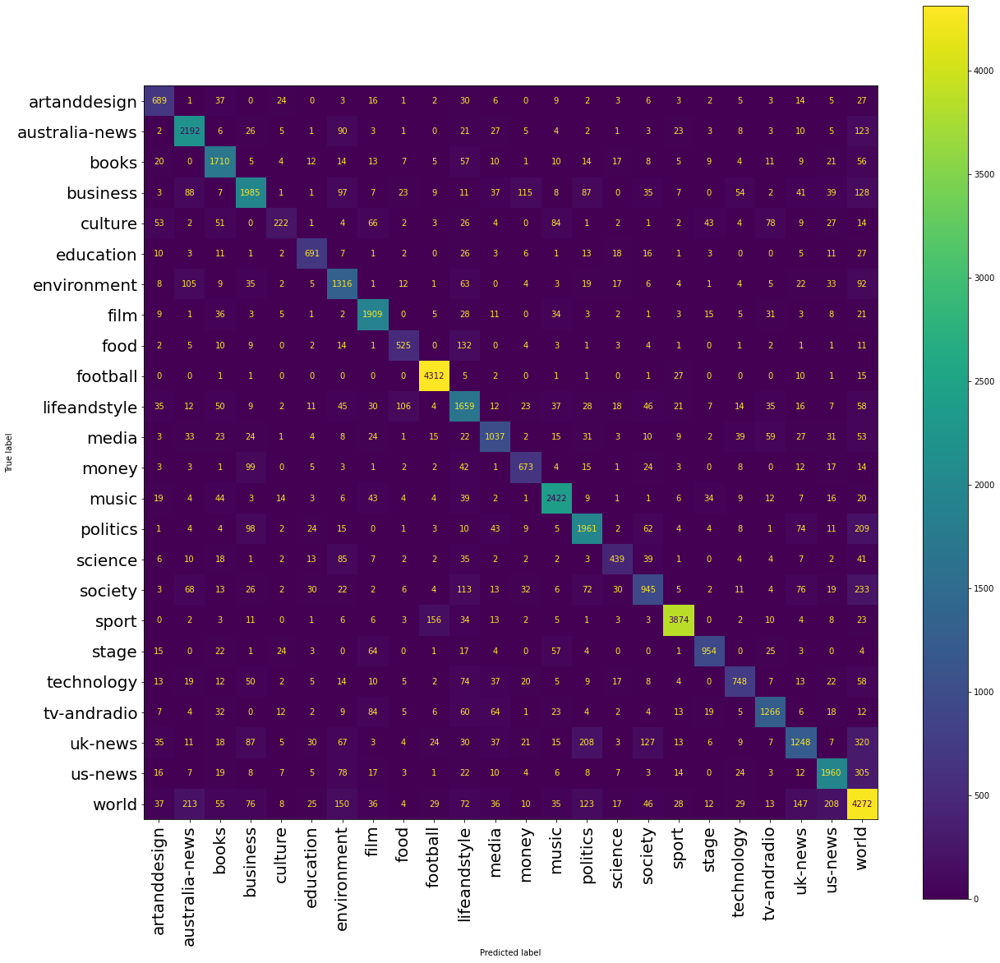

In [69]:
x_list = labels_nn
fig, ax = plt.subplots(figsize=(20,20))
ax.xaxis.set_ticklabels(x_list, rotation=45, fontsize=20);
ax.yaxis.set_ticklabels(x_list, fontsize=20);
cmp.plot(ax=ax, xticks_rotation='vertical')
plt.savefig("glove_nn_cf.png")